In [1]:
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
import networkx as nx
import pandas as pd
import numpy as np
import scipy as sp
import datetime as dt
import community
from shapely.geometry import Polygon

import statsmodels.tsa.api as tsa

import random
import math

import cmocean as cmo



%matplotlib inline

# To do
## Calibration
<li> Visually inspect Beveridge curve to find business cycle </li>
<li> Find the period of the business cycle T </li>

<li> Implement the shock on the calibrated model </li>

# Data Section

## Data acquired:
Occupation transition data between 2016 and 2017  
Employment levels for each occupation for some years  
Swedish beveridge curve from 2004 (aggregate, seasonally and calender adjusted)  
Osborne frey data (matched)

# General
Divide into several notebooks for the github page



In [2]:
# This is where the occupation transition data (as well as occupation code keys) is imported

data = pd.read_csv('/Users/lh/MSc_Thesis/Data_Labour/swedish_occupation_transitions.csv', sep = ';', index_col = 0)
data.index.name = None
data = data.drop(axis = 1, labels = 'Totalsumma')
data = data.drop(axis = 1, index = 'Totalsumma')
last = data.index[-1]
data = data.rename(index={last: 'NULL'})

# Drop Null and '***' columns
data = data.iloc[0:148, 0:148]
# ['31', '21', '11']

data.drop(labels = ['31', '21', '11'], axis = 0, inplace = True)
data.drop(labels = ['31', '21', '11'], axis = 1, inplace = True)

In [3]:
# This section calculates the adjacency matrix A from the raw data

A = pd.DataFrame(np.zeros(data.shape), columns = data.columns, index = data.index)

for i in range(data.shape[0]):
    total = 0
    for t in range(data.shape[1]):
        if math.isnan(data.iloc[i,t]) != True:
            total += data.iloc[i,t]
        else:
            data.iloc[i, t] = 0

    for j in range(data.shape[1]):
        T = data.iloc[i,j]
        A.iloc[i,j] = (T/total)

A.index = A.index.map(str)
A.columns = A.columns.map(str)

row_nonzeros = np.count_nonzero(A, axis=0)
col_nonzeros = np.count_nonzero(A, axis=1)

for i in range(len(row_nonzeros)):
    if row_nonzeros[i] == col_nonzeros[i] & row_nonzeros[i] == 1:
        print(A.columns[i])

# SSYK 323 and 622 only has selfloops and are not connected to the main component of the graph -> should be removed

data.drop(labels = ['323', '622'], axis = 0, inplace = True)
data.drop(labels = ['323', '622'], axis = 1, inplace = True)

A.drop(labels = ['323', '622'], axis = 0, inplace = True)
A.drop(labels = ['323', '622'], axis = 1, inplace = True)

323
622


In [66]:
# This is where the automation shock data from Frey and Osborne is imported and processed between occupation classification systems

frey_osborne = pd.read_csv('/Users/lh/MSc_Thesis/Data_Labour/osborne_frey_data.csv', sep = ';', index_col = 0)

SOC_shock = frey_osborne[['Probability', 'SOC code']]
SOC_shock.columns = ['Computerisation Probability', 'soc10']

for i in range(len(SOC_shock['soc10'])):
    SOC_shock.iloc[i,1] = SOC_shock.iloc[i,1][0:2] + SOC_shock.iloc[i,1][3:7]
    #SOC_shock.iloc[i,1] = SOC_shock.iloc[i,1]


SOC_ISCO = pd.read_csv('/Users/lh/MSc_Thesis/Data_Labour/soc10_isco08.csv', sep = ',')
for i in range(len(SOC_ISCO['isco08'])):
    SOC_ISCO.iloc[i,1] = str(SOC_ISCO.iloc[i,1])
    SOC_ISCO.iloc[i,0] = str(SOC_ISCO.iloc[i,0])
    # if len(SOC_ISCO.iloc[i,1]) == 3:
    #     SOC_ISCO.iloc[i,1] = '0' + SOC_ISCO.iloc[i,1]

ISCO_SSYK = pd.read_csv('/Users/lh/MSc_Thesis/Data_Labour/nyckel_ssyk2012_isco-08.csv', sep = ';')
ISCO_SSYK = ISCO_SSYK[['SSYK 2012 kod','ISCO-08 ']]
ISCO_SSYK.columns = ['ssyk12', 'isco08']

for i in range(len(ISCO_SSYK['isco08'])):
    ISCO_SSYK.iloc[i,1] = str(ISCO_SSYK.iloc[i,1])
    ISCO_SSYK.iloc[i,0] = str(ISCO_SSYK.iloc[i,0])


# The file above contains many duplicates
ISCO_SSYK.drop_duplicates(inplace=True)

# Below transfers SOC_shock to SSYK_shock
ISCO_shock = pd.merge(SOC_shock, SOC_ISCO, on = 'soc10')

SSYK_shock = pd.merge(ISCO_shock, ISCO_SSYK, on = 'isco08')


# The codes are 4 level need to be 3 level. Only need to change final table (SSYK_shock)
SSYK_shock['ssyk3'] =  [code[0:3] for code in SSYK_shock['ssyk12']]

SSYK3_shock = SSYK_shock[['Computerisation Probability', 'ssyk3']]


SSYK3_shock = SSYK3_shock.groupby(['ssyk3'], as_index=False).mean()


SSYK3 = list(SSYK3_shock['ssyk3'])


G = nx.from_pandas_adjacency(A, create_using = nx.DiGraph)
SSYK3_fromnw = list(G.nodes)
SSYK3_fromnw = [str(node) for node in SSYK3_fromnw]

SSYK3_shock.to_csv('../Data_Labour/Occupation_shock.csv', sep = ',')

# PRoblem is that certain SOC codes in osborne frey have been abbreviated with 0s. Which makes the matching miss a few rows
# This problem can be fixed

# SOC codes that are not found in the SOC-ISCO translation file
# print(set(SOC_shock['soc10'])-set(SOC_ISCO['soc10']))
# {'292037', '292055', '499799', '291060', '394831', '319799', '292799', '251000', '253999', '151179', '474799', '131078', '452090', '299799', '151150', '151799', '519399', '291111'}

# Focus on '251000', '151150', '291060'
# 291060 solves 221 because 291060 doesnt exist in soc_isco
# 291141, 291151, 291171, 291161 <- 222
# 29-1111 is not used anymore, 29-1141 should be used instead: https://www.onetonline.org/find/quick?s=29-1111

# 231 ssyk: soc_isco översätter till isco 2310 som inte existerar i isco_ssyk nykeln där det istället är 231X. Bör alltså gå att lösa
# 251000: Post-secondary teachers is translated as 2310 SSYK

# SSYK codes not found in ISCO-SSYK translation file
# print(list(set(SSYK3_fromnw) - set(SSYK3)))
# ['221', '21', '11', '222', '231', '31']
# ['21', '11', '31'] are military occupations and we do not have computersiation probabilities for these

# focus on ['221', '222', '231']


FileNotFoundError: [Errno 2] No such file or directory: '../Data_Labour/Occupation_shock.csv'

In [5]:
gdp_gap = pd.read_csv('/Users/lh/MSc_Thesis/Data_Labour/bnp-gap.csv', sep = ';')
gdp_gap['Qtr'] = pd.to_datetime(gdp_gap.date).dt.quarter
gdp_gap['date'] = [gdp_gap['date'].iloc[i][0:4] + 'Q' + str(gdp_gap['Qtr'].iloc[i]) for i in range(len(gdp_gap['date']))]
gdp_gap['recession'] = [1 if gap <= 0 else 0 for gap in list(gdp_gap['BNP-gap'])]
gdp_gap.rename(columns = {'BNP-gap': 'gdp_gap'}, inplace = True)

In [6]:
# Data for calibrating and setting up the model
employment_SSYK = pd.read_csv('/Users/lh/MSc_Thesis/Data_Labour/employment_SSYK.csv', sep = ',')
employment_SSYK.rename(columns = {'Yrke (SSYK 2012)':'SSYK'}, inplace = True)
# SSYK code and years as columns

# New calibration data - seasonally adjusted
employment_sa = pd.read_csv('/Users/lh/MSc_Thesis/Data_Labour/employment_quarterly.csv', sep = ';')
employment_sa['date'] = [str(2000 + employment_sa['year'].iloc[i])+'Q'+str(employment_sa['quarter'].iloc[i]) for i in range(len(employment_sa))]
employment_sa = employment_sa[['date', 'e_sa', 'e_trend']]
employment_sa['e_sa'] = [int(float(string.replace(',','.'))*1000) for string in employment_sa['e_sa']]
employment_sa['e_trend'] = [int(float(string.replace(',','.'))*1000) for string in employment_sa['e_trend']]


unemployment_all = pd.read_csv('/Users/lh/MSc_Thesis/Data_Labour/unemployment_quarterly.csv', sep = ';')
unemployment_all['date'] = [str(2000 + unemployment_all['year'].iloc[i])+'Q'+str(unemployment_all['quarter'].iloc[i]) for i in range(len(unemployment_all))]
unemployment_sa = unemployment_all[['date', 'u_sa', 'u_trend']]

unemployment_sa['u_sa'] = [float(string.replace(',','.')) for string in unemployment_sa['u_sa']]
unemployment_sa['u_trend'] = [float(string.replace(',','.')) for string in unemployment_sa['u_trend']]

vac_rate_all = pd.read_csv('/Users/lh/MSc_Thesis/Data_Labour/Vacancy Data/sa_2004-2019.csv', sep = ';')

sa_calibration_data = pd.merge(unemployment_sa, vac_rate_all[['date', 'sa_vac', 'na_vac']], on ='date')
sa_calibration_data = pd.merge(sa_calibration_data, employment_sa, on = 'date')
sa_calibration_data = pd.merge(sa_calibration_data, gdp_gap[['date', 'recession']], on = 'date')

sa_calibration_data['sa_vac_rate'] = sa_calibration_data['sa_vac']*100/(sa_calibration_data['e_trend']+sa_calibration_data['sa_vac'])


/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


# Data visualisation section
The following cells include code used to visualise the raw data, this includes:  
Network Visualisation  
Beveridge Curve

## Visualisation to do
Visualise the network using occupation classification (almost done - legend needs to be fixed)
Draw the beveridge curve for all years

In [7]:
# This sets up the visualization of the network
## The size of the nodes is proportional to the amount of workers who stayed in their proffesion between 2016 and 2017

def softmax(A,k=1.0):
    """
    Calculates the softmax of a distribution, modulated by the precision term, k
    Used here to adjust the size of the nodes
    """
    A = np.array(A) if not isinstance(A, np.ndarray) else A
    A = A*k
    maxA = A.max()
    A = A-maxA
    A = np.exp(A)
    return A/np.sum(A)

# Create the graph G from the adjeceny matrix
G = nx.from_pandas_adjacency(A, create_using = nx.DiGraph)

# List of all the occupation codes
occupations = list(G.nodes)

# Dictionaries holding the first and second levels of the SSYK code respectively
first_level = {name:name[0] for name in occupations}
second_level = {name:name[0:1] for name in occupations}

# The amount of workers who stayed in their proffession
remain_workers = np.diag(data)

# Make it into a dict 
remain_dict = dict(zip(list(G.nodes), remain_workers))

# Calculate the size of each node
ns = softmax(0.7*np.log2(10000+np.array(list(remain_dict.values()))))*15000

# Give the network the attributes used for visualisation
nx.set_node_attributes(G, first_level, 'SSYK1')
nx.set_node_attributes(G, second_level, 'SSYK2')
nx.set_node_attributes(G, remain_dict, 'remained_workers')

# Ten colors used for visualisation
cols = ["#69b243", "#ad5ec7", "#bfaf48", "#7778c8", "#c87f41", "#4bafd0", "#ce4a3d", "#55a977", "#cd4b8f", "#70742e", "#c36a7c"]

# Get all the unique first level codes
vals = list(set(val for val in first_level.values()))

# Make a dict that stores the color each node should get based on their first level
col_dict = {}
for i in range(len(vals)):
    col_dict[vals[i]] = cols[i]

# Make a list that contains the color of every node
node_col_list = [col_dict[val] for val in first_level.values()]
edge_col_list = [col_dict[val[0]] for val,_ in G.edges()]

# Make a list that contains the weight for each link
edges = G.edges()
weights = [G[u][v]['weight'] for u,v in edges]
weights = softmax(0.7*np.log2(1000+np.array(weights)))*1500



/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:585: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  and cb.iterable(edge_color) \
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:676: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if cb.iterable(node_size):  # many node sizes


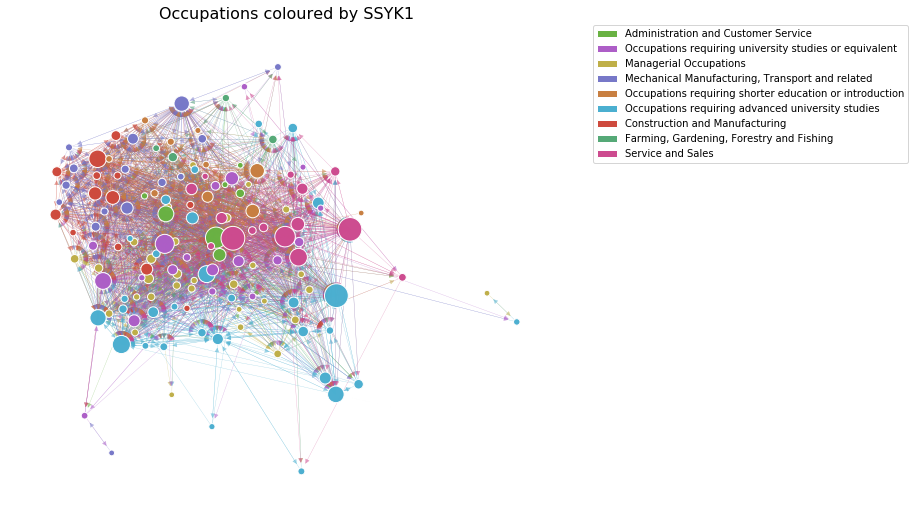

In [8]:
# This section visualises the network where nodes are colored by their first level code and the size correspond to the number of workers 
# who stayed in their proffession


fig, ax = plt.subplots(1,1,figsize=(10,9))

legend_elements = []

occ_dict = {'1': 'Chefsyrken', '2': 'Yrken med krav på fördjupad högskolekompetens', '3':'Yrken med krav på högskolekompetens eller motsvarande', '4': 'Yrken inom administration och kundtjänst', '5':'Service-, omsorgs- och försäljningsyrken', '6': 'Yrken inom lantbruk, trädgård, skogsbruk och fiske', '7':'Yrken inom byggverksamhet och tillverkning', '8': 'Yrken inom maskinell tillverkning och transport m.m.', '9':'Yrken med krav på kortare utbildning eller introduktion'}


en_occ_dict = {'1': 'Managerial Occupations', '2': 'Occupations requiring advanced university studies', '3':'Occupations requiring university studies or equivalent', '4': 'Administration and Customer Service', '5':'Service and Sales', '6': 'Farming, Gardening, Forestry and Fishing', '7':'Construction and Manufacturing', '8': 'Mechanical Manufacturing, Transport and related', '9':'Occupations requiring shorter education or introduction'}

for level, col in col_dict.items():
    legend_elements.append(Patch(facecolor = col, edgecolor='w', label=en_occ_dict[level]))

pos = nx.spring_layout(G)

nx.draw_networkx_nodes(G, pos, with_labels = True, node_color=node_col_list, node_size = ns, alpha=0.99, edgecolors='w', ax = ax)

nx.draw_networkx_edges(G, pos, edge_color=edge_col_list, width=weights, alpha=0.5, ax=ax)

ax.set_axis_off()

ax.set_title("Occupations coloured by SSYK1", fontsize=16)


# Create the figure

plt.legend(handles=legend_elements, bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

#plt.savefig('e_coli.png', dpi=425, bbox_inches='tight')
plt.show()

# Two occupations only have a self-loop

In [9]:
of_data = SSYK_shock.groupby(by = ['ssyk3'], axis = 0).mean()
of_data = of_data.to_dict()['Computerisation Probability']

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:585: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  and cb.iterable(edge_color) \
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:595: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  for c in edge_color]):
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:676: MatplotlibDeprecationWarning: 
The iterable funct

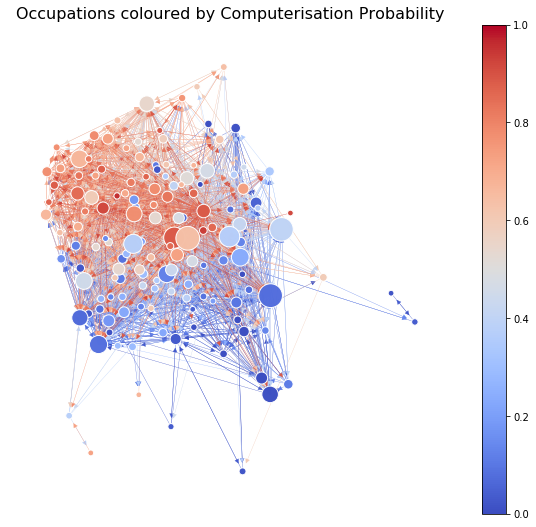

In [64]:
# Visualisation of Frey and Osborne data
# This section visualises the network where nodes are colored by their first level code and the size correspond to the number of workers 
# who stayed in their proffession
fig, ax = plt.subplots(1,1,figsize=(10,9))

node_colors = [plt.cm.coolwarm(of_data[occ]) for occ in G.nodes]
edge_colors = [plt.cm.coolwarm(of_data[occ]) for occ,_ in G.edges]

sm = plt.cm.ScalarMappable(cmap=plt.cm.coolwarm, norm=plt.Normalize(0,1))
sm._A = []
plt.colorbar(sm)

nx.draw_networkx_nodes(G, pos, with_labels = True, node_color=node_colors, node_size = ns, alpha=0.99, edgecolors='w', ax = ax)

nx.draw_networkx_edges(G, pos, edge_color= edge_colors, width=weights, alpha=0.5, ax=ax)

ax.set_axis_off()

ax.set_title("Occupations coloured by Computerisation Probability", fontsize=16)

#plt.savefig('e_coli.png', dpi=425, bbox_inches='tight')
plt.show()

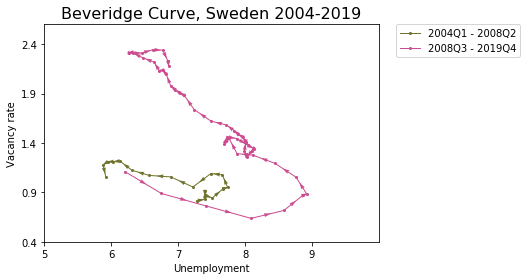

In [14]:
plot_ls = []
plot_dict = {'start': '', 'end': '', 'u': [], 'vac': []}

prev_status = sa_calibration_data['recession'].iloc[0]
plot_dict['start'] = sa_calibration_data['date'].iloc[0]
status_change = 0
for i in range(len(sa_calibration_data)):
    status = sa_calibration_data['recession'].iloc[i]
    if status == prev_status:
        plot_dict['u'].append(sa_calibration_data['u_trend'].iloc[i])
        plot_dict['vac'].append(sa_calibration_data['sa_vac_rate'].iloc[i])
    else:
        status_change += 1
        if status_change == 3:
            plot_dict['end'] = sa_calibration_data['date'].iloc[i-1]
            plot_ls.append(plot_dict)
            plot_dict = {'start': sa_calibration_data['date'].iloc[i], 'end': '', 'u': [sa_calibration_data['u_trend'].iloc[i]], 'vac': [sa_calibration_data['sa_vac_rate'].iloc[i]]}
            status_change = 0
        else:
            plot_dict['u'].append(sa_calibration_data['u_trend'].iloc[i])
            plot_dict['vac'].append(sa_calibration_data['sa_vac_rate'].iloc[i])
    prev_status = status

plot_dict['end'] = sa_calibration_data['date'].iloc[-1]
plot_ls.append(plot_dict)


x = sa_calibration_data['u_trend'].values
y = sa_calibration_data['sa_vac_rate'].values



fig, ax = plt.subplots()
cols = ["#69b243", "#ad5ec7", "#bfaf48", "#7778c8", "#c87f41", "#4bafd0", "#ce4a3d", "#55a977", "#cd4b8f", "#70742e"]

legend_elements = []

for data in plot_ls:
    col = cols.pop()
    plt.plot(data['u'], data['vac'], color = col, ls = '-', marker = 'o', linewidth = 1, markersize = 2, label = data['start']+' - '+data['end'])
    x = data['u']
    y = data['vac']
    u = np.diff(x)
    v = np.diff(y)
    pos_x = x[:-1] + u/2
    pos_y = y[:-1] + v/2
    norm = np.sqrt(u**2+v**2) 
    ax.quiver(pos_x, pos_y, u/norm, v/norm, angles="xy", zorder=5, pivot="mid", scale = 50, color = col)
    #legend_elements.append(Patch(facecolor = col, edgecolor='w', label=data['start']+' - '+data['end']))
    # plt.annotate(data['start'], # this is the text
    #              (data['u'][0],data['vac'][0]), # this is the point to label
    #              textcoords="offset points", # how to position the text
    #              xytext=(0,-10), # distance from text to points (x,y)
    #              ha='center')
    # plt.annotate(data['end'], # this is the text
    #              (data['u'][-1],data['vac'][-1]), # this is the point to label
    #              textcoords="offset points", # how to position the text
    #              xytext=(0,15), # distance from text to points (x,y)
    #              ha='center')



# ax.axis('equal')
ax_bounds = [5, 10, 0.4, 2.6]
ax.axis(ax_bounds)
ax.xaxis.set_ticks(np.arange(ax_bounds[0], ax_bounds[1], 1))
ax.yaxis.set_ticks(np.arange(ax_bounds[2], ax_bounds[3], 0.5))
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
ax.set_title("Beveridge Curve, Sweden 2004-2019", fontsize=16)
ax.set_xlabel('Unemployment')
ax.set_ylabel('Vacancy rate')
plt.show()

# Model Section
The follwowing cells include all the funcitons used in the simulation  
Most code is commented and all functions have a custom description

## Model to do
Fix inevitable bugs since the code has not been run with actual data  
Comment all code

In [55]:
# setup network
def set_attributes(G, data):
    '''
    Initialises the node attributes of the occupational mobility network.
    Parameters:
    -----------
    G (nx.graph): The occupational mobility network
    data (?): Data used to specify attribute values
    
    setting up data will have the following form:
    data (pd.DataFrame): Columns contain values for the attributes and rows are occupations

    The attributes are:
    employed (int): Number of employees in the occupation
    unemplyed (int): Number of unemployed in the occupation
    vacancies (int): Number of vacancies in the occupation
    applications (list): List where the elements are the name of the occupation where the application is coming from
    target_demand (int): The target demand of the occupation (exogenous and used for automation shock)
    risk_factor (float): A value between 0 and 1 indicating the risk of a proffession (could be automation or corona or whatever)

    Note that the current demand is implicit (=employed + vacancies)
    '''
    # Make dictionaries
    attributes = data.to_dict()

    # Add some variables
    # attributes['target_demand']
    
    # Set attrbutes
    for key, value in attributes.items():

        nx.set_node_attributes(G, value, str(key))

def make_vacancies(G, delta_nu, gamma_ny):
    '''
    Each occupation has a probability of making vacancies each time step that depends on the difference between
    current demand and target demand as well as an exogenous probability 

    Parameters:
    -----------
    G (nx.graph): The occupational mobility network
    other parameters
    '''
    # The attributes we need to calculate new vacancies
    vac_dict = nx.get_node_attributes(G, 'vacancies')
    emp_dict = nx.get_node_attributes(G, 'employed')
    td_dict = nx.get_node_attributes(G, 'target_demand')

    # loop through all the occupations and create vacancies as described in the paper
    for occupation in vac_dict.keys():
        # The occupation specificattribute values
        target_demand = td_dict[occupation]
        employed = emp_dict[occupation]
        current_demand = vac_dict[occupation] + employed
        

        # Calculate the probability of creating new vacancies (equation 10)
        demand_diff = max(0, target_demand - current_demand)

        # Zero Steady State rule
        if employed == vac_dict[occupation] == 0 and target_demand > 0:
            vacancies += 1
        else:
            if demand_diff == 0 or employed == 0:
                alpha_ny = 0
            else:
                alpha_ny = gamma_ny*demand_diff/employed

            p_ny = delta_nu + alpha_ny - delta_nu*alpha_ny

            # Expected number of new vacancies - wrong
            # new_vacancies = round(p_ny*employed
            new_vacancies = np.random.binomial(employed, p_ny)
            # Add the new vacancies to total number of vacancies
            vac_dict[occupation] += new_vacancies

    nx.set_node_attributes(G, vac_dict, 'vacancies')


def separate_workers(G, delta_u, gamma_u):
    '''
    Each occupation has a probability of seperating workers each time step that depends on the difference between
    current demand and target demand as well as an exogenous probability 

    Parameters:
    -----------
    G (nx.graph): The occupational mobility network
    other parameters
    '''

    # The attributes we need to calculate number of seperated workers
    unemp_dict = nx.get_node_attributes(G, 'unemployed')
    emp_dict = nx.get_node_attributes(G, 'employed')
    td_dict = nx.get_node_attributes(G, 'target_demand')
    vac_dict = nx.get_node_attributes(G, 'vacancies')

    # loop through all the occupations and seperate workers as described in the paper
    for occupation in unemp_dict.keys():
        # The occupation specificattribute values
        target_demand = td_dict[occupation]
        employed = emp_dict[occupation]
        vacancies = vac_dict[occupation]

        current_demand = vacancies + employed

        # Calculate the probability of creating new vacancies (equation 9)
        demand_diff = max(0, current_demand - target_demand)
        if demand_diff == 0 or employed == 0:
            alpha_u = 0
        else:
            alpha_u = gamma_u*demand_diff/employed
        # probability calculation (equation 11)
        p_u =  delta_u + alpha_u - delta_u*alpha_u
        

        # This is the expected number of seperated workers - WRONG!!!
        # separated = round(p_u*unemployed)
        separated = np.random.binomial(employed, p_u)

        unemp_dict[occupation] += separated
        emp_dict[occupation] -= separated
    nx.set_node_attributes(G, unemp_dict, 'unemployed')
    nx.set_node_attributes(G, emp_dict, 'employed')

def make_applications(G):
    '''
    Each unemployed worker send out an application to a neighbouring occupation proportional to the edge weight
    between the occupations

    Parameters:
    -----------
    G (nx.graph): The occupational mobility network
    '''
    # loop through every occupation and every unemployed person in the occupation and add applications in the 
    # applications attribute of the occupation that the worker applies to
    app_dict = nx.get_node_attributes(G, 'applications')
    unem_dict = nx.get_node_attributes(G, 'unemployed')
    vac_dict = nx.get_node_attributes(G, 'vacancies')

    A_dict = nx.get_edge_attributes(G, 'weight')

    for occupation in app_dict:
        unemployed = unem_dict[occupation]
        neighbors = [n for n in G.neighbors(occupation)]

        # Calculate probabilities (equation 7)
        vac_A_list = [vac_dict[n]* A_dict[(occupation, n)] for n in neighbors]
        vac_A_sum = sum(vac_A_list)
        if vac_A_sum == 0:
            continue
        p_list = [vac_A/vac_A_sum for vac_A in vac_A_list]

        # Each unemployed person chooses an occupation to apply to
        for _ in range(unemployed):
            # Choice is weighted by probabilities calculated above
            apply_to = np.random.choice(neighbors, p = p_list)
            # Make the application
            app_dict[apply_to].append(occupation)
    nx.set_node_attributes(G, app_dict, 'applications')


def handle_applications(G):
    '''
    Randomly accept N applications in the application attrbute where N is the number of vacancies in the occupation

    Parameters:
    -----------
    G (nx.graph): The occupational mobility network
    '''
    # The attributes we need
    app_dict = nx.get_node_attributes(G, 'applications')
    vac_dict = nx.get_node_attributes(G, 'vacancies')
    emp_dict = nx.get_node_attributes(G, 'employed')
    unemp_dict = nx.get_node_attributes(G, 'unemployed')

    # loop through all the occupations and try to accept the same number of applications as there are vacancies
    for occupation in app_dict:
        applications = app_dict[occupation]
        vacancies = vac_dict[occupation]

        filled_vacancies = 0
        for j in range(vacancies):
            if len(applications) == 0:
                # if vacancies > len(applications) not all vacancies are filled
                break
            # A random application is chosen (and removed from the list of applications)
            accepted = applications.pop(random.randrange(len(applications)))

            # Increase the amount of employed people in the occupation by the number of filled vacancies
            emp_dict[occupation] += 1

            # Decrease the amount of unemployed people in the occupations where applications were accepted from
            unemp_dict[accepted] -= 1
            # Number of filled vacancies
            filled_vacancies = j + 1
    
        # Decrease the amount of vacancies in the occupation
        vac_dict[occupation] = vacancies - filled_vacancies
        # Update the applications list
        app_dict[occupation] = applications
    
    # Update the network node attributes
    nx.set_node_attributes(G, app_dict, 'applications')
    nx.set_node_attributes(G, vac_dict, 'vacancies')
    nx.set_node_attributes(G, emp_dict, 'employed')
    nx.set_node_attributes(G, unemp_dict, 'unemployed')

def update_target_demand(G, demand_0, t, T, a):
    '''
    function that updates the target demand. Used for calibrating the the model paramters

    Parameters:
    -----------
    G (nx.Graph): The occupational mobility network
    demand_0 (int): Initial demand
    t (int): Timestep of simulation
    T (float): The duration of a business cycle
    a (float): the amplitude of the business cycle sin wave
    '''

    target_demand = {}
    for node in G.nodes():
        target_demand[node] = round(demand_0[node]*(1 + a*np.sin(t/(2*np.pi*T))))

    nx.set_node_attributes(G, target_demand, 'target_demand')


def shock(G, demand_0, final_demand, t, t_0, k):
    '''
    function that implements the labour demand shock

    Parameters:
    -----------
    G (nx.Graph): The occupational mobility network
    demand_0 (int): Initial demand
    t (int): Timestep of simulation
    t_0 (int): Midpoint of shock (where sigmoid goes from exponential increase to exponential decrease)
    k (float): 

    '''

    demand_shock = {}
    target_demand = {}

    for key in employed.keys():
        demand_shock[key] = (final_demand[key] - demand_0[key])/(1 + np.exp(k*(t-t_0)))
        target_demand[key] = demand_0[key] + demand_shock[key]

    nx.set_node_attributes(G, target_demand, 'target demand')


def calibration_calculation(empirical_data, model_data, A_e, fast = True):
    '''
    This is the function to be minimised during calibration.abs

    Parameters:
    empirical_data (dict): timeseries of vacancies and unemployment
    model_data (dict): timeseries of vacancies and unemployment
    '''


    m_vacancies = [sum(model_data['vacancies'][i].values()) for i in range(len(model_data['vacancies']))]
    m_employed = [sum(model_data['employment'][i].values()) for i in range(len(model_data['employment']))]

    m_vac_rate = [m_vacancies[i]*100/(m_vacancies[i] + m_employed[i]) for i in range(len(m_employed))]

    m_unemployed = [sum(model_data['unemployment'][i].values()) for i in range(len(model_data['unemployment']))]
    m_unemployed = [u*100/(m_employed[i]+ u) for i, u in enumerate(m_unemployed)]

    m_seq = [(u, m_vac_rate[i]) for i, u in enumerate(m_unemployed)]
   

    fig, ax = plt.subplots()
    plt.plot(m_unemployed, m_vac_rate, ls = '-', marker = 'o', linewidth = 1, markersize = 2)
    plt.show()
    if fast == False:
        fig, ax = plt.subplots()
        plt.plot(e_unemployed, e_vac_rate, ls = '-', marker = 'o', linewidth = 1, markersize = 2)
        plt.show()

    if Polygon(m_seq).is_valid == True:
        A_m = Polygon(m_seq)
    else:
        print('A_m is not valid')
        return {'cost':'N/A', 'intersection':'N/A', 'union':'N/A'}
    try:
        union_area = A_m.union(A_e).area
    except:
        print('union is not found')
        union_area = 'N/A'
        cost = 'N/A'
    try:
        intersection_area = A_m.intersection(A_e).area
    except:
        print('intersection is not found')
        intersection_area = 'N/A'
        cost = 'N/A'
    try:
        if A_m.union(A_e).is_valid == True and A_m.intersection(A_e).is_valid == True:
            cost = intersection_area/union_area
            print('Union area: ', union_area, 'Intersection_area: ', intersection_area)
    except:
        cost = 'N/A'
        print('Cost not calculated')

    return {'cost':cost, 'intersection':intersection_area, 'union':union_area}


def simulation(G, years, timestep, delta_u, gamma_u, delta_nu, gamma_ny, empirical_data, t_0, k, L, avg_hours_0, a, T, shock_start, attributes, calibration_output = False):
    '''
    Set attribute data of occupational mobility netowrk and carry out the simulation for a specified number of timesteps

    Parameters:
    -----------
    G (nx.Graph): The occupational mobility network
    data (pd.DataFrame): DataFrame containing data
    years (int): Number of years for the simulation
    timestep (float): size of each timestep in terms of weeks
    delta_u (float): probability of spontanous seperation
    delta_nu (float): probability of spontanously opneing vacancy
    gamma_u (float): speed of unemployed adjustment towards target demand
    gamma_ny (float): speed of vacancy adjustment towards target demand
    '''

    #set_attributes(G, data)
    # This needs to be put into the network (used as starting point)

    for key, value in attributes.items():
        nx.set_node_attributes(G, value, str(key))

    timesteps = round(years*52/timestep)
    T_steps = round(T*52/timestep)

    vacancies = nx.get_node_attributes(G, 'vacancies')
    employed = nx.get_node_attributes(G, 'employed')

    demand_0 = {}

    for key in vacancies.keys():
        demand_0[key] = vacancies[key] + employed[key] 

    vac_data = []
    emp_data = []
    unemp_data = []

    # Variables to calculate the post shock demand
    risk_factor = nx.get_node_attributes(G, 'comp_prob')
    average_hours_worked_0 = avg_hours_0
    

    final_hours_worked = {}

    for occupation in risk_factor.keys():
        final_hours_worked[occupation] = average_hours_worked_0*employed[occupation]*(1-risk_factor[occupation])

    final_average_hours_worked = sum(final_hours_worked.values())/L

    # Post shock demand
    final_demand = {occupation:hours/final_average_hours_worked for occupation, hours in final_hours_worked.items()}

    for t in range(timesteps):
        handle_applications(G)
        make_applications(G)
        make_vacancies(G, delta_nu, gamma_ny)
        separate_workers(G, delta_u, gamma_u)

        # order should be checked and changed
        # if t > shock_start:
        #    shock(G, demand_0, final_demand, t, t_0, k)

        vac_data.append(nx.get_node_attributes(G, 'vacancies'))
        unemp_data.append(nx.get_node_attributes(G, 'unemployed'))
        emp_data.append(nx.get_node_attributes(G, 'employed'))

        update_target_demand(G, demand_0, t, T_steps, a)
    

    model_data = {'vacancies': vac_data, 'unemployment': unemp_data, 'employment':emp_data}
    print('a: ', a, 'delta_u', delta_u, 'delta_nu', delta_nu)
    cost = calibration_calculation(empirical_data, model_data)

    vac_data = pd.DataFrame(vac_data)
    unemp_data = pd.DataFrame(unemp_data)
    emp_data = pd.DataFrame(emp_data)

    if calibration_output == True:
        return cost
    else:
        return {'vacancy_data': vac_data, 'unemployment_data': unemp_data, 'employment_data': emp_data, 'cost': cost}

def deterministic_simulation(G, years, timestep, delta_u, gamma_u, delta_nu, gamma_ny, empirical_data, t_0, k, L, avg_hours_0, a, T, shock_start, attributes, calibration_output = False):
    #set_attributes(G, data)
    # This needs to be put into the network (used as starting point)

    for key, value in attributes.items():
        nx.set_node_attributes(G, value, str(key))

    timesteps = round(years*52/timestep)
    T_steps = round(T*52/timesteps)

    vacancies = nx.get_node_attributes(G, 'vacancies')
    employed = nx.get_node_attributes(G, 'employed')

    demand_0 = {}

    for key in vacancies.keys():
        demand_0[key] = vacancies[key] + employed[key] 

    vac_data = []
    emp_data = []
    unemp_data = []

    # Variables to calculate the post shock demand
    risk_factor = nx.get_node_attributes(G, 'comp_prob')
    average_hours_worked_0 = avg_hours_0
    

    final_hours_worked = {}

    for occupation in risk_factor.keys():
        final_hours_worked[occupation] = average_hours_worked_0*employed[occupation]*(1-risk_factor[occupation])

    final_average_hours_worked = sum(final_hours_worked.values())/L

    # Post shock demand
    final_demand = {occupation:hours/final_average_hours_worked for occupation, hours in final_hours_worked.items()}

    # Empirical data
    e_vac_rate = empirical_data['sa_vac_rate']
    e_unemployed = empirical_data['u_trend']
    e_seq = [(u, e_vac_rate.iloc[i]) for i, u in enumerate(e_unemployed)]
    A_e = Polygon(e_seq)

    occupations = list(G.nodes())
    time = dt.datetime.now()
    print('Simulation started at: ', time)
    for t in range(timesteps):
        ny = nx.get_node_attributes(G, 'vacancies')
        u = nx.get_node_attributes(G, 'unemployed')
        e = nx.get_node_attributes(G, 'employed')
        A = nx.get_edge_attributes(G, 'weight')

        s = {}
        f = {}
        for j in occupations:
            s[j] = []
            for i in G.predecessors(j):
                ny_A_sum = sum([ny[k]*A[(i,k)] for k in G.neighbors(i)])
                if ny_A_sum == 0:
                    s[j].append(0)
                else:
                    s[j].append(u[i]*ny[j]*A[(i,j)]/ny_A_sum)

            s[j] = sum(s[j])
            for i in G.predecessors(j):
                ny_A_sum = sum([ny[k]*A[(i,k)] for k in G.neighbors(i)])
                if s[j]*ny_A_sum == 0:
                    f[(i,j)] = 0
                else:
                    f[(i,j)] = u[i]*(ny[j]**(2))*A[(i,j)]*(1 - math.exp(-s[j]/ny[j]))/(s[j]*ny_A_sum)

        new_e = {}
        new_u = {}
        new_ny = {}
        
        target_demand = nx.get_node_attributes(G, 'target_demand')
        current_demand = {}

        for i in occupations:
            current_demand[i] = ny[i] + e[i]
            demand_diff = max(0, current_demand[i] - target_demand[i])

            f_i = sum([f[(j,i)] for j in G.predecessors(i)])

            new_e[i] = e[i] - delta_u*e[i] + (1 - delta_u)*gamma_u*demand_diff + f_i

            f_j = sum([f[(i,j)] for j in G.successors(i)])

            new_u[i] = u[i] + delta_u*e[i] + (1 - delta_u)*gamma_u*demand_diff - f_j

            demand_diff = max(0, target_demand[i]-current_demand[i])
            new_ny[i] = ny[i] + delta_nu*e[i] + (1-delta_nu)*demand_diff - f_i

        nx.set_node_attributes(G, new_ny, 'vacancies')
        nx.set_node_attributes(G, new_e, 'employed')
        nx.set_node_attributes(G, new_u, 'unemployed')

        vac_data.append(nx.get_node_attributes(G, 'vacancies'))
        unemp_data.append(nx.get_node_attributes(G, 'unemployed'))
        emp_data.append(nx.get_node_attributes(G, 'employed'))

        update_target_demand(G, demand_0, t, T_steps, a)
        # order should be checked and changed
        # if t > shock_start:
        #    shock(G, demand_0, final_demand, t, t_0, k)

    model_data = {'vacancies': vac_data, 'unemployment': unemp_data, 'employment':emp_data}
    print('a: ', a, 'delta_u', delta_u, 'delta_nu', delta_nu)

    cost = calibration_calculation(empirical_data, model_data, A_e)

    vac_data = pd.DataFrame(vac_data)
    unemp_data = pd.DataFrame(unemp_data)
    emp_data = pd.DataFrame(emp_data)
    print('Simulation took: ', dt.datetime.now()-time)
    if calibration_output == True:
        return cost
    else:
        return {'vacancy_data': vac_data, 'unemployment_data': unemp_data, 'employment_data': emp_data, 'cost': cost}





In [56]:
# This needs to be put into the network (used as starting point)
employment = employment_SSYK[['SSYK', '2014']]
employment = {str(employment['SSYK'].iloc[i]):employment['2014'].iloc[i] for i in range(len(employment))}
node_names = list(G.nodes())

# setup network
employed = {str(name):e for name,e in employment.items() if str(name) in node_names}
unemployed = {name:0 for name in node_names}
vacancies = {name:0 for name in node_names}
applications = {name:[] for name in node_names}
target_demand = {str(name):e for name,e in employment.items() if str(name) in node_names}
of_data = SSYK_shock.groupby(by = ['ssyk3'], axis = 0).mean()
of_data = of_data.to_dict()['Computerisation Probability']



attributes = {'employed':employed, 'unemployed':unemployed, 'vacancies':vacancies, 'applications':applications, 'target_demand':target_demand, 'comp_prob':of_data}

for key, value in attributes.items():
    nx.set_node_attributes(G, value, str(key))

# Add 12 missing required arguments... damn that's quite a bit
# These values are the ones we are trying to get sane
# Visual inspection of Beveridge curve gives following period
years = 10.25
T = years

# Parameters to be calibrated
timestep = 6.75
delta_u = 0.012
gamma_u = 0.05
delta_nu = 0.010
gamma_ny = gamma_u
a = 0.065

# Calibration data
start = 18
end = 59
empirical_data = sa_calibration_data.iloc[start:end]

# Shock parameters (not there yet)
t_0 = years
k = 1
L = 1
avg_hours_0 = 1
shock_start = 1

# output variable
calibration_output = True

# output = simulation(G, data, years, timestep, delta_u, gamma_u, delta_nu, gamma_ny, empirical_data, t_0, k, L, avg_hours_0, a, T, shock_start, calibration_output)

Simulation started at:  2020-04-27 20:10:54.246914
a:  0.005 delta_u 0.006 delta_nu 0.005


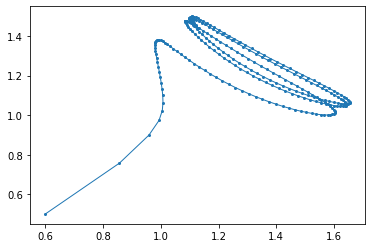

A_m is not valid
Simulation took:  0:01:17.838832
Simulation started at:  2020-04-27 20:12:12.104742
a:  0.035 delta_u 0.006 delta_nu 0.005


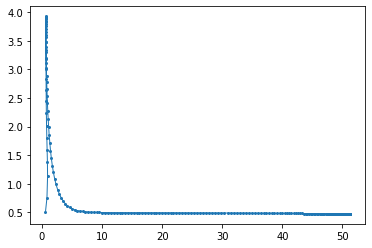

TopologyException: Input geom 1 is invalid: Self-intersection at or near point 8.0081289254463393 1.4016212223585043 at 8.0081289254463393 1.4016212223585043
TopologyException: Input geom 1 is invalid: Self-intersection at or near point 8.0081289254463393 1.4016212223585043 at 8.0081289254463393 1.4016212223585043
TopologyException: Input geom 1 is invalid: Self-intersection at or near point 8.0081289254463393 1.4016212223585043 at 8.0081289254463393 1.4016212223585043
union is not found
intersection is not found
Cost not calculated
Simulation took:  0:01:13.472067
Simulation started at:  2020-04-27 20:13:25.596004
a:  0.075 delta_u 0.006 delta_nu 0.005


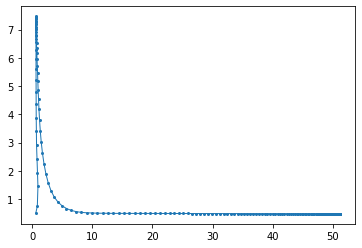

A_m is not valid
Simulation took:  0:01:16.931370
Simulation started at:  2020-04-27 20:14:42.560364
a:  0.1 delta_u 0.006 delta_nu 0.005


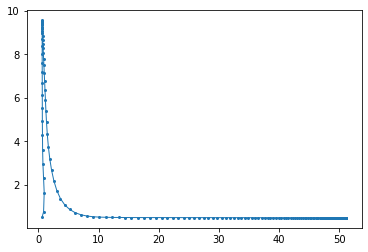

A_m is not valid
Simulation took:  0:01:14.968625
Simulation started at:  2020-04-27 20:15:57.549350
a:  0.005 delta_u 0.006 delta_nu 0.005


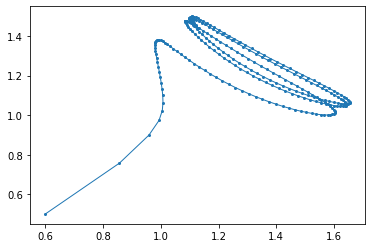

A_m is not valid
Simulation took:  0:01:15.082651
Simulation started at:  2020-04-27 20:17:12.653551
a:  0.035 delta_u 0.006 delta_nu 0.005


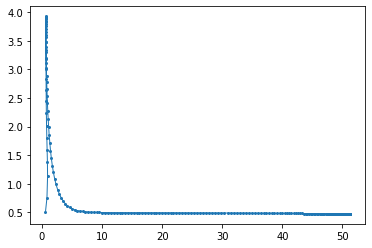

TopologyException: Input geom 1 is invalid: Self-intersection at or near point 8.0081289254463393 1.4016212223585043 at 8.0081289254463393 1.4016212223585043
TopologyException: Input geom 1 is invalid: Self-intersection at or near point 8.0081289254463393 1.4016212223585043 at 8.0081289254463393 1.4016212223585043
TopologyException: Input geom 1 is invalid: Self-intersection at or near point 8.0081289254463393 1.4016212223585043 at 8.0081289254463393 1.4016212223585043
union is not found
intersection is not found
Cost not calculated
Simulation took:  0:01:21.704330
Simulation started at:  2020-04-27 20:18:34.376889
a:  0.075 delta_u 0.006 delta_nu 0.005


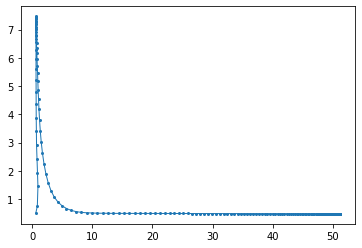

A_m is not valid
Simulation took:  0:01:17.750947
Simulation started at:  2020-04-27 20:19:52.162354
a:  0.1 delta_u 0.006 delta_nu 0.005


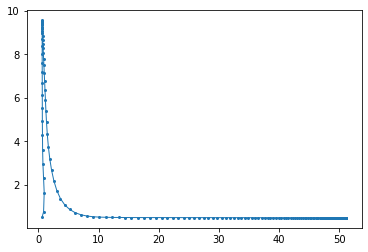

A_m is not valid
Simulation took:  0:01:13.762828
Simulation started at:  2020-04-27 20:21:05.956465
a:  0.005 delta_u 0.006 delta_nu 0.005


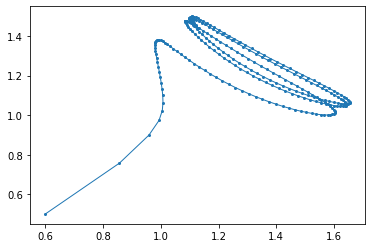

A_m is not valid
Simulation took:  0:01:13.541895
Simulation started at:  2020-04-27 20:22:19.516860
a:  0.035 delta_u 0.006 delta_nu 0.005


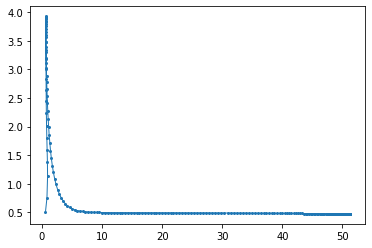

TopologyException: Input geom 1 is invalid: Self-intersection at or near point 8.0081289254463393 1.4016212223585043 at 8.0081289254463393 1.4016212223585043
TopologyException: Input geom 1 is invalid: Self-intersection at or near point 8.0081289254463393 1.4016212223585043 at 8.0081289254463393 1.4016212223585043
TopologyException: Input geom 1 is invalid: Self-intersection at or near point 8.0081289254463393 1.4016212223585043 at 8.0081289254463393 1.4016212223585043
union is not found
intersection is not found
Cost not calculated
Simulation took:  0:01:03.375012
Simulation started at:  2020-04-27 20:23:22.909634
a:  0.075 delta_u 0.006 delta_nu 0.005


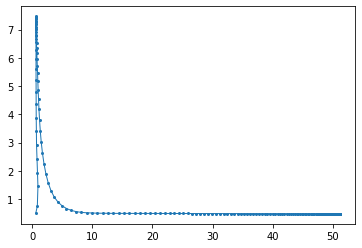

A_m is not valid
Simulation took:  0:01:03.460884
Simulation started at:  2020-04-27 20:24:26.403495
a:  0.1 delta_u 0.006 delta_nu 0.005


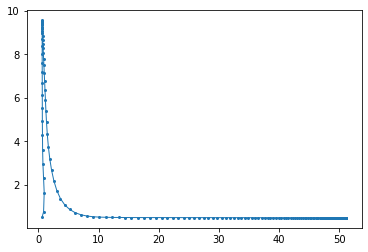

A_m is not valid
Simulation took:  0:01:02.871041
Simulation started at:  2020-04-27 20:25:29.305408
a:  0.005 delta_u 0.006 delta_nu 0.005


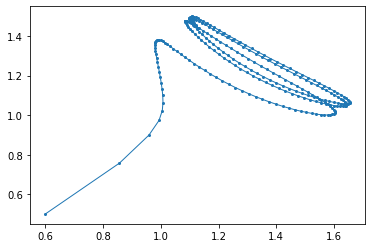

A_m is not valid
Simulation took:  0:01:03.259529
Simulation started at:  2020-04-27 20:26:32.588855
a:  0.035 delta_u 0.006 delta_nu 0.005


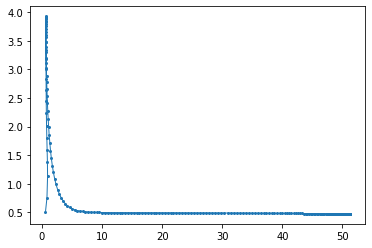

TopologyException: Input geom 1 is invalid: Self-intersection at or near point 8.0081289254463393 1.4016212223585043 at 8.0081289254463393 1.4016212223585043
TopologyException: Input geom 1 is invalid: Self-intersection at or near point 8.0081289254463393 1.4016212223585043 at 8.0081289254463393 1.4016212223585043
TopologyException: Input geom 1 is invalid: Self-intersection at or near point 8.0081289254463393 1.4016212223585043 at 8.0081289254463393 1.4016212223585043
union is not found
intersection is not found
Cost not calculated
Simulation took:  0:01:03.096582
Simulation started at:  2020-04-27 20:27:35.718819
a:  0.075 delta_u 0.006 delta_nu 0.005


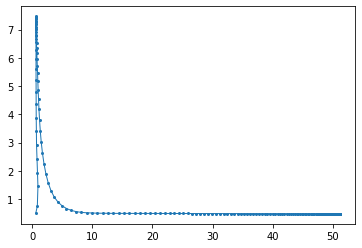

A_m is not valid
Simulation took:  0:01:03.568837
Simulation started at:  2020-04-27 20:28:39.336367
a:  0.1 delta_u 0.006 delta_nu 0.005


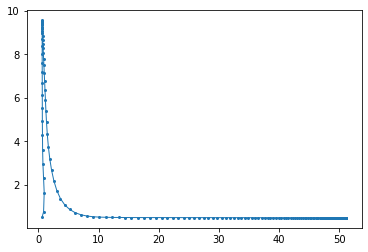

A_m is not valid
Simulation took:  0:01:03.353068
Simulation started at:  2020-04-27 20:29:42.707863
a:  0.005 delta_u 0.006 delta_nu 0.015


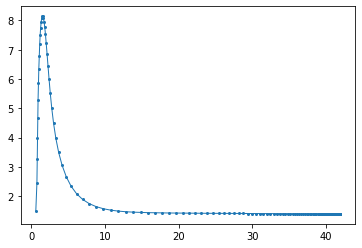

A_m is not valid
Simulation took:  0:01:03.607838
Simulation started at:  2020-04-27 20:30:46.347661
a:  0.035 delta_u 0.006 delta_nu 0.015


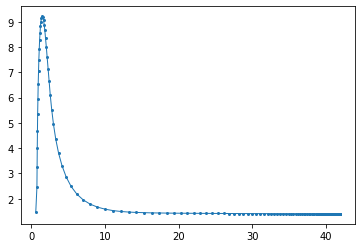

A_m is not valid
Simulation took:  0:01:03.762510
Simulation started at:  2020-04-27 20:31:50.134217
a:  0.075 delta_u 0.006 delta_nu 0.015


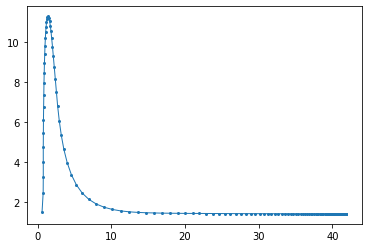

A_m is not valid
Simulation took:  0:01:03.483295
Simulation started at:  2020-04-27 20:32:53.641560
a:  0.1 delta_u 0.006 delta_nu 0.015


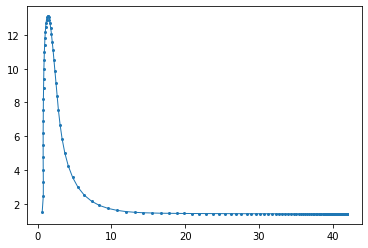

A_m is not valid
Simulation took:  0:01:05.064061
Simulation started at:  2020-04-27 20:33:58.733253
a:  0.005 delta_u 0.006 delta_nu 0.015


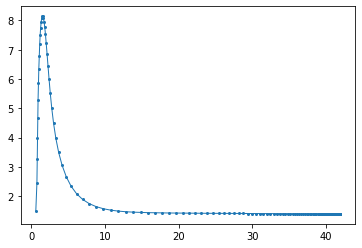

A_m is not valid
Simulation took:  0:01:03.386391
Simulation started at:  2020-04-27 20:35:02.139544
a:  0.035 delta_u 0.006 delta_nu 0.015


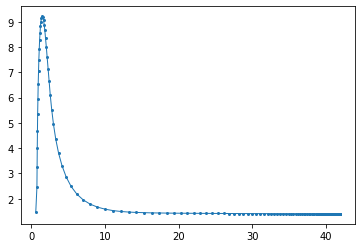

A_m is not valid
Simulation took:  0:01:03.777673
Simulation started at:  2020-04-27 20:36:05.936517
a:  0.075 delta_u 0.006 delta_nu 0.015


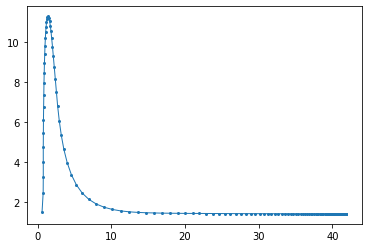

A_m is not valid
Simulation took:  0:01:03.276711
Simulation started at:  2020-04-27 20:37:09.327456
a:  0.1 delta_u 0.006 delta_nu 0.015


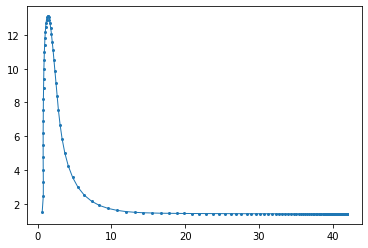

A_m is not valid
Simulation took:  0:01:02.997241
Simulation started at:  2020-04-27 20:38:12.358579
a:  0.005 delta_u 0.006 delta_nu 0.015


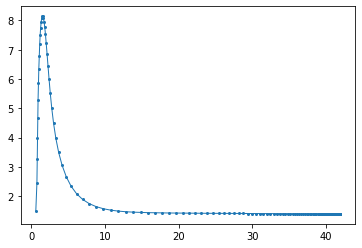

A_m is not valid
Simulation took:  0:01:03.596776
Simulation started at:  2020-04-27 20:39:15.982795
a:  0.035 delta_u 0.006 delta_nu 0.015


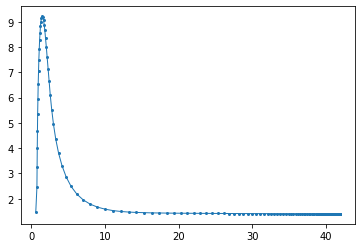

A_m is not valid
Simulation took:  0:01:02.729649
Simulation started at:  2020-04-27 20:40:18.759757
a:  0.075 delta_u 0.006 delta_nu 0.015


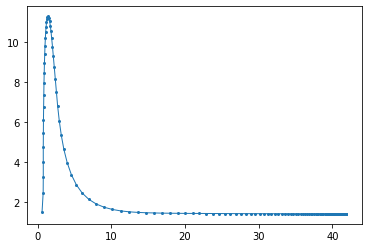

A_m is not valid
Simulation took:  0:01:03.528967
Simulation started at:  2020-04-27 20:41:22.390144
a:  0.1 delta_u 0.006 delta_nu 0.015


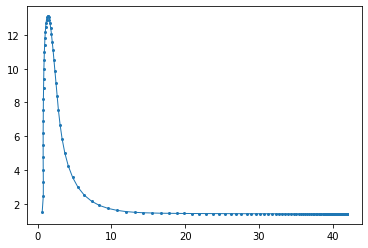

A_m is not valid
Simulation took:  0:01:03.077732
Simulation started at:  2020-04-27 20:42:25.492486
a:  0.005 delta_u 0.006 delta_nu 0.015


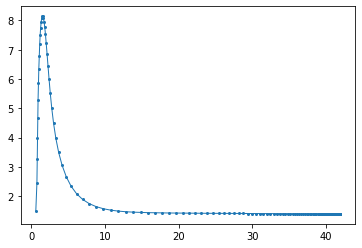

A_m is not valid
Simulation took:  0:01:03.469028
Simulation started at:  2020-04-27 20:43:28.997248
a:  0.035 delta_u 0.006 delta_nu 0.015


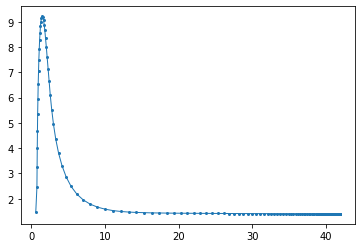

A_m is not valid
Simulation took:  0:01:02.852388
Simulation started at:  2020-04-27 20:44:31.870354
a:  0.075 delta_u 0.006 delta_nu 0.015


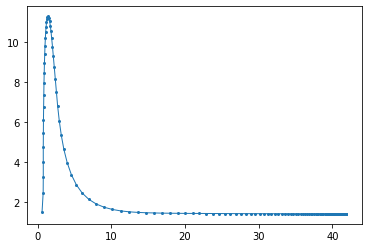

A_m is not valid
Simulation took:  0:01:03.448890
Simulation started at:  2020-04-27 20:45:35.342041
a:  0.1 delta_u 0.006 delta_nu 0.015


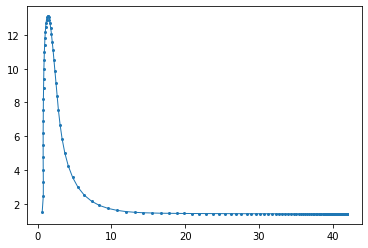

A_m is not valid
Simulation took:  0:01:02.772707
Simulation started at:  2020-04-27 20:46:38.141101
a:  0.005 delta_u 0.006 delta_nu 0.025


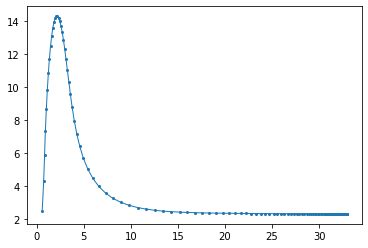

A_m is not valid
Simulation took:  0:01:03.546542
Simulation started at:  2020-04-27 20:47:41.761889
a:  0.035 delta_u 0.006 delta_nu 0.025


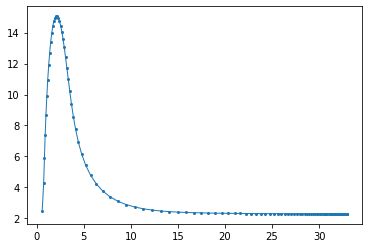

A_m is not valid
Simulation took:  0:01:03.513292
Simulation started at:  2020-04-27 20:48:45.352690
a:  0.075 delta_u 0.006 delta_nu 0.025


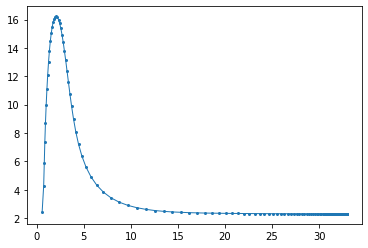

A_m is not valid
Simulation took:  0:01:03.138128
Simulation started at:  2020-04-27 20:49:48.514269
a:  0.1 delta_u 0.006 delta_nu 0.025


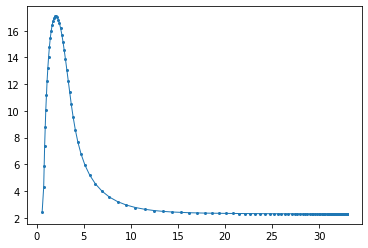

A_m is not valid
Simulation took:  0:01:03.405434
Simulation started at:2020-04-27 20:50:51.976794
a:  0.005 delta_u 0.006 delta_nu 0.025


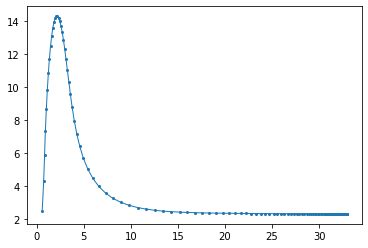

A_m is not valid
Simulation took:  0:01:13.240966
Simulation started at:  2020-04-27 20:52:05.328701
a:  0.035 delta_u 0.006 delta_nu 0.025


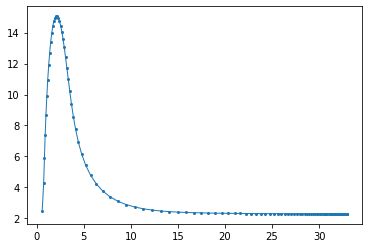

A_m is not valid
Simulation took:  0:01:19.149625
Simulation started at:  2020-04-27 20:53:24.531372
a:  0.075 delta_u 0.006 delta_nu 0.025


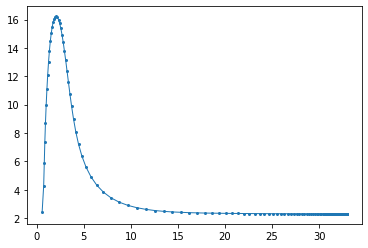

A_m is not valid
Simulation took:  0:01:24.548488
Simulation started at:  2020-04-27 20:54:49.184969
a:  0.1 delta_u 0.006 delta_nu 0.025


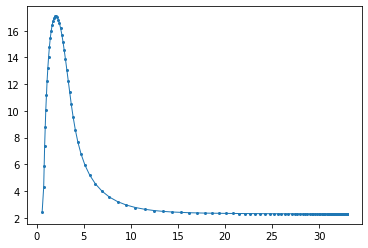

A_m is not valid
Simulation took:  0:01:25.543425
Simulation started at:  2020-04-27 20:56:14.783482
a:  0.005 delta_u 0.006 delta_nu 0.025


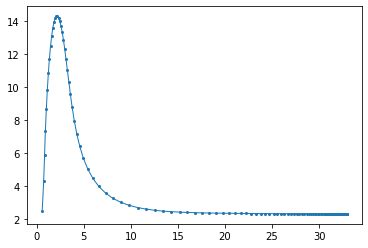

A_m is not valid
Simulation took:  0:01:25.142391
Simulation started at:  2020-04-27 20:57:40.054753
a:  0.035 delta_u 0.006 delta_nu 0.025


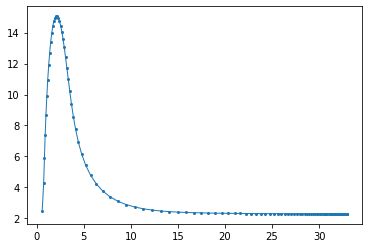

A_m is not valid
Simulation took:  0:01:28.883221
Simulation started at:  2020-04-27 20:59:08.963469
a:  0.075 delta_u 0.006 delta_nu 0.025


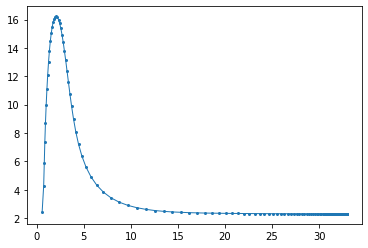

A_m is not valid
Simulation took:  0:01:24.578536
Simulation started at:  2020-04-27 21:00:33.687342
a:  0.1 delta_u 0.006 delta_nu 0.025


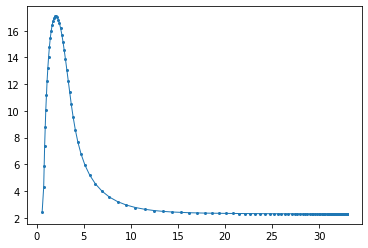

A_m is not valid
Simulation took:  0:01:23.738664
Simulation started at:  2020-04-27 21:01:57.613580
a:  0.005 delta_u 0.006 delta_nu 0.025


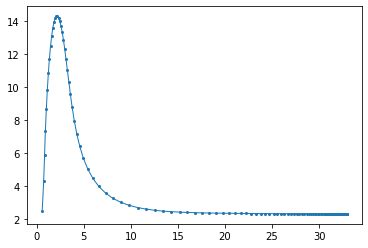

A_m is not valid
Simulation took:  0:01:24.244869
Simulation started at:  2020-04-27 21:03:21.905352
a:  0.035 delta_u 0.006 delta_nu 0.025


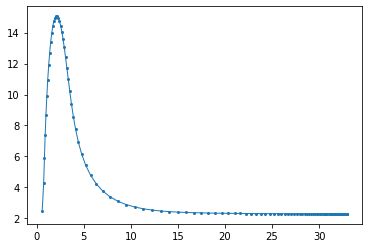

A_m is not valid
Simulation took:  0:01:23.062813
Simulation started at:  2020-04-27 21:04:44.993795
a:  0.075 delta_u 0.006 delta_nu 0.025


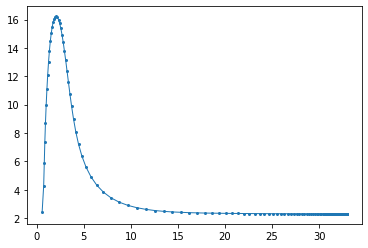

A_m is not valid
Simulation took:  0:01:24.423806
Simulation started at:  2020-04-27 21:06:09.520089
a:  0.1 delta_u 0.006 delta_nu 0.025


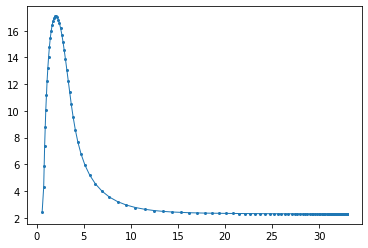

A_m is not valid
Simulation took:  0:01:24.499875
Simulation started at:  2020-04-27 21:07:34.140490
a:  0.005 delta_u 0.02 delta_nu 0.005


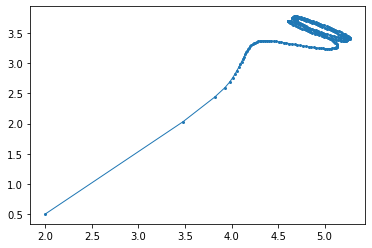

A_m is not valid
Simulation took:  0:01:23.755590
Simulation started at:  2020-04-27 21:08:57.914989
a:  0.035 delta_u 0.02 delta_nu 0.005


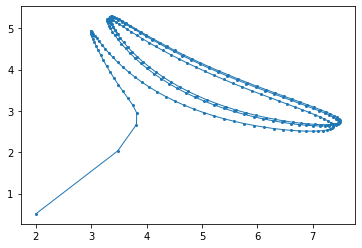

A_m is not valid
Simulation took:  0:01:15.772431
Simulation started at: 2020-04-27 21:10:13.824349
a:  0.075 delta_u 0.02 delta_nu 0.005


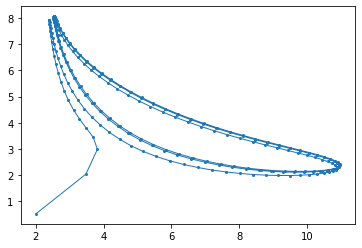

A_m is not valid
Simulation took:  0:01:10.501707
Simulation started at:  2020-04-27 21:11:24.369982
a:  0.1 delta_u 0.02 delta_nu 0.005


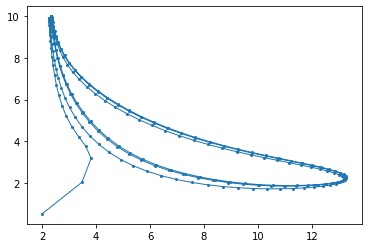

A_m is not valid
Simulation took:  0:01:10.179552
Simulation started at:  2020-04-27 21:12:34.645234
a:  0.005 delta_u 0.02 delta_nu 0.005


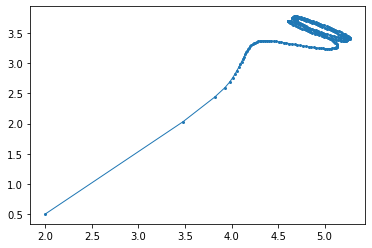

A_m is not valid
Simulation took:  0:01:10.488518
Simulation started at:  2020-04-27 21:13:45.160391
a:  0.035 delta_u 0.02 delta_nu 0.005


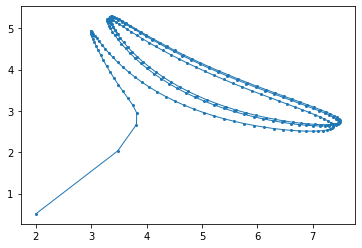

A_m is not valid
Simulation took:  0:01:09.852371
Simulation started at:  2020-04-27 21:14:55.080685
a:  0.075 delta_u 0.02 delta_nu 0.005


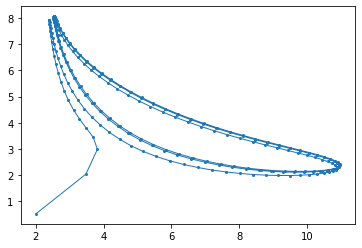

A_m is not valid
Simulation took:  0:01:10.973495
Simulation started at:  2020-04-27 21:16:06.092086
a:  0.1 delta_u 0.02 delta_nu 0.005


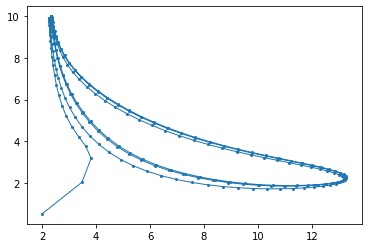

A_m is not valid
Simulation took:  0:01:11.454156
Simulation started at:  2020-04-27 21:17:17.576076
a:  0.005 delta_u 0.02 delta_nu 0.005


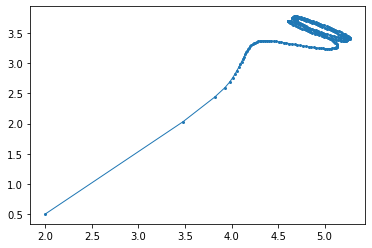

A_m is not valid
Simulation took:  0:01:15.845189
Simulation started at:  2020-04-27 21:18:33.680670
a:  0.035 delta_u 0.02 delta_nu 0.005


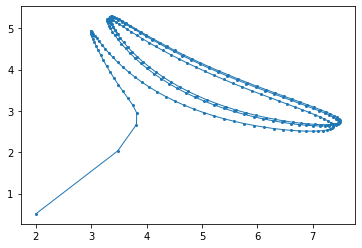

A_m is not valid
Simulation took:  0:01:23.644881
Simulation started at:  2020-04-27 21:19:57.372585
a:  0.075 delta_u 0.02 delta_nu 0.005


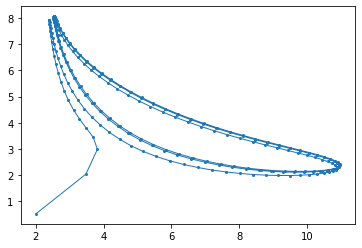

A_m is not valid
Simulation took:  0:01:34.062451
Simulation started at:  2020-04-27 21:21:31.513734
a:  0.1 delta_u 0.02 delta_nu 0.005


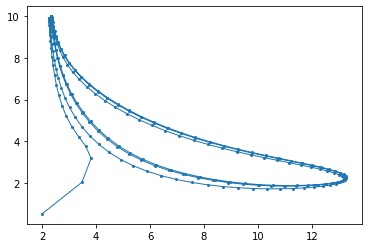

A_m is not valid
Simulation took:  0:01:35.204265
Simulation started at:  2020-04-27 21:23:06.841647
a:  0.005 delta_u 0.02 delta_nu 0.005


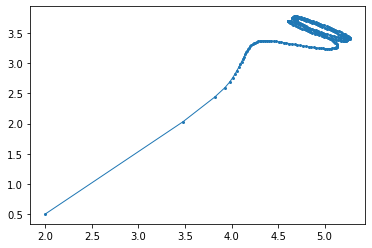

A_m is not valid
Simulation took:  0:01:36.951344
Simulation started at:  2020-04-27 21:24:43.937028
a:  0.035 delta_u 0.02 delta_nu 0.005


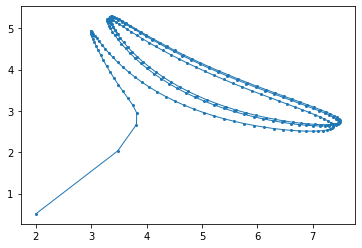

A_m is not valid
Simulation took:  0:02:00.994628
Simulation started at:  2020-04-27 21:26:45.068902
a:  0.075 delta_u 0.02 delta_nu 0.005


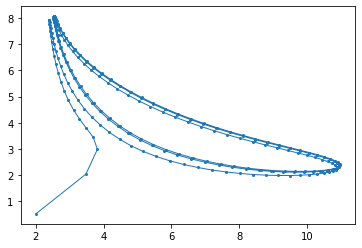

A_m is not valid
Simulation took:  0:01:30.160042
Simulation started at:  2020-04-27 21:28:15.264111
a:  0.1 delta_u 0.02 delta_nu 0.005


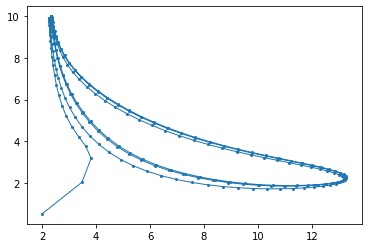

A_m is not valid
Simulation took:  0:01:26.831868
Simulation started at:  2020-04-27 21:29:42.142332
a:  0.005 delta_u 0.02 delta_nu 0.015


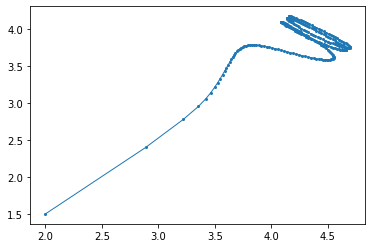

A_m is not valid
Simulation took:  0:01:22.074735
Simulation started at:  2020-04-27 21:31:04.269120
a:  0.035 delta_u 0.02 delta_nu 0.015


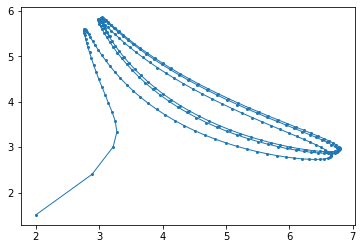

A_m is not valid
Simulation took:  0:01:19.672195
Simulation started at:  2020-04-27 21:32:23.992983
a:  0.075 delta_u 0.02 delta_nu 0.015


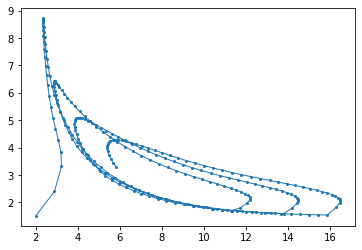

A_m is not valid
Simulation took:  0:01:19.259929
Simulation started at:  2020-04-27 21:33:43.518618
a:  0.1 delta_u 0.02 delta_nu 0.015


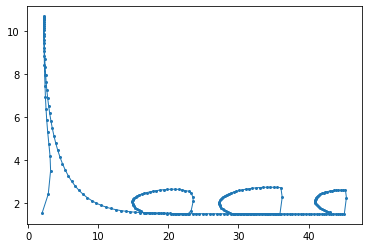

A_m is not valid
Simulation took:  0:01:18.086391
Simulation started at:  2020-04-27 21:35:01.650489
a:  0.005 delta_u 0.02 delta_nu 0.015


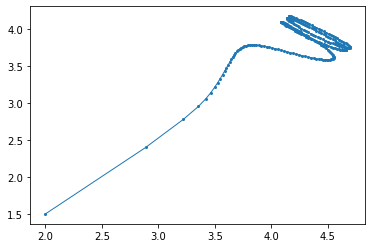

A_m is not valid
Simulation took:  0:01:18.866638
Simulation started at:  2020-04-27 21:36:20.590773
a:  0.035 delta_u 0.02 delta_nu 0.015


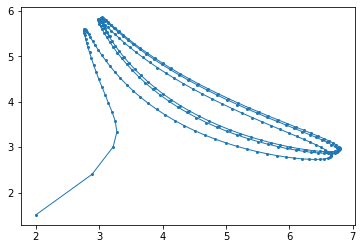

A_m is not valid
Simulation took:  0:01:18.288688
Simulation started at:  2020-04-27 21:37:38.921758
a:  0.075 delta_u 0.02 delta_nu 0.015


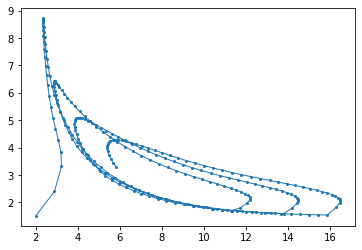

A_m is not valid
Simulation took:  0:01:20.675056
Simulation started at:  2020-04-27 21:38:59.680793
a:  0.1 delta_u 0.02 delta_nu 0.015


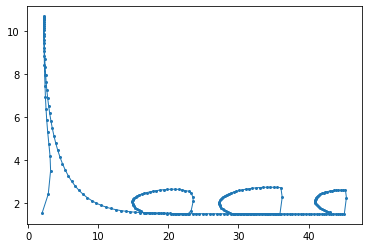

A_m is not valid
Simulation took:  0:01:17.489528
Simulation started at:  2020-04-27 21:40:17.195078
a:  0.005 delta_u 0.02 delta_nu 0.015


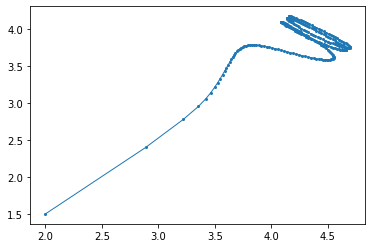

A_m is not valid
Simulation took:  0:01:11.369076
Simulation started at:  2020-04-27 21:41:28.583640
a:  0.035 delta_u 0.02 delta_nu 0.015


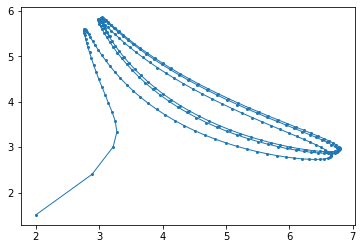

A_m is not valid
Simulation took:  0:01:03.373870
Simulation started at:  2020-04-27 21:42:31.981530
a:  0.075 delta_u 0.02 delta_nu 0.015


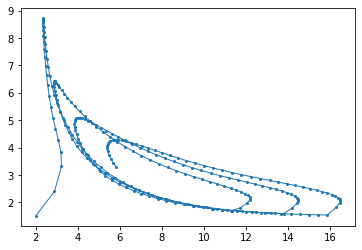

A_m is not valid
Simulation took:0:01:03.556898
Simulation started at:  2020-04-27 21:43:35.659521
a:  0.1 delta_u 0.02 delta_nu 0.015


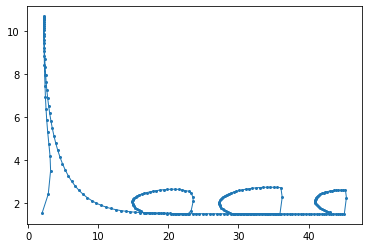

A_m is not valid
Simulation took:  0:01:04.230016
Simulation started at:  2020-04-27 21:44:39.919007
a:  0.005 delta_u 0.02 delta_nu 0.015


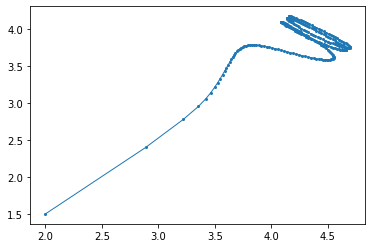

A_m is not valid
Simulation took:  0:01:11.191257
Simulation started at:  2020-04-27 21:45:51.187685
a:  0.035 delta_u 0.02 delta_nu 0.015


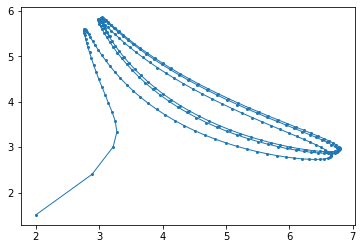

A_m is not valid
Simulation took:  0:01:04.025299
Simulation started at:  2020-04-27 21:46:55.235422
a:  0.075 delta_u 0.02 delta_nu 0.015


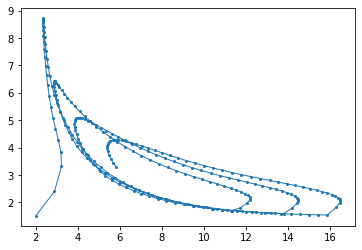

A_m is not valid
Simulation took:  0:04:03.261947
Simulation started at:  2020-04-27 21:50:58.732378
a:  0.1 delta_u 0.02 delta_nu 0.015


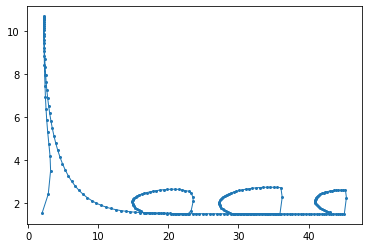

A_m is not valid
Simulation took:  0:06:30.766306
Simulation started at:  2020-04-27 21:57:29.589594
a:  0.005 delta_u 0.02 delta_nu 0.025


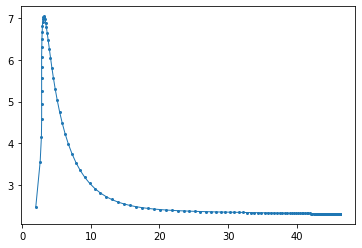

A_m is not valid
Simulation took:  0:39:59.544457
Simulation started at:  2020-04-27 22:37:29.172375
a:  0.035 delta_u 0.02 delta_nu 0.025


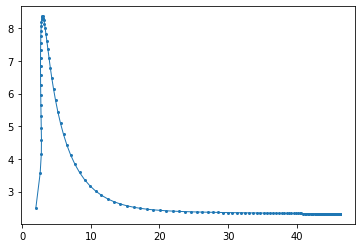

A_m is not valid
Simulation took:  0:04:49.083775
Simulation started at:  2020-04-27 22:42:18.532559
a:  0.075 delta_u 0.02 delta_nu 0.025


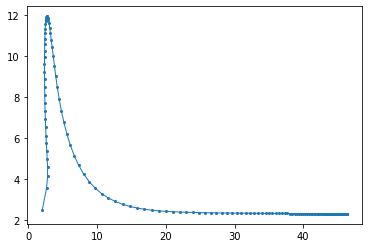

A_m is not valid
Simulation took:  0:01:16.829914
Simulation started at:  2020-04-27 22:43:35.391435
a:  0.1 delta_u 0.02 delta_nu 0.025


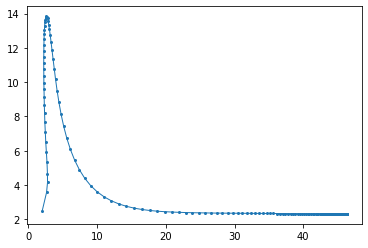

A_m is not valid
Simulation took:  0:01:21.085525
Simulation started at:  2020-04-27 22:44:56.559200
a:  0.005 delta_u 0.02 delta_nu 0.025


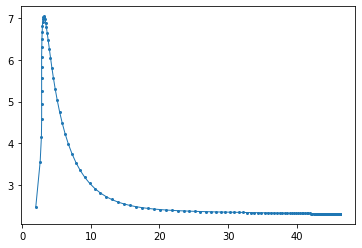

A_m is not valid
Simulation took:  0:01:18.953060
Simulation started at:  2020-04-27 22:46:15.546677
a:  0.035 delta_u 0.02 delta_nu 0.025


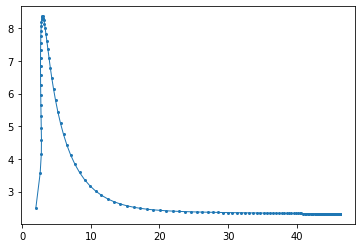

A_m is not valid
Simulation took:  0:01:11.765966
Simulation started at:  2020-04-27 22:47:27.332735
a:  0.075 delta_u 0.02 delta_nu 0.025


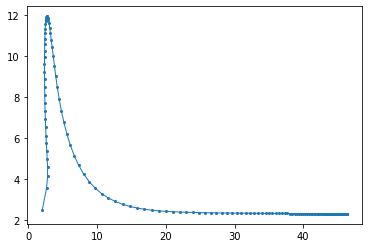

A_m is not valid
Simulation took:  0:01:31.815671
Simulation started at:  2020-04-27 22:48:59.194125
a:  0.1 delta_u 0.02 delta_nu 0.025


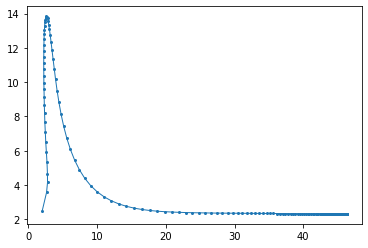

A_m is not valid
Simulation took:  0:01:24.026382
Simulation started at:  2020-04-27 22:50:23.256524
a:  0.005 delta_u 0.02 delta_nu 0.025


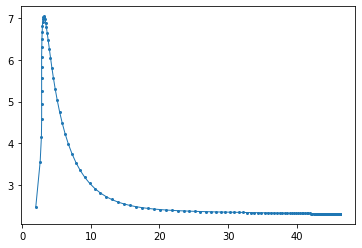

A_m is not valid
Simulation took:  0:01:13.967614
Simulation started at:  2020-04-27 22:51:37.250856
a:  0.035 delta_u 0.02 delta_nu 0.025


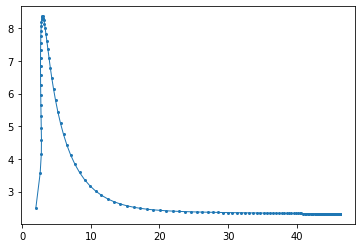

A_m is not valid
Simulation took:  0:01:30.489027
Simulation started at:  2020-04-27 22:53:07.817097
a:  0.075 delta_u 0.02 delta_nu 0.025


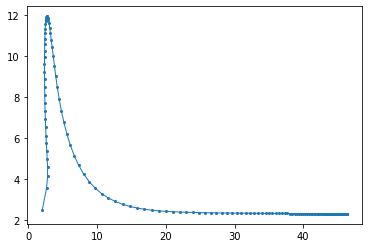

A_m is not valid
Simulation took:  0:01:33.991803
Simulation started at:  2020-04-27 22:54:41.838405
a:  0.1 delta_u 0.02 delta_nu 0.025


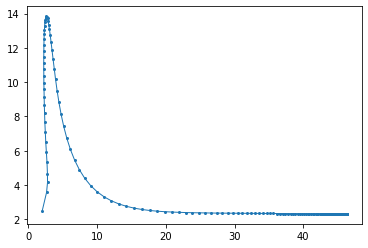

A_m is not valid
Simulation took:  0:01:39.151395
Simulation started at:  2020-04-27 22:56:21.082562
a:  0.005 delta_u 0.02 delta_nu 0.025


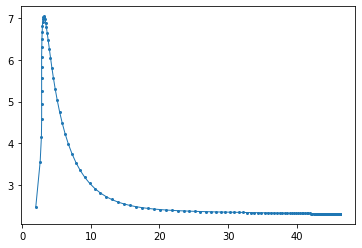

A_m is not valid
Simulation took:  0:01:18.971618
Simulation started at:  2020-04-27 22:57:40.266522
a:  0.035 delta_u 0.02 delta_nu 0.025


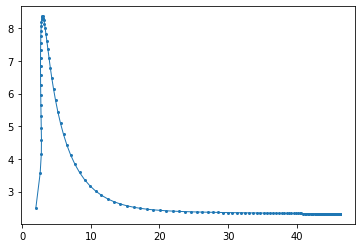

A_m is not valid
Simulation took:  0:01:14.971112
Simulation started at:  2020-04-27 22:58:55.258812
a:  0.075 delta_u 0.02 delta_nu 0.025


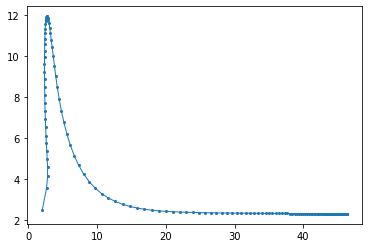

A_m is not valid
Simulation took:  0:01:12.746161
Simulation started at:  2020-04-27 23:00:08.029358
a:  0.1 delta_u 0.02 delta_nu 0.025


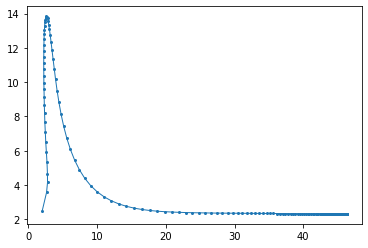

A_m is not valid
Simulation took:0:01:13.312963
Simulation started at:  2020-04-27 23:01:21.554905
a:  0.005 delta_u 0.05 delta_nu 0.005


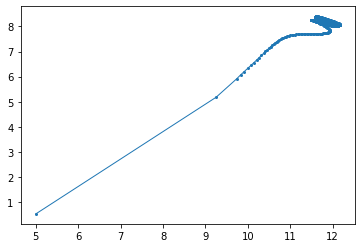

A_m is not valid
Simulation took:  0:01:13.764003
Simulation started at:  2020-04-27 23:02:35.567527
a:  0.035 delta_u 0.05 delta_nu 0.005


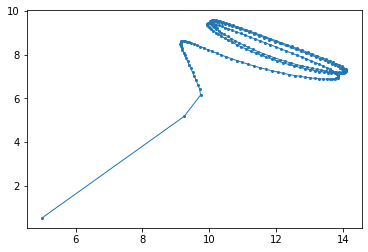

A_m is not valid
Simulation took:  0:01:12.424262
Simulation started at:  2020-04-27 23:03:48.016841
a:  0.075 delta_u 0.05 delta_nu 0.005


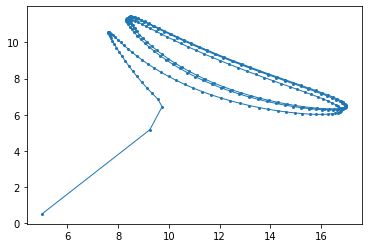

A_m is not valid
Simulation took:  0:01:13.541111
Simulation started at:  2020-04-27 23:05:01.617685
a:  0.1 delta_u 0.05 delta_nu 0.005


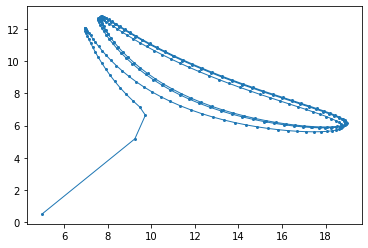

A_m is not valid
Simulation took:  0:01:13.092161
Simulation started at:  2020-04-27 23:06:14.789569
a:  0.005 delta_u 0.05 delta_nu 0.005


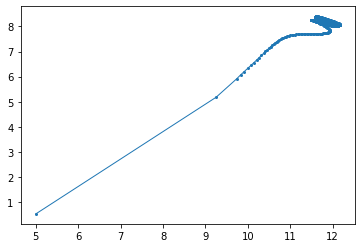

A_m is not valid
Simulation took:  0:01:13.566521
Simulation started at:  2020-04-27 23:07:28.457070
a:  0.035 delta_u 0.05 delta_nu 0.005


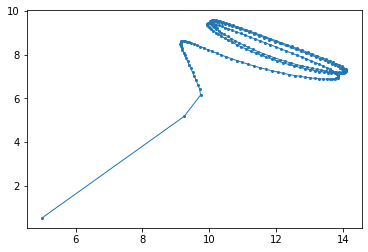

A_m is not valid
Simulation took:  0:01:14.050375
Simulation started at:  2020-04-27 23:08:42.679820
a:  0.075 delta_u 0.05 delta_nu 0.005


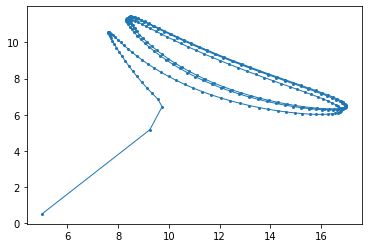

A_m is not valid
Simulation took:  0:01:13.640226
Simulation started at:  2020-04-27 23:09:56.388030
a:  0.1 delta_u 0.05 delta_nu 0.005


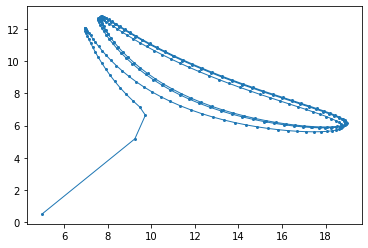

A_m is not valid
Simulation took:  0:01:13.223247
Simulation started at:  2020-04-27 23:11:09.638695
a:  0.005 delta_u 0.05 delta_nu 0.005


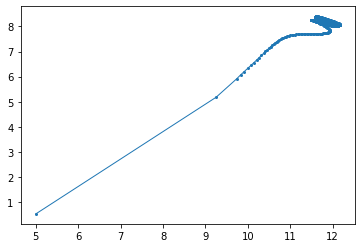

A_m is not valid
Simulation took:  0:01:12.142024
Simulation started at:  2020-04-27 23:12:21.821040
a:  0.035 delta_u 0.05 delta_nu 0.005


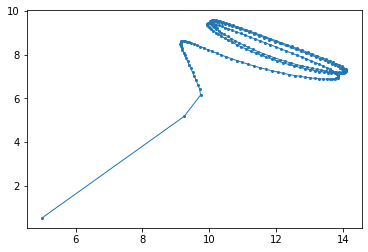

A_m is not valid
Simulation took:  0:01:12.705867
Simulation started at:  2020-04-27 23:13:34.550225
a:  0.075 delta_u 0.05 delta_nu 0.005


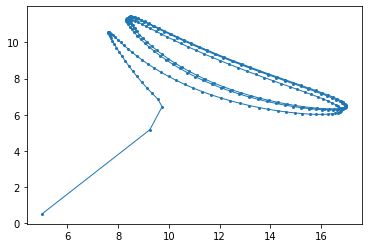

A_m is not valid
Simulation took:  0:01:15.314957
Simulation started at:  2020-04-27 23:14:50.084719
a:  0.1 delta_u 0.05 delta_nu 0.005


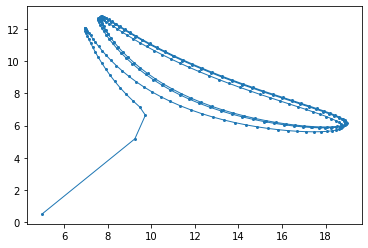

A_m is not valid
Simulation took:  0:01:15.430115
Simulation started at:  2020-04-27 23:16:05.542612
a:  0.005 delta_u 0.05 delta_nu 0.005


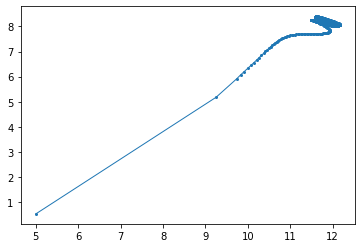

A_m is not valid
Simulation took:  0:01:14.752525
Simulation started at:  2020-04-27 23:17:20.326625
a:  0.035 delta_u 0.05 delta_nu 0.005


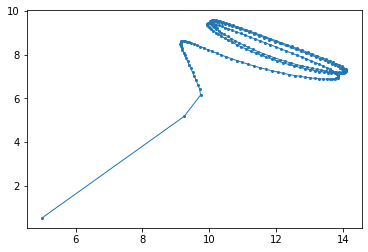

A_m is not valid
Simulation took:  0:01:19.774832
Simulation started at:  2020-04-27 23:18:40.184999
a:  0.075 delta_u 0.05 delta_nu 0.005


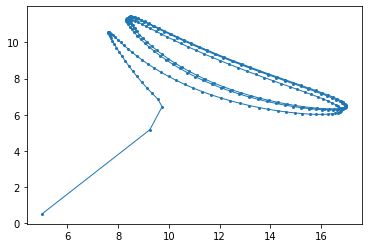

A_m is not valid
Simulation took:  0:01:27.485406
Simulation started at:  2020-04-27 23:20:07.822621
a:  0.1 delta_u 0.05 delta_nu 0.005


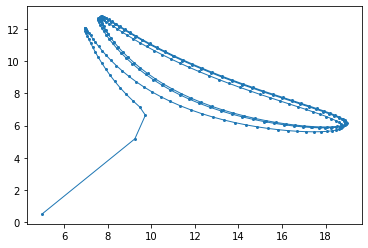

A_m is not valid
Simulation took:  0:01:21.607585
Simulation started at:  2020-04-27 23:21:29.467950
a:  0.005 delta_u 0.05 delta_nu 0.015


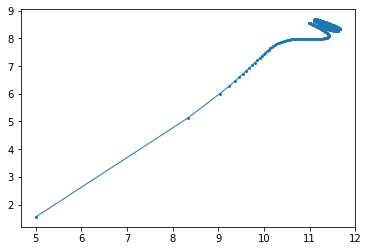

A_m is not valid
Simulation took:  0:01:22.287252
Simulation started at:  2020-04-27 23:22:51.787441
a:  0.035 delta_u 0.05 delta_nu 0.015


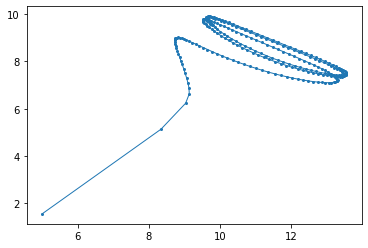

A_m is not valid
Simulation took:  0:01:22.446612
Simulation started at:  2020-04-27 23:24:14.263082
a:  0.075 delta_u 0.05 delta_nu 0.015


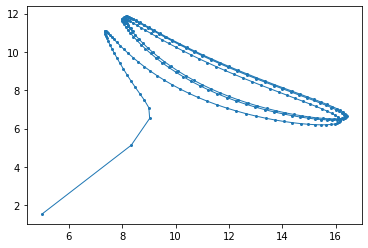

A_m is not valid
Simulation took:  0:01:21.252082
Simulation started at:  2020-04-27 23:25:35.603121
a:  0.1 delta_u 0.05 delta_nu 0.015


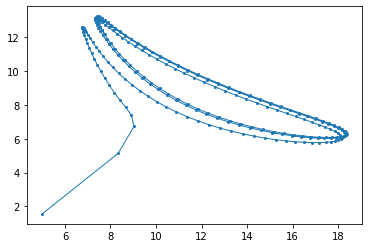

A_m is not valid
Simulation took:  0:01:20.259450
Simulation started at:  2020-04-27 23:26:55.953039
a:  0.005 delta_u 0.05 delta_nu 0.015


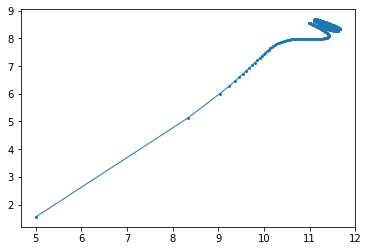

A_m is not valid
Simulation took:  0:01:29.975362
Simulation started at:  2020-04-27 23:28:26.062883
a:  0.035 delta_u 0.05 delta_nu 0.015


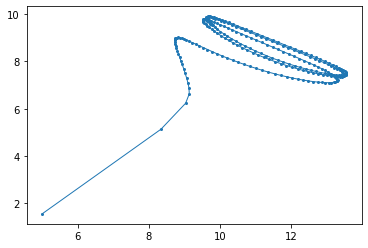

A_m is not valid
Simulation took:  0:01:45.210038
Simulation started at:  2020-04-27 23:30:11.311670
a:  0.075 delta_u 0.05 delta_nu 0.015


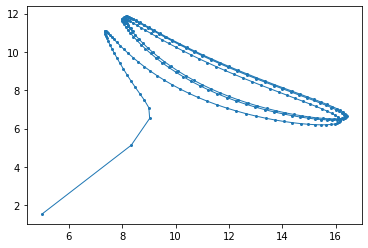

A_m is not valid
Simulation took:  0:01:22.834524
Simulation started at:  2020-04-27 23:31:34.397073
a:  0.1 delta_u 0.05 delta_nu 0.015


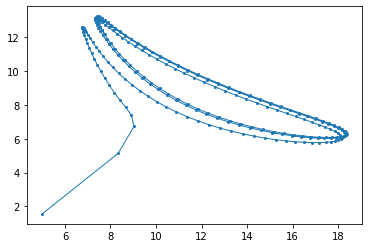

A_m is not valid
Simulation took:  0:01:22.451672
Simulation started at:  2020-04-27 23:32:56.874764
a:  0.005 delta_u 0.05 delta_nu 0.015


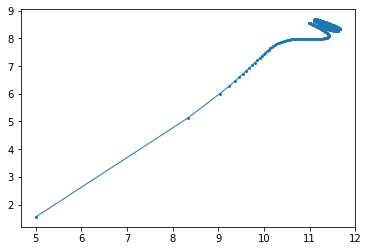

A_m is not valid
Simulation took:  0:01:21.873344
Simulation started at:  2020-04-27 23:34:18.772214
a:  0.035 delta_u 0.05 delta_nu 0.015


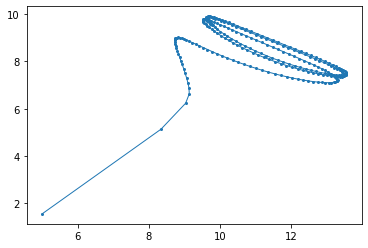

A_m is not valid
Simulation took:  0:01:12.924115
Simulation started at:  2020-04-27 23:35:31.753099
a:  0.075 delta_u 0.05 delta_nu 0.015


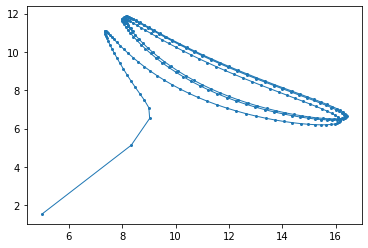

A_m is not valid
Simulation took:  0:01:17.489420
Simulation started at:  2020-04-27 23:36:49.267551
a:  0.1 delta_u 0.05 delta_nu 0.015


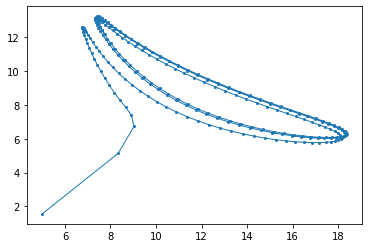

A_m is not valid
Simulation took:  0:01:22.681789
Simulation started at:  2020-04-27 23:38:12.109819
a:  0.005 delta_u 0.05 delta_nu 0.015


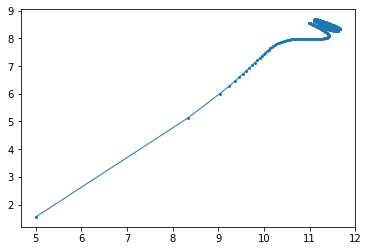

A_m is not valid
Simulation took:  0:01:21.750647
Simulation started at:  2020-04-27 23:39:33.933587
a:  0.035 delta_u 0.05 delta_nu 0.015


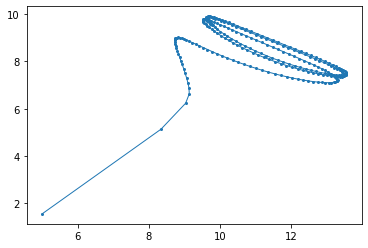

A_m is not valid
Simulation took:  0:01:21.973101
Simulation started at:  2020-04-27 23:40:56.037276
a:  0.075 delta_u 0.05 delta_nu 0.015


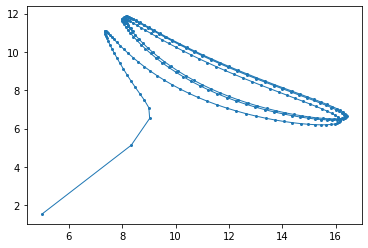

A_m is not valid
Simulation took:  0:01:21.788694
Simulation started at:  2020-04-27 23:42:17.853473
a:  0.1 delta_u 0.05 delta_nu 0.015


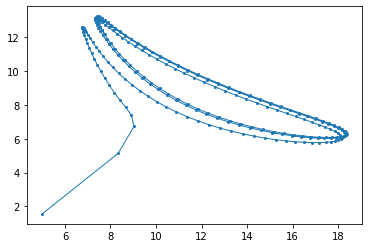

A_m is not valid
Simulation took:  0:01:21.016117
Simulation started at:  2020-04-27 23:43:38.906074
a:  0.005 delta_u 0.05 delta_nu 0.025


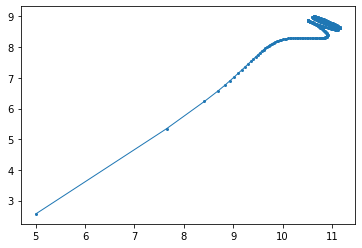

A_m is not valid
Simulation took:  0:01:21.476298
Simulation started at:  2020-04-27 23:45:00.565348
a:  0.035 delta_u 0.05 delta_nu 0.025


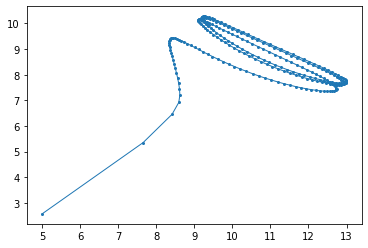

A_m is not valid
Simulation took:  0:01:21.046381
Simulation started at:  2020-04-27 23:46:21.633514
a:  0.075 delta_u 0.05 delta_nu 0.025


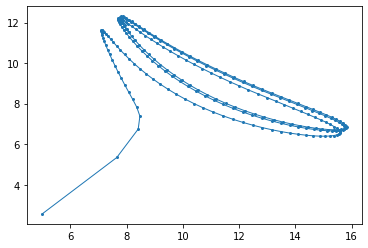

A_m is not valid
Simulation took:  0:01:21.867201
Simulation started at:  2020-04-27 23:47:43.652192
a:  0.1 delta_u 0.05 delta_nu 0.025


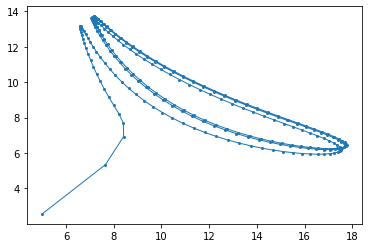

A_m is not valid
Simulation took:  0:01:18.868034
Simulation started at:  2020-04-27 23:49:02.553110
a:  0.005 delta_u 0.05 delta_nu 0.025


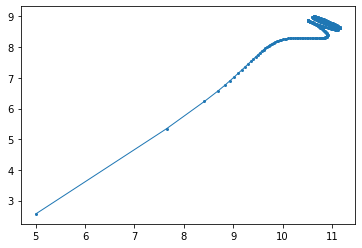

A_m is not valid
Simulation took:0:01:22.816634
Simulation started at:  2020-04-27 23:50:25.578503
a:  0.035 delta_u 0.05 delta_nu 0.025


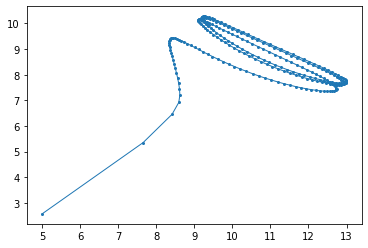

A_m is not valid
Simulation took:  0:01:21.132867
Simulation started at:  2020-04-27 23:51:46.750884
a:  0.075 delta_u 0.05 delta_nu 0.025


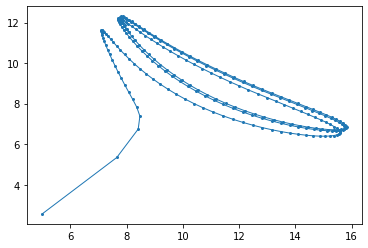

A_m is not valid
Simulation took:  0:01:21.128689
Simulation started at:  2020-04-27 23:53:07.925249
a:  0.1 delta_u 0.05 delta_nu 0.025


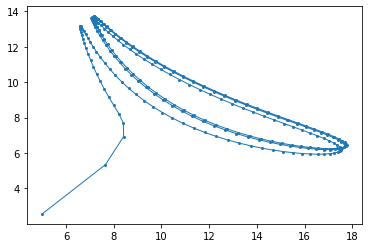

A_m is not valid
Simulation took:  0:01:23.817953
Simulation started at:  2020-04-27 23:54:31.989278
a:  0.005 delta_u 0.05 delta_nu 0.025


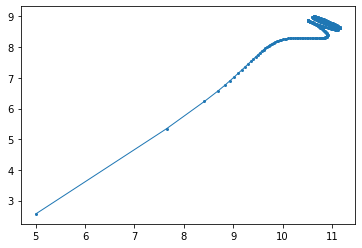

A_m is not valid
Simulation took:  0:01:33.892967
Simulation started at:  2020-04-27 23:56:05.927544
a:  0.035 delta_u 0.05 delta_nu 0.025


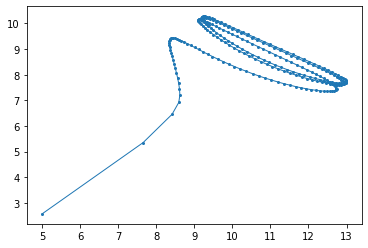

A_m is not valid
Simulation took:  0:01:22.898911
Simulation started at:  2020-04-27 23:57:28.892074
a:  0.075 delta_u 0.05 delta_nu 0.025


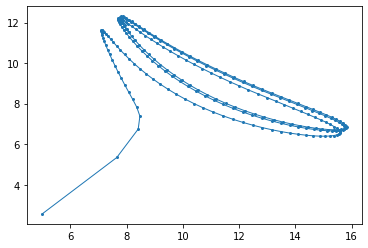

A_m is not valid
Simulation took:  0:01:41.279974
Simulation started at:  2020-04-27 23:59:10.222218
a:  0.1 delta_u 0.05 delta_nu 0.025


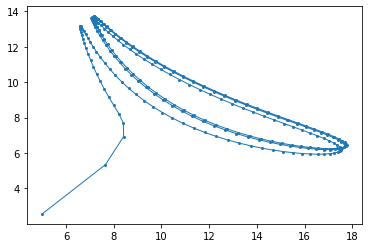

A_m is not valid
Simulation took:  0:01:30.643894
Simulation started at:  2020-04-28 00:00:40.928596
a:  0.005 delta_u 0.05 delta_nu 0.025


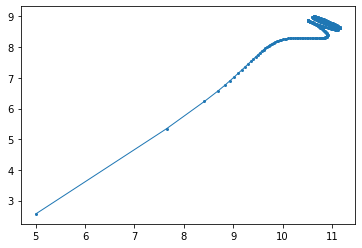

A_m is not valid
Simulation took:  0:01:22.677501
Simulation started at:  2020-04-28 00:02:03.651305
a:  0.035 delta_u 0.05 delta_nu 0.025


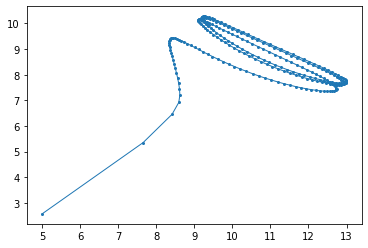

A_m is not valid
Simulation took:  0:01:24.135988
Simulation started at:  2020-04-28 00:03:27.848231
a:  0.075 delta_u 0.05 delta_nu 0.025


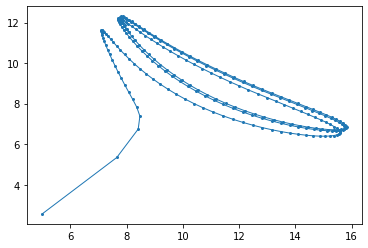

A_m is not valid
Simulation took:  0:01:21.292642
Simulation started at:  2020-04-28 00:04:49.261091
a:  0.1 delta_u 0.05 delta_nu 0.025


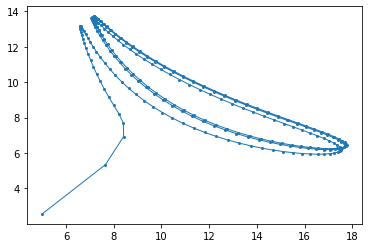

A_m is not valid
Simulation took:  0:01:22.274991
Simulation started at:  2020-04-28 00:06:11.566882
a:  0.005 delta_u 0.006 delta_nu 0.005


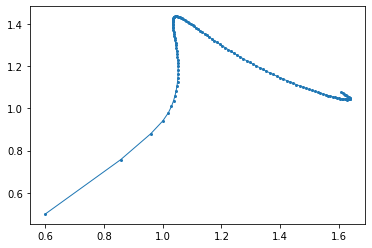

A_m is not valid
Simulation took:  0:00:41.697844
Simulation started at:  2020-04-28 00:06:53.289671
a:  0.035 delta_u 0.006 delta_nu 0.005


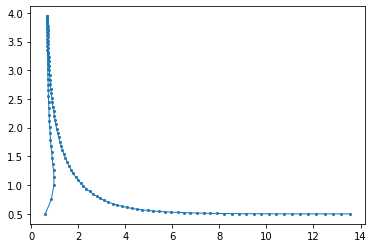

A_m is not valid
Simulation took:  0:00:49.864233
Simulation started at:  2020-04-28 00:07:43.175862
a:  0.075 delta_u 0.006 delta_nu 0.005


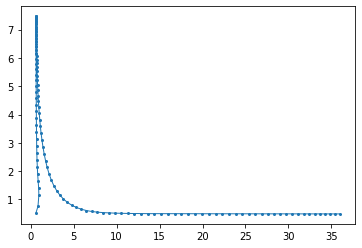

A_m is not valid
Simulation took:  0:00:41.972544
Simulation started at:  2020-04-28 00:08:25.192056
a:  0.1 delta_u 0.006 delta_nu 0.005


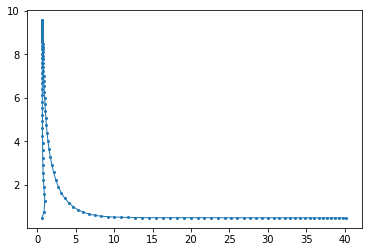

A_m is not valid
Simulation took:  0:00:41.378050
Simulation started at:  2020-04-28 00:09:06.756181
a:  0.005 delta_u 0.006 delta_nu 0.005


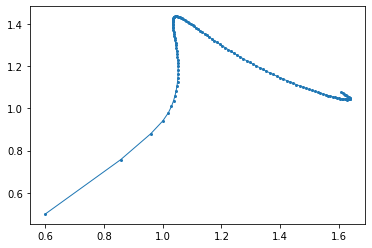

A_m is not valid
Simulation took:  0:00:43.444786
Simulation started at:  2020-04-28 00:09:50.219676
a:  0.035 delta_u 0.006 delta_nu 0.005


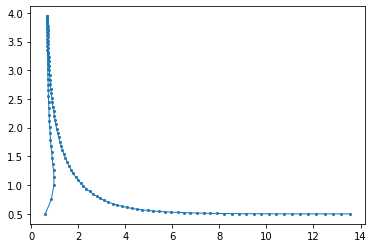

A_m is not valid
Simulation took:  0:00:41.473486
Simulation started at:  2020-04-28 00:10:31.751678
a:  0.075 delta_u 0.006 delta_nu 0.005


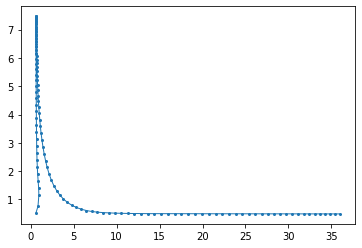

A_m is not valid
Simulation took:  0:00:41.074226
Simulation started at:  2020-04-28 00:11:12.848068
a:  0.1 delta_u 0.006 delta_nu 0.005


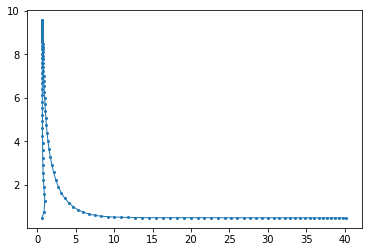

A_m is not valid
Simulation took:  0:00:41.381773
Simulation started at:  2020-04-28 00:11:54.265595
a:  0.005 delta_u 0.006 delta_nu 0.005


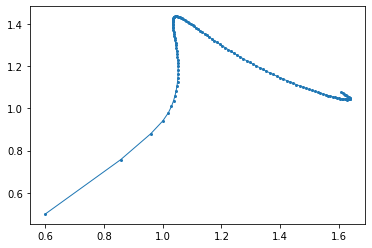

A_m is not valid
Simulation took:  0:00:39.919779
Simulation started at:  2020-04-28 00:12:34.203629
a:  0.035 delta_u 0.006 delta_nu 0.005


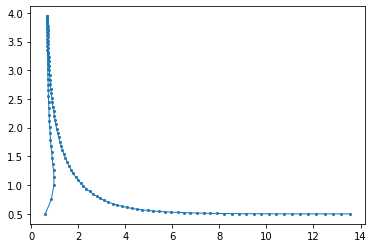

A_m is not valid
Simulation took:  0:00:37.915289
Simulation started at:  2020-04-28 00:13:12.191582
a:  0.075 delta_u 0.006 delta_nu 0.005


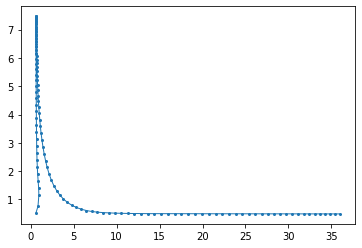

A_m is not valid
Simulation took:  0:00:46.718771
Simulation started at:  2020-04-28 00:13:58.969763
a:  0.1 delta_u 0.006 delta_nu 0.005


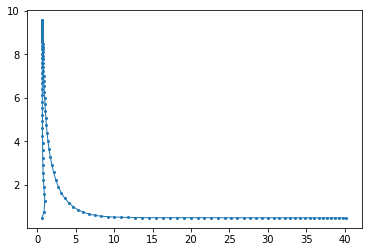

A_m is not valid
Simulation took:  0:00:45.688631
Simulation started at:  2020-04-28 00:14:44.721070
a:  0.005 delta_u 0.006 delta_nu 0.005


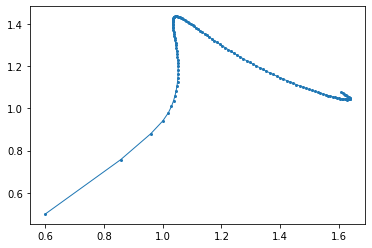

A_m is not valid
Simulation took:  0:00:46.267684
Simulation started at:  2020-04-28 00:15:31.107425
a:  0.035 delta_u 0.006 delta_nu 0.005


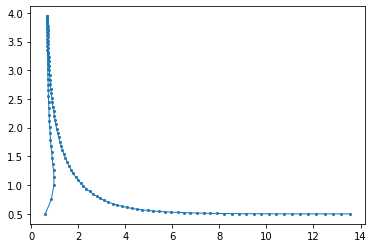

A_m is not valid
Simulation took:  0:00:47.926671
Simulation started at:  2020-04-28 00:16:19.175731
a:  0.075 delta_u 0.006 delta_nu 0.005


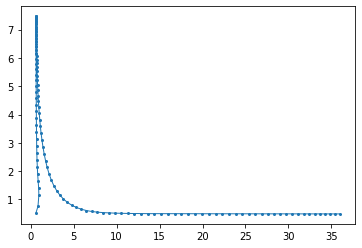

A_m is not valid
Simulation took:  0:00:46.126505
Simulation started at:  2020-04-28 00:17:05.479466
a:  0.1 delta_u 0.006 delta_nu 0.005


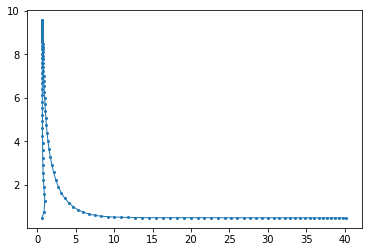

A_m is not valid
Simulation took:  0:00:45.525978
Simulation started at:  2020-04-28 00:17:51.088063
a:  0.005 delta_u 0.006 delta_nu 0.015


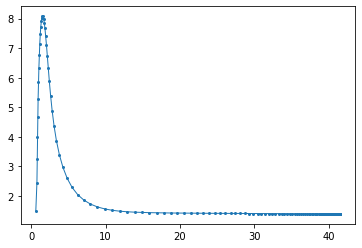

A_m is not valid
Simulation took:  0:00:45.781325
Simulation started at:  2020-04-28 00:18:36.948647
a:  0.035 delta_u 0.006 delta_nu 0.015


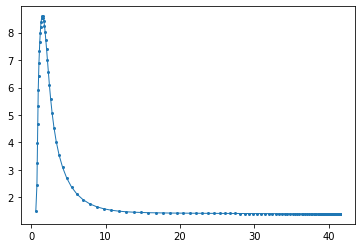

A_m is not valid
Simulation took:  0:00:47.352529
Simulation started at:  2020-04-28 00:19:24.329948
a:  0.075 delta_u 0.006 delta_nu 0.015


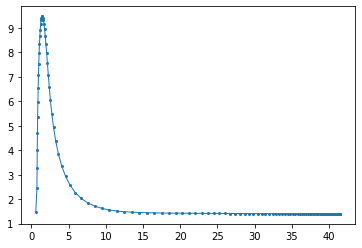

A_m is not valid
Simulation took:  0:00:38.006666
Simulation started at:  2020-04-28 00:20:02.360974
a:  0.1 delta_u 0.006 delta_nu 0.015


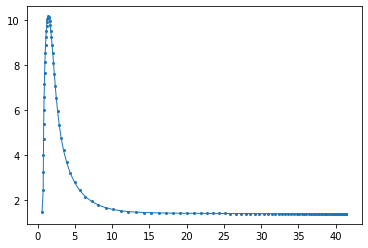

A_m is not valid
Simulation took:  0:00:37.467531
Simulation started at:  2020-04-28 00:20:39.862910
a:  0.005 delta_u 0.006 delta_nu 0.015


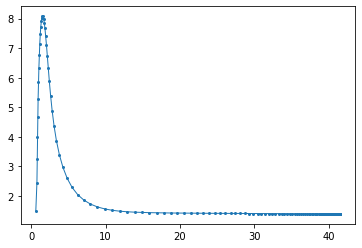

A_m is not valid
Simulation took:  0:00:36.686997
Simulation started at:  2020-04-28 00:21:16.568117
a:  0.035 delta_u 0.006 delta_nu 0.015


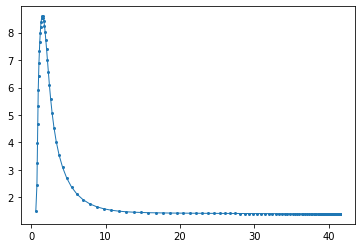

A_m is not valid
Simulation took:  0:00:37.016725
Simulation started at:  2020-04-28 00:21:53.601773
a:  0.075 delta_u 0.006 delta_nu 0.015


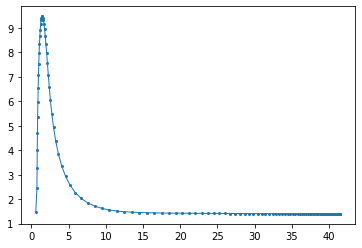

A_m is not valid
Simulation took:  0:00:37.670566
Simulation started at:  2020-04-28 00:22:31.319521
a:  0.1 delta_u 0.006 delta_nu 0.015


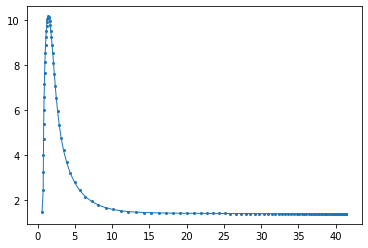

A_m is not valid
Simulation took:  0:00:37.630268
Simulation started at:  2020-04-28 00:23:09.012028
a:  0.005 delta_u 0.006 delta_nu 0.015


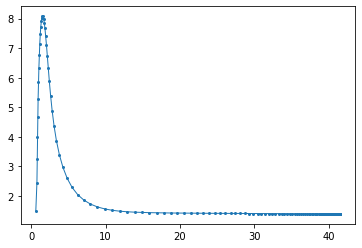

A_m is not valid
Simulation took:  0:00:38.285463
Simulation started at:  2020-04-28 00:23:47.333318
a:  0.035 delta_u 0.006 delta_nu 0.015


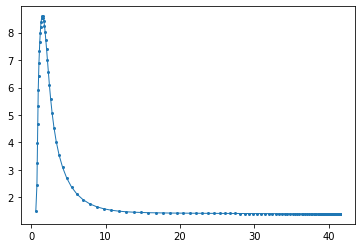

A_m is not valid
Simulation took:  0:00:37.826205
Simulation started at:  2020-04-28 00:24:25.175174
a:  0.075 delta_u 0.006 delta_nu 0.015


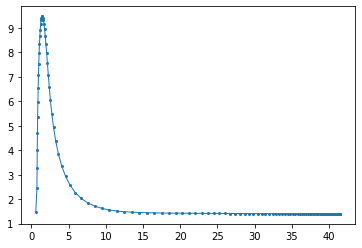

A_m is not valid
Simulation took:  0:00:37.721301
Simulation started at:  2020-04-28 00:25:02.998044
a:  0.1 delta_u 0.006 delta_nu 0.015


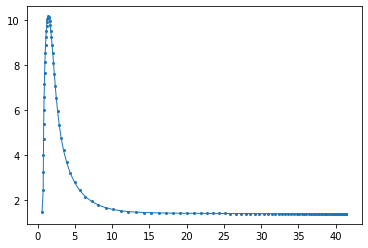

A_m is not valid
Simulation took:  0:00:38.505896
Simulation started at:  2020-04-28 00:25:41.528038
a:  0.005 delta_u 0.006 delta_nu 0.015


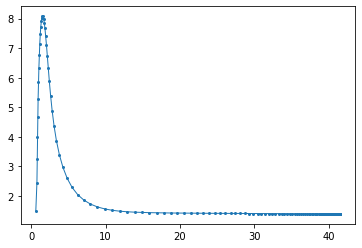

A_m is not valid
Simulation took:  0:00:38.497252
Simulation started at:  2020-04-28 00:26:20.045411
a:  0.035 delta_u 0.006 delta_nu 0.015


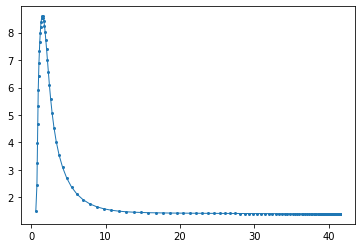

A_m is not valid
Simulation took:  0:00:37.660462
Simulation started at:  2020-04-28 00:26:57.750483
a:  0.075 delta_u 0.006 delta_nu 0.015


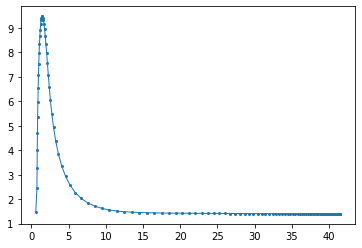

A_m is not valid
Simulation took:  0:00:37.909634
Simulation started at:  2020-04-28 00:27:35.708115
a:  0.1 delta_u 0.006 delta_nu 0.015


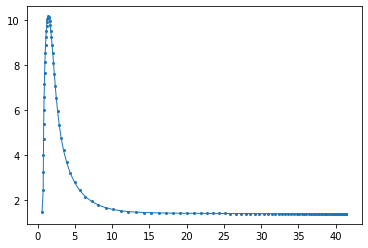

A_m is not valid
Simulation took:  0:00:36.781330
Simulation started at:  2020-04-28 00:28:12.507576
a:  0.005 delta_u 0.006 delta_nu 0.025


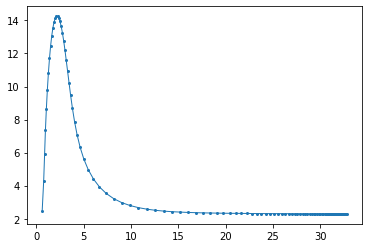

A_m is not valid
Simulation took:  0:00:37.583500
Simulation started at:  2020-04-28 00:28:50.119510
a:  0.035 delta_u 0.006 delta_nu 0.025


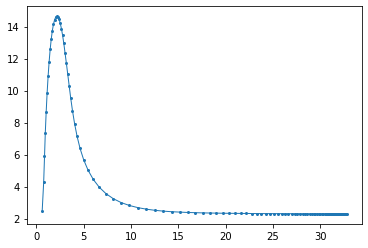

A_m is not valid
Simulation took:  0:00:37.241242
Simulation started at:  2020-04-28 00:29:27.407502
a:  0.075 delta_u 0.006 delta_nu 0.025


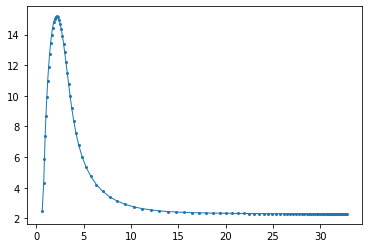

A_m is not valid
Simulation took:  0:00:37.390042
Simulation started at:  2020-04-28 00:30:04.818182
a:  0.1 delta_u 0.006 delta_nu 0.025


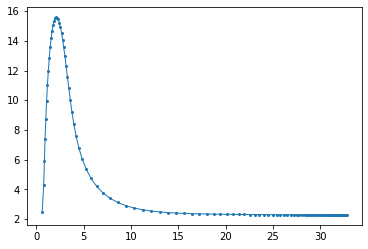

A_m is not valid
Simulation took:  0:00:38.134636
Simulation started at:  2020-04-28 00:30:42.989520
a:  0.005 delta_u 0.006 delta_nu 0.025


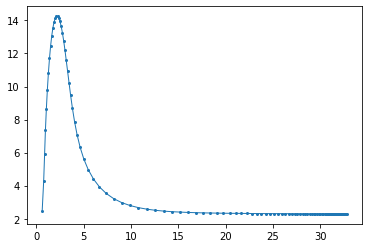

A_m is not valid
Simulation took:  0:00:37.550147
Simulation started at:  2020-04-28 00:31:20.556686
a:  0.035 delta_u 0.006 delta_nu 0.025


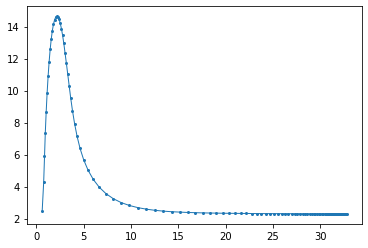

A_m is not valid
Simulation took:  0:00:37.597468
Simulation started at:  2020-04-28 00:31:58.169654
a:  0.075 delta_u 0.006 delta_nu 0.025


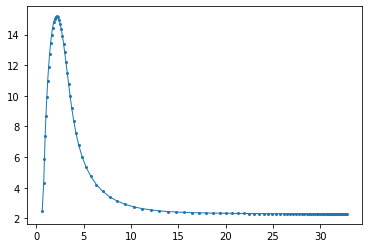

A_m is not valid
Simulation took:  0:00:38.386026
Simulation started at:  2020-04-28 00:32:36.580156
a:  0.1 delta_u 0.006 delta_nu 0.025


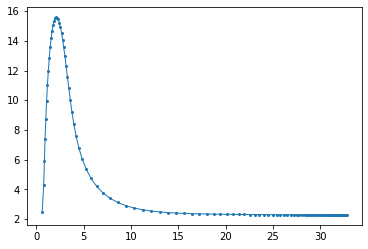

A_m is not valid
Simulation took:  0:00:37.542210
Simulation started at:  2020-04-28 00:33:14.140047
a:  0.005 delta_u 0.006 delta_nu 0.025


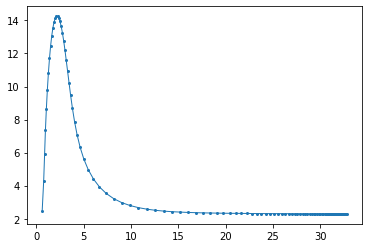

A_m is not valid
Simulation took:  0:00:38.962074
Simulation started at:  2020-04-28 00:33:53.125867
a:  0.035 delta_u 0.006 delta_nu 0.025


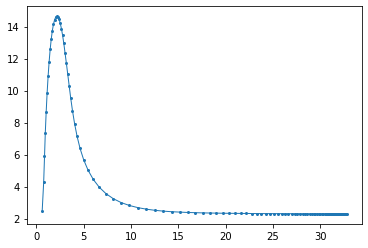

A_m is not valid
Simulation took:  0:00:37.879794
Simulation started at:  2020-04-28 00:34:31.228213
a:  0.075 delta_u 0.006 delta_nu 0.025


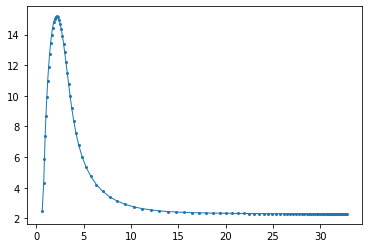

A_m is not valid
Simulation took:  0:00:37.744156
Simulation started at:  2020-04-28 00:35:08.989177
a:  0.1 delta_u 0.006 delta_nu 0.025


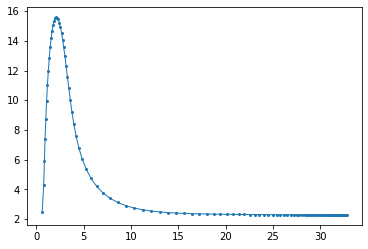

A_m is not valid
Simulation took:  0:00:38.071059
Simulation started at:  2020-04-28 00:35:47.087677
a:  0.005 delta_u 0.006 delta_nu 0.025


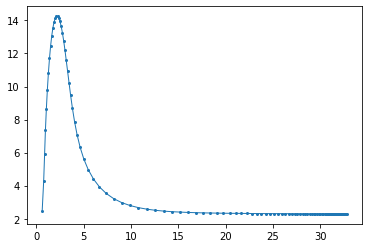

A_m is not valid
Simulation took:  0:00:37.207026
Simulation started at:  2020-04-28 00:36:24.312470
a:  0.035 delta_u 0.006 delta_nu 0.025


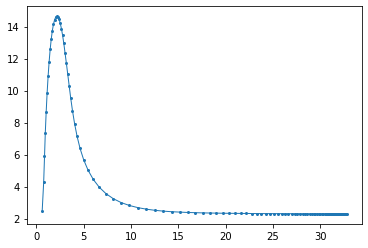

A_m is not valid
Simulation took:  0:00:37.083856
Simulation started at:  2020-04-28 00:37:01.436664
a:  0.075 delta_u 0.006 delta_nu 0.025


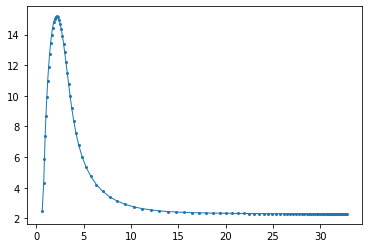

A_m is not valid
Simulation took:  0:00:37.296727
Simulation started at:  2020-04-28 00:37:38.761900
a:  0.1 delta_u 0.006 delta_nu 0.025


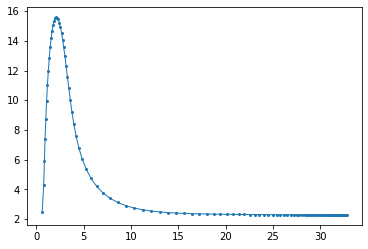

A_m is not valid
Simulation took:  0:00:37.107983
Simulation started at:  2020-04-28 00:38:15.887612
a:  0.005 delta_u 0.02 delta_nu 0.005


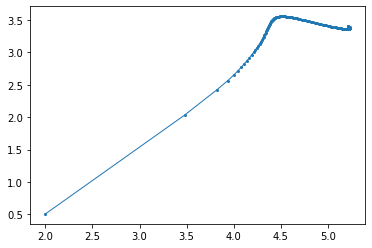

A_m is not valid
Simulation took:  0:00:37.823496
Simulation started at:  2020-04-28 00:38:53.736588
a:  0.035 delta_u 0.02 delta_nu 0.005


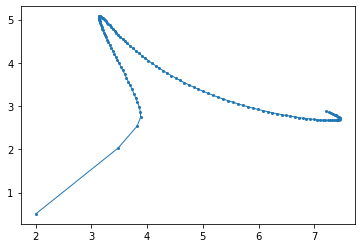

A_m is not valid
Simulation took:  0:00:38.737818
Simulation started at:  2020-04-28 00:39:32.507220
a:  0.075 delta_u 0.02 delta_nu 0.005


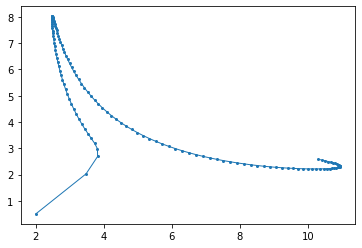

A_m is not valid
Simulation took:  0:00:44.178259
Simulation started at:  2020-04-28 00:40:16.717483
a:  0.1 delta_u 0.02 delta_nu 0.005


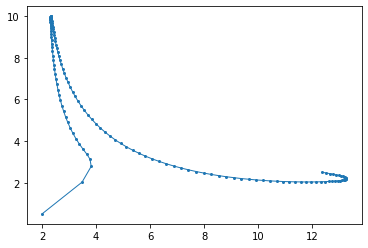

A_m is not valid
Simulation took:  0:00:42.761611
Simulation started at:  2020-04-28 00:40:59.501642
a:  0.005 delta_u 0.02 delta_nu 0.005


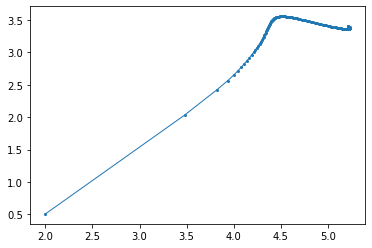

A_m is not valid
Simulation took:  0:00:43.481527
Simulation started at:  2020-04-28 00:41:43.000761
a:  0.035 delta_u 0.02 delta_nu 0.005


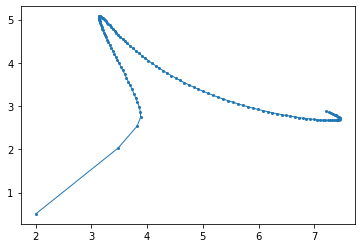

A_m is not valid
Simulation took:  0:00:43.861334
Simulation started at:  2020-04-28 00:42:26.981215
a:  0.075 delta_u 0.02 delta_nu 0.005


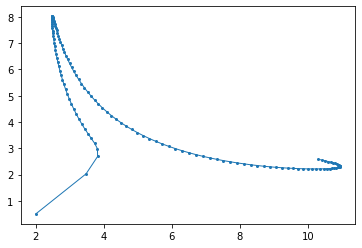

A_m is not valid
Simulation took:  0:00:44.011965
Simulation started at:  2020-04-28 00:43:11.068208
a:  0.1 delta_u 0.02 delta_nu 0.005


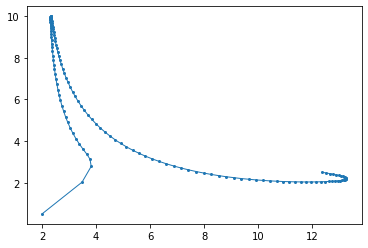

A_m is not valid
Simulation took: 0:00:44.533695
Simulation started at:  2020-04-28 00:43:55.693960
a:  0.005 delta_u 0.02 delta_nu 0.005


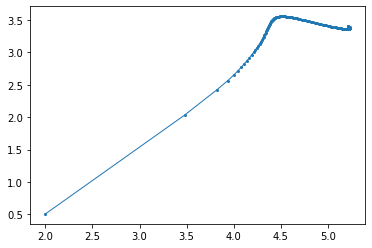

A_m is not valid
Simulation took:  0:00:44.265757
Simulation started at:  2020-04-28 00:44:40.049246
a:  0.035 delta_u 0.02 delta_nu 0.005


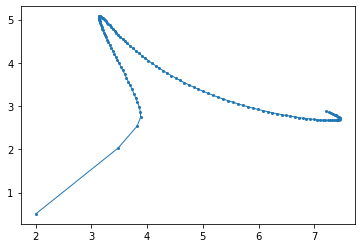

A_m is not valid
Simulation took:  0:00:44.200100
Simulation started at:  2020-04-28 00:45:24.278707
a:  0.075 delta_u 0.02 delta_nu 0.005


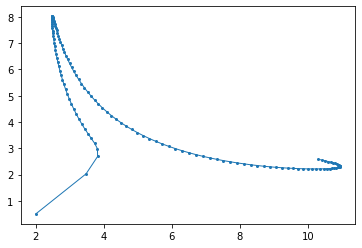

A_m is not valid
Simulation took:  0:00:45.549714
Simulation started at:  2020-04-28 00:46:09.864268
a:  0.1 delta_u 0.02 delta_nu 0.005


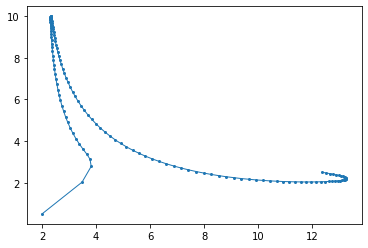

A_m is not valid
Simulation took:  0:00:43.796408
Simulation started at:  2020-04-28 00:46:53.688212
a:  0.005 delta_u 0.02 delta_nu 0.005


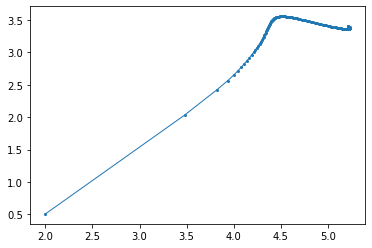

A_m is not valid
Simulation took:  0:00:42.971009
Simulation started at:  2020-04-28 00:47:36.678001
a:  0.035 delta_u 0.02 delta_nu 0.005


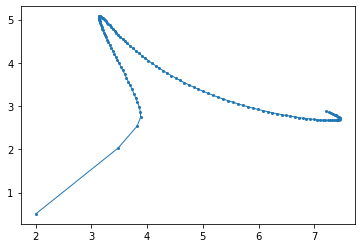

A_m is not valid
Simulation took:  0:00:45.028043
Simulation started at:  2020-04-28 00:48:21.790195
a:  0.075 delta_u 0.02 delta_nu 0.005


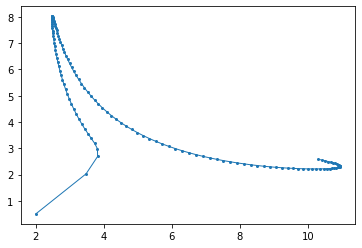

A_m is not valid
Simulation took:  0:00:44.283418
Simulation started at:  2020-04-28 00:49:06.314947
a:  0.1 delta_u 0.02 delta_nu 0.005


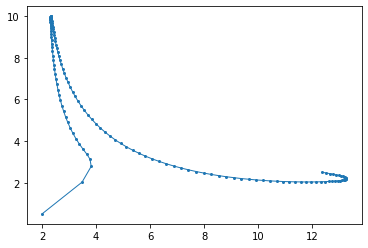

A_m is not valid
Simulation took:0:00:44.197909
Simulation started at:  2020-04-28 00:49:50.637031
a:  0.005 delta_u 0.02 delta_nu 0.015


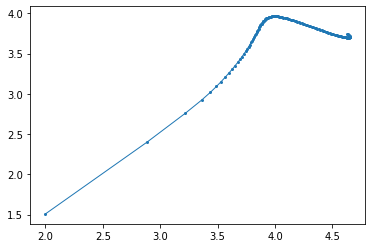

A_m is not valid
Simulation took:  0:00:43.625093
Simulation started at:  2020-04-28 00:50:34.280003
a:  0.035 delta_u 0.02 delta_nu 0.015


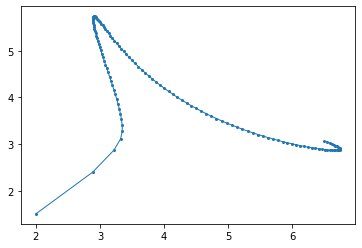

A_m is not valid
Simulation took:  0:00:42.599354
Simulation started at:  2020-04-28 00:51:16.941161
a:  0.075 delta_u 0.02 delta_nu 0.015


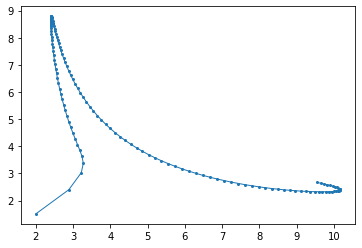

A_m is not valid
Simulation took:  0:00:43.495623
Simulation started at:  2020-04-28 00:52:00.576333
a:  0.1 delta_u 0.02 delta_nu 0.015


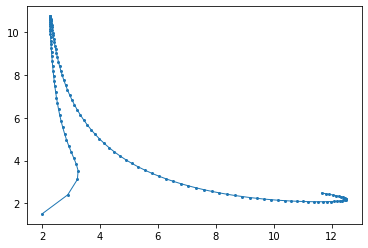

A_m is not valid
Simulation took:  0:00:42.932907
Simulation started at:  2020-04-28 00:52:43.528522
a:  0.005 delta_u 0.02 delta_nu 0.015


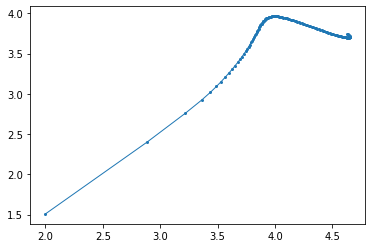

A_m is not valid
Simulation took:  0:00:42.899520
Simulation started at:  2020-04-28 00:53:26.486351
a:  0.035 delta_u 0.02 delta_nu 0.015


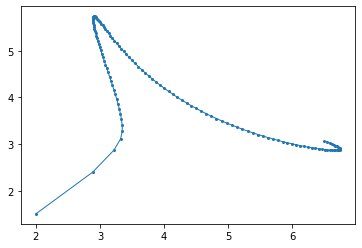

A_m is not valid
Simulation took:  0:00:43.574214
Simulation started at:  2020-04-28 00:54:10.109479
a:  0.075 delta_u 0.02 delta_nu 0.015


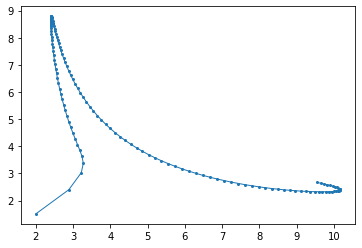

A_m is not valid
Simulation took:  0:00:42.934139
Simulation started at:  2020-04-28 00:54:53.077493
a:  0.1 delta_u 0.02 delta_nu 0.015


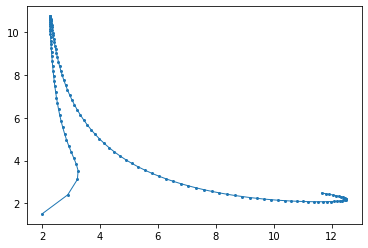

A_m is not valid
Simulation took:  0:00:42.197390
Simulation started at:  2020-04-28 00:55:35.305418
a:  0.005 delta_u 0.02 delta_nu 0.015


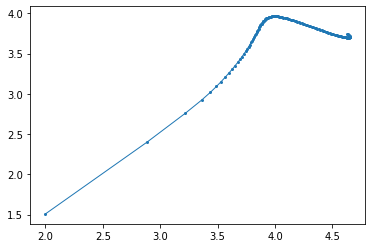

A_m is not valid
Simulation took:  0:00:43.913180
Simulation started at:  2020-04-28 00:56:19.255084
a:  0.035 delta_u 0.02 delta_nu 0.015


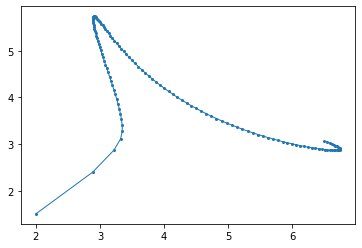

A_m is not valid
Simulation took:  0:00:43.231513
Simulation started at:  2020-04-28 00:57:02.535052
a:  0.075 delta_u 0.02 delta_nu 0.015


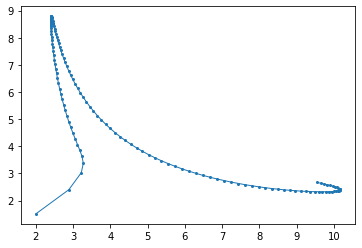

A_m is not valid
Simulation took:  0:00:43.288980
Simulation started at:  2020-04-28 00:57:45.852216
a:  0.1 delta_u 0.02 delta_nu 0.015


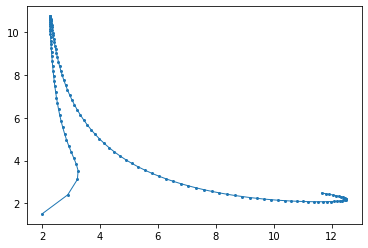

A_m is not valid
Simulation took:  0:00:44.300649
Simulation started at:  2020-04-28 00:58:30.174339
a:  0.005 delta_u 0.02 delta_nu 0.015


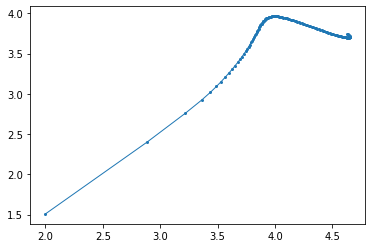

A_m is not valid
Simulation took:  0:00:43.672840
Simulation started at:  2020-04-28 00:59:13.888286
a:  0.035 delta_u 0.02 delta_nu 0.015


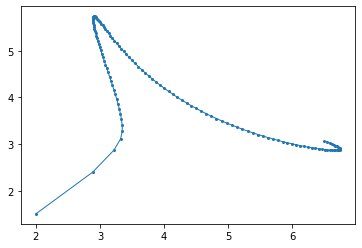

A_m is not valid
Simulation took:  0:00:41.534569
Simulation started at:  2020-04-28 00:59:55.487041
a:  0.075 delta_u 0.02 delta_nu 0.015


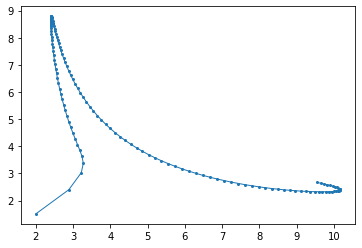

A_m is not valid
Simulation took:  0:00:43.834718
Simulation started at:2020-04-28 01:00:39.354130
a:  0.1 delta_u 0.02 delta_nu 0.015


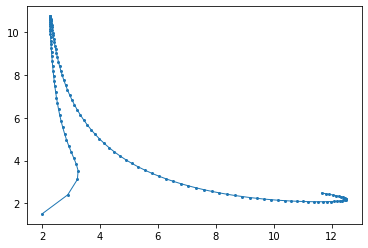

A_m is not valid
Simulation took:  0:00:42.697194
Simulation started at:  2020-04-28 01:01:22.085732
a:  0.005 delta_u 0.02 delta_nu 0.025


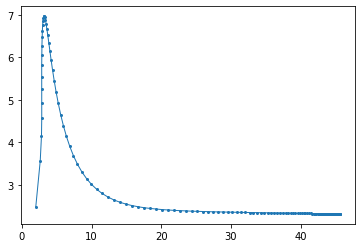

A_m is not valid
Simulation took:  0:00:43.694479
Simulation started at:  2020-04-28 01:02:05.843367
a:  0.035 delta_u 0.02 delta_nu 0.025


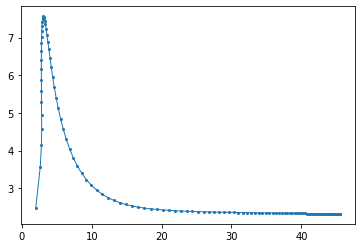

A_m is not valid
Simulation took:  0:00:43.524016
Simulation started at:  2020-04-28 01:02:49.395487
a:  0.075 delta_u 0.02 delta_nu 0.025


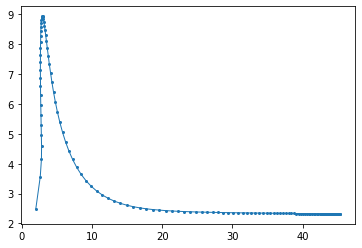

A_m is not valid
Simulation took:  0:00:41.348700
Simulation started at:  2020-04-28 01:03:30.781539
a:  0.1 delta_u 0.02 delta_nu 0.025


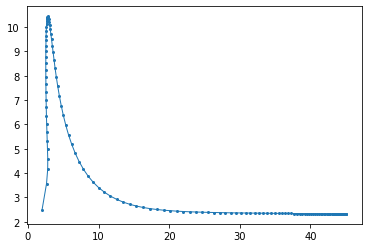

A_m is not valid
Simulation took:  0:00:41.753278
Simulation started at:  2020-04-28 01:04:12.552173
a:  0.005 delta_u 0.02 delta_nu 0.025


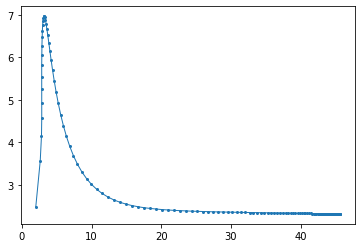

A_m is not valid
Simulation took:  0:00:42.275048
Simulation started at:  2020-04-28 01:04:54.846503
a:  0.035 delta_u 0.02 delta_nu 0.025


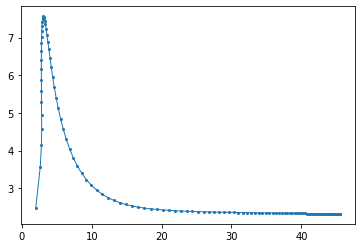

A_m is not valid
Simulation took:  0:00:43.006538
Simulation started at:  2020-04-28 01:05:37.879193
a:  0.075 delta_u 0.02 delta_nu 0.025


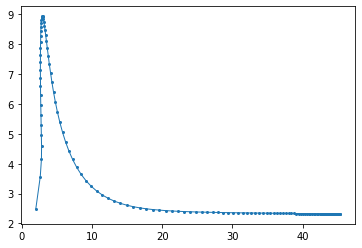

A_m is not valid
Simulation took:  0:00:42.063168
Simulation started at:  2020-04-28 01:06:19.963185
a:  0.1 delta_u 0.02 delta_nu 0.025


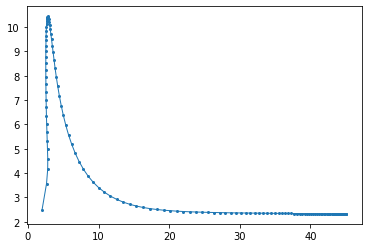

A_m is not valid
Simulation took:  0:00:41.801090
Simulation started at:  2020-04-28 01:07:01.783278
a:  0.005 delta_u 0.02 delta_nu 0.025


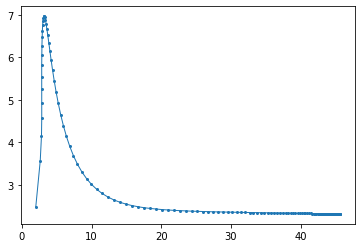

A_m is not valid
Simulation took:  0:00:41.616795
Simulation started at:  2020-04-28 01:07:43.417328
a:  0.035 delta_u 0.02 delta_nu 0.025


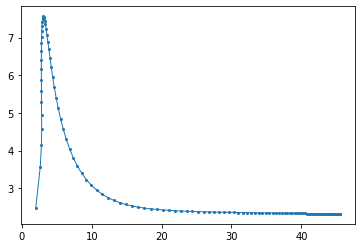

A_m is not valid
Simulation took:  0:00:41.226836
Simulation started at:  2020-04-28 01:08:24.663892
a:  0.075 delta_u 0.02 delta_nu 0.025


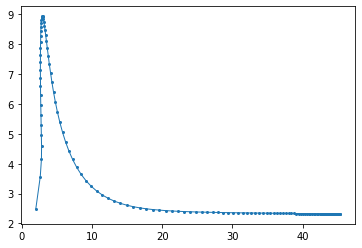

A_m is not valid
Simulation took:  0:00:42.377277
Simulation started at:  2020-04-28 01:09:07.058826
a:  0.1 delta_u 0.02 delta_nu 0.025


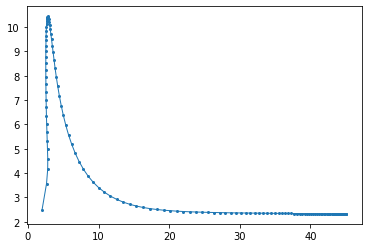

A_m is not valid
Simulation took:  0:00:42.882404
Simulation started at:  2020-04-28 01:09:49.965553
a:  0.005 delta_u 0.02 delta_nu 0.025


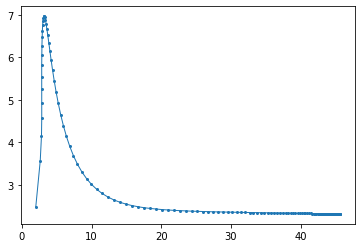

A_m is not valid
Simulation took:  0:00:40.525332
Simulation started at:  2020-04-28 01:10:30.507077
a:  0.035 delta_u 0.02 delta_nu 0.025


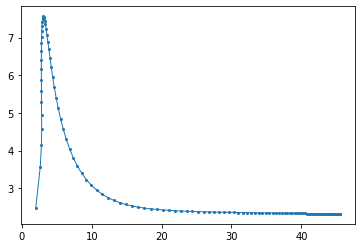

A_m is not valid
Simulation took:  0:00:37.550802
Simulation started at:  2020-04-28 01:11:08.094017
a:  0.075 delta_u 0.02 delta_nu 0.025


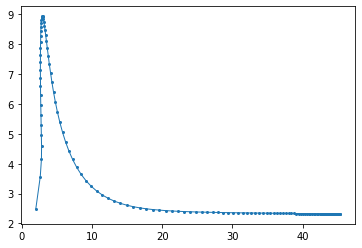

A_m is not valid
Simulation took:  0:00:37.679095
Simulation started at:  2020-04-28 01:11:45.790884
a:  0.1 delta_u 0.02 delta_nu 0.025


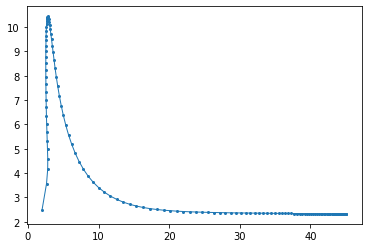

A_m is not valid
Simulation took:  0:00:37.577037
Simulation started at:  2020-04-28 01:12:23.392669
a:  0.005 delta_u 0.05 delta_nu 0.005


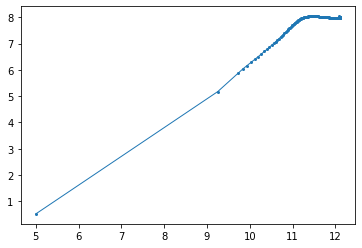

A_m is not valid
Simulation took:  0:00:37.271940
Simulation started at:  2020-04-28 01:13:00.686269
a:  0.035 delta_u 0.05 delta_nu 0.005


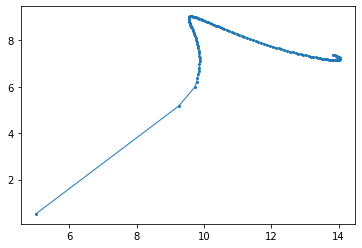

A_m is not valid
Simulation took:  0:00:38.193127
Simulation started at:  2020-04-28 01:13:38.898223
a:  0.075 delta_u 0.05 delta_nu 0.005


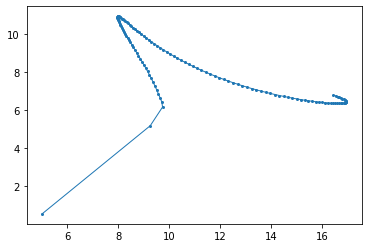

A_m is not valid
Simulation took:  0:00:37.274811
Simulation started at:  2020-04-28 01:14:16.194531
a:  0.1 delta_u 0.05 delta_nu 0.005


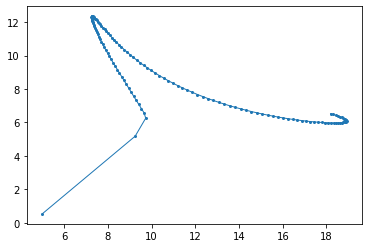

A_m is not valid
Simulation took:  0:00:37.198966
Simulation started at:  2020-04-28 01:14:53.410129
a:  0.005 delta_u 0.05 delta_nu 0.005


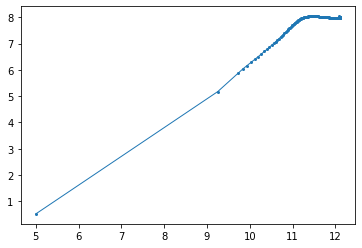

A_m is not valid
Simulation took:  0:00:37.615201
Simulation started at:  2020-04-28 01:15:31.045668
a:  0.035 delta_u 0.05 delta_nu 0.005


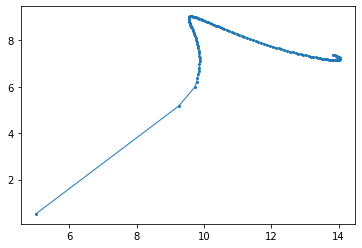

A_m is not valid
Simulation took:  0:00:38.444496
Simulation started at:  2020-04-28 01:16:09.507820
a:  0.075 delta_u 0.05 delta_nu 0.005


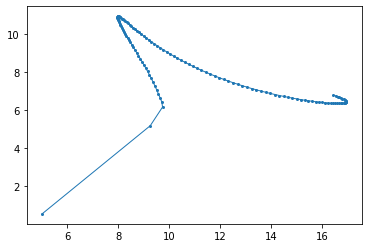

A_m is not valid
Simulation took:  0:00:37.963238
Simulation started at:  2020-04-28 01:16:47.490379
a:  0.1 delta_u 0.05 delta_nu 0.005


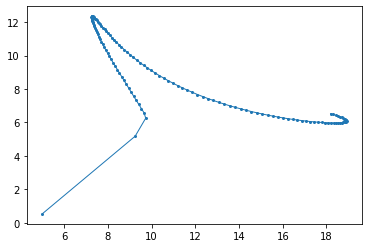

A_m is not valid
Simulation took:  0:00:37.511129
Simulation started at:  2020-04-28 01:17:25.059203
a:  0.005 delta_u 0.05 delta_nu 0.005


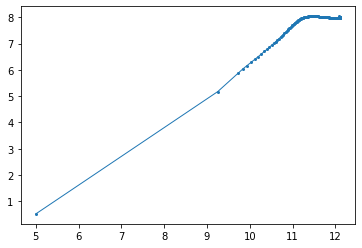

A_m is not valid
Simulation took:  0:00:38.221248
Simulation started at:  2020-04-28 01:18:03.306625
a:  0.035 delta_u 0.05 delta_nu 0.005


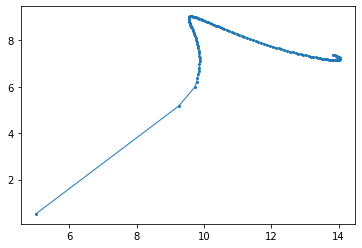

A_m is not valid
Simulation took:  0:00:38.048592
Simulation started at:  2020-04-28 01:18:41.373382
a:  0.075 delta_u 0.05 delta_nu 0.005


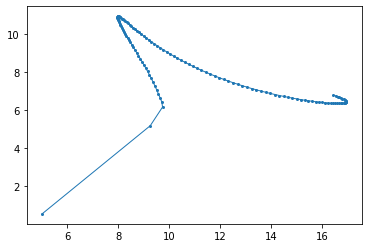

A_m is not valid
Simulation took:  0:00:38.206827
Simulation started at:  2020-04-28 01:19:19.597108
a:  0.1 delta_u 0.05 delta_nu 0.005


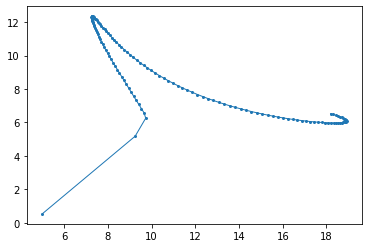

A_m is not valid
Simulation took:  0:00:38.529793
Simulation started at:  2020-04-28 01:19:58.141632
a:  0.005 delta_u 0.05 delta_nu 0.005


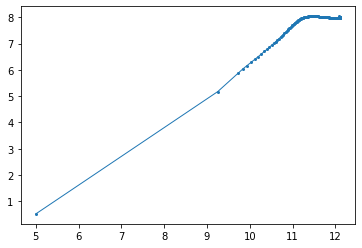

A_m is not valid
Simulation took:  0:00:38.482325
Simulation started at:  2020-04-28 01:20:36.722486
a:  0.035 delta_u 0.05 delta_nu 0.005


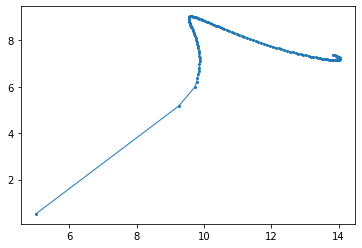

A_m is not valid
Simulation took:  0:00:37.916786
Simulation started at:  2020-04-28 01:21:14.659798
a:  0.075 delta_u 0.05 delta_nu 0.005


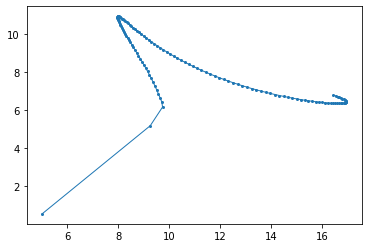

A_m is not valid
Simulation took:  0:00:37.948277
Simulation started at:  2020-04-28 01:21:52.623989
a:  0.1 delta_u 0.05 delta_nu 0.005


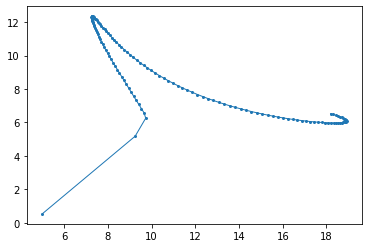

A_m is not valid
Simulation took:  0:00:38.163559
Simulation started at:  2020-04-28 01:22:30.819559
a:  0.005 delta_u 0.05 delta_nu 0.015


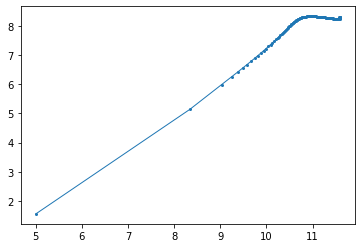

A_m is not valid
Simulation took:  0:00:38.117445
Simulation started at:  2020-04-28 01:23:08.952224
a:  0.035 delta_u 0.05 delta_nu 0.015


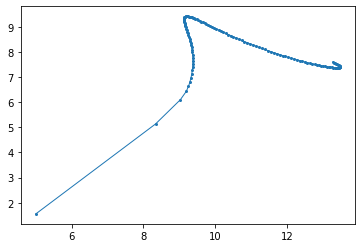

A_m is not valid
Simulation took:  0:00:37.907472
Simulation started at:  2020-04-28 01:23:46.880966
a:  0.075 delta_u 0.05 delta_nu 0.015


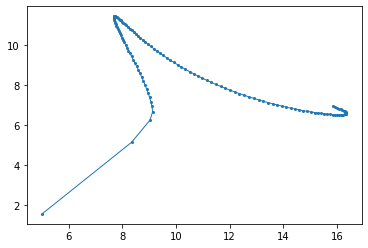

A_m is not valid
Simulation took:  0:00:38.237696
Simulation started at:  2020-04-28 01:24:25.141257
a:  0.1 delta_u 0.05 delta_nu 0.015


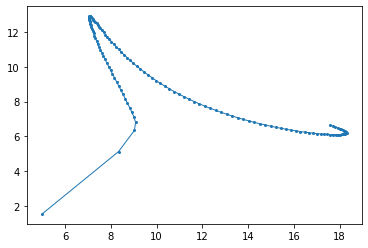

A_m is not valid
Simulation took:  0:00:37.228531
Simulation started at:  2020-04-28 01:25:02.384783
a:  0.005 delta_u 0.05 delta_nu 0.015


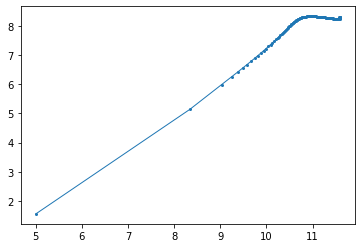

A_m is not valid
Simulation took:  0:00:37.317883
Simulation started at:  2020-04-28 01:25:39.718501
a:  0.035 delta_u 0.05 delta_nu 0.015


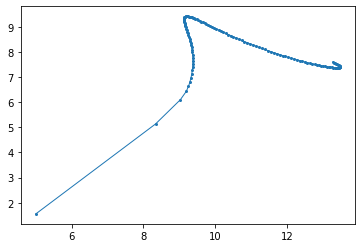

A_m is not valid
Simulation took:  0:00:36.973561
Simulation started at:  2020-04-28 01:26:16.712278
a:  0.075 delta_u 0.05 delta_nu 0.015


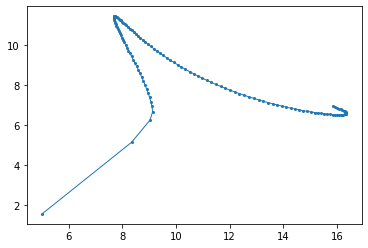

A_m is not valid
Simulation took:  0:00:37.106378
Simulation started at:  2020-04-28 01:26:53.838083
a:  0.1 delta_u 0.05 delta_nu 0.015


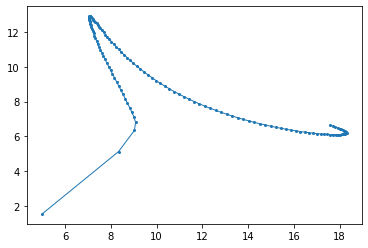

A_m is not valid
Simulation took:  0:00:36.790693
Simulation started at:  2020-04-28 01:27:30.645792
a:  0.005 delta_u 0.05 delta_nu 0.015


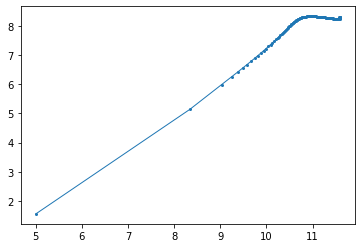

A_m is not valid
Simulation took:  0:00:37.391762
Simulation started at:  2020-04-28 01:28:08.053931
a:  0.035 delta_u 0.05 delta_nu 0.015


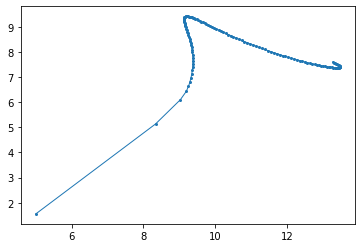

A_m is not valid
Simulation took:  0:00:37.880399
Simulation started at:  2020-04-28 01:28:45.950097
a:  0.075 delta_u 0.05 delta_nu 0.015


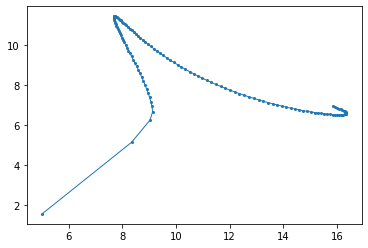

A_m is not valid
Simulation took:  0:00:37.240976
Simulation started at:  2020-04-28 01:29:23.208771
a:  0.1 delta_u 0.05 delta_nu 0.015


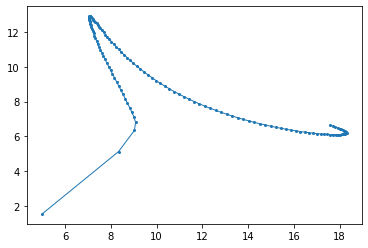

A_m is not valid
Simulation took:  0:00:37.525763
Simulation started at:  2020-04-28 01:30:00.779940
a:  0.005 delta_u 0.05 delta_nu 0.015


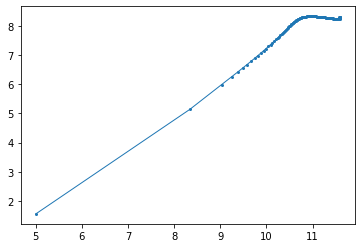

A_m is not valid
Simulation took:  0:00:37.804286
Simulation started at:  2020-04-28 01:30:38.599871
a:  0.035 delta_u 0.05 delta_nu 0.015


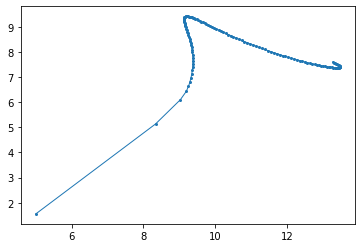

A_m is not valid
Simulation took:  0:00:37.548059
Simulation started at:  2020-04-28 01:31:16.168492
a:  0.075 delta_u 0.05 delta_nu 0.015


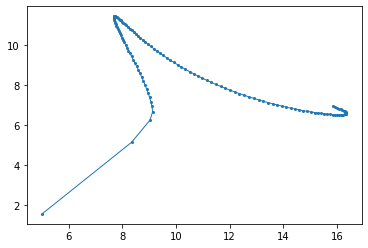

A_m is not valid
Simulation took:  0:00:37.922125
Simulation started at:  2020-04-28 01:31:54.126494
a:  0.1 delta_u 0.05 delta_nu 0.015


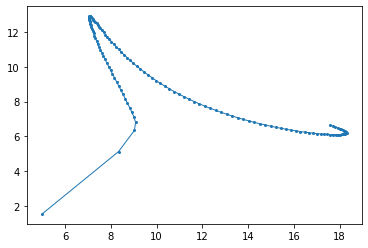

A_m is not valid
Simulation took:  0:00:38.635986
Simulation started at:  2020-04-28 01:32:32.783334
a:  0.005 delta_u 0.05 delta_nu 0.025


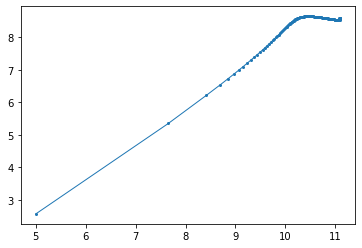

A_m is not valid
Simulation took:  0:00:43.641710
Simulation started at:  2020-04-28 01:33:16.477969
a:  0.035 delta_u 0.05 delta_nu 0.025


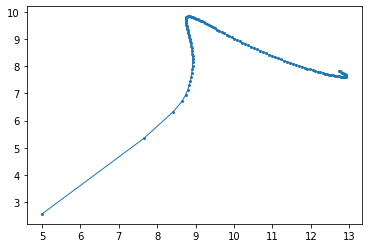

A_m is not valid
Simulation took:  0:00:57.866640
Simulation started at:  2020-04-28 01:34:14.641128
a:  0.075 delta_u 0.05 delta_nu 0.025


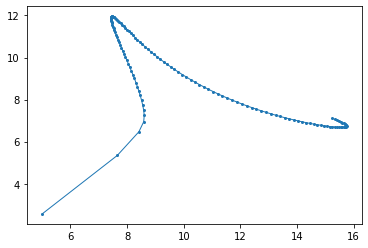

A_m is not valid
Simulation took: 0:01:32.638667
Simulation started at:  2020-04-28 01:35:47.342338
a:  0.1 delta_u 0.05 delta_nu 0.025


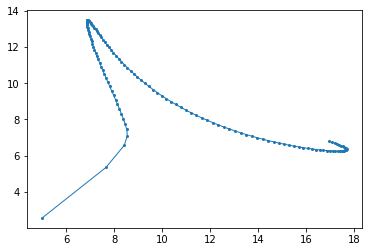

A_m is not valid
Simulation took:  0:02:00.065123
Simulation started at:  2020-04-28 01:37:47.523073
a:  0.005 delta_u 0.05 delta_nu 0.025


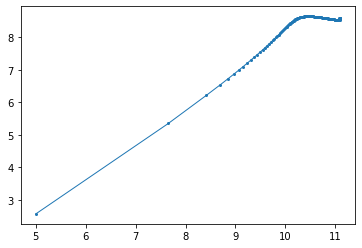

A_m is not valid
Simulation took:  0:02:10.182732
Simulation started at:  2020-04-28 01:39:57.787052
a:  0.035 delta_u 0.05 delta_nu 0.025


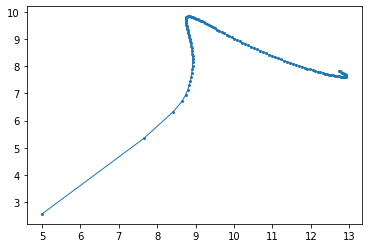

A_m is not valid
Simulation took:  0:04:21.647386
Simulation started at:  2020-04-28 01:44:19.659413
a:  0.075 delta_u 0.05 delta_nu 0.025


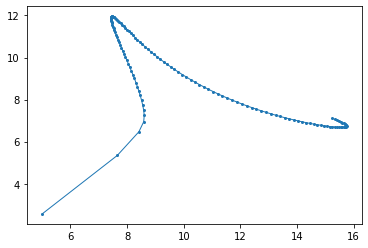

A_m is not valid
Simulation took:  0:04:45.143849
Simulation started at:  2020-04-28 01:49:05.060152
a:  0.1 delta_u 0.05 delta_nu 0.025


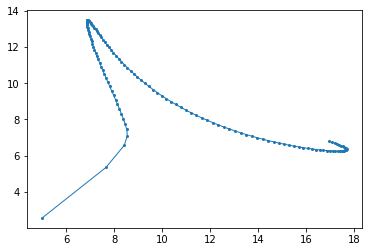

A_m is not valid
Simulation took:  5:26:58.695463
Simulation started at:  2020-04-28 07:16:03.940282
a:  0.005 delta_u 0.05 delta_nu 0.025


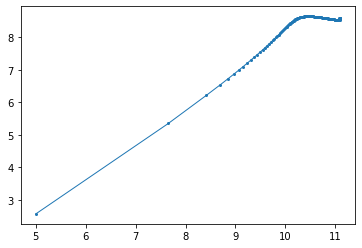

A_m is not valid
Simulation took:  0:35:57.742811
Simulation started at:  2020-04-28 07:52:01.699287
a:  0.035 delta_u 0.05 delta_nu 0.025


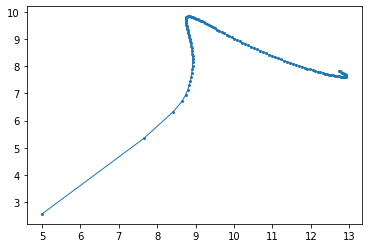

A_m is not valid
Simulation took:  0:08:35.182466
Simulation started at:  2020-04-28 08:00:36.906649
a:  0.075 delta_u 0.05 delta_nu 0.025


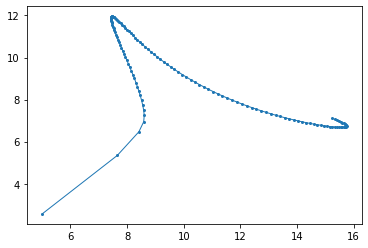

A_m is not valid
Simulation took:  0:00:41.766587
Simulation started at:  2020-04-28 08:01:18.689005
a:  0.1 delta_u 0.05 delta_nu 0.025


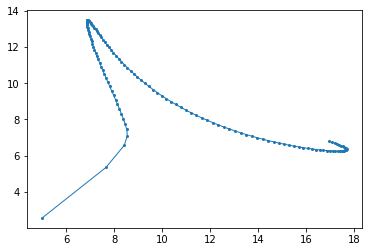

A_m is not valid
Simulation took:  0:00:36.530145
Simulation started at:  2020-04-28 08:01:55.235908
a:  0.005 delta_u 0.05 delta_nu 0.025


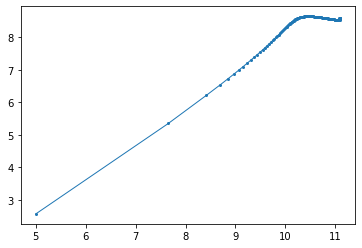

A_m is not valid
Simulation took:  0:00:37.038990
Simulation started at:  2020-04-28 08:02:32.291853
a:  0.035 delta_u 0.05 delta_nu 0.025


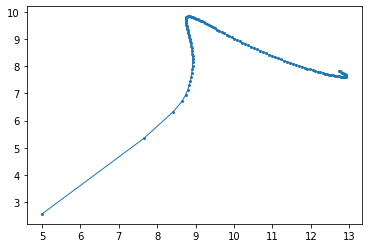

A_m is not valid
Simulation took:  0:00:37.172546
Simulation started at:  2020-04-28 08:03:09.481493
a:  0.075 delta_u 0.05 delta_nu 0.025


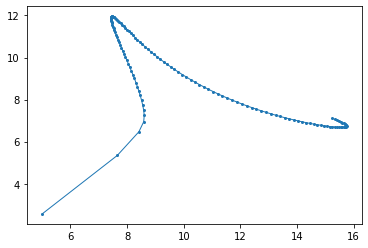

A_m is not valid
Simulation took:  0:00:37.479060
Simulation started at:  2020-04-28 08:03:46.989217
a:  0.1 delta_u 0.05 delta_nu 0.025


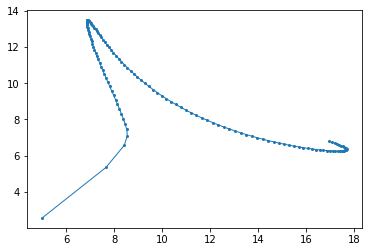

A_m is not valid
Simulation took:  0:00:43.696475
Simulation started at:  2020-04-28 08:04:30.728062
a:  0.005 delta_u 0.006 delta_nu 0.005


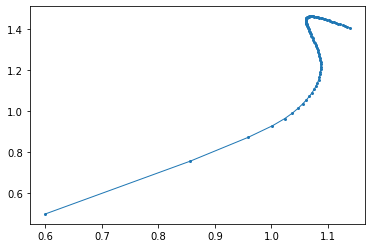

A_m is not valid
Simulation took:  0:00:30.383836
Simulation started at:  2020-04-28 08:05:01.126566
a:  0.035 delta_u 0.006 delta_nu 0.005


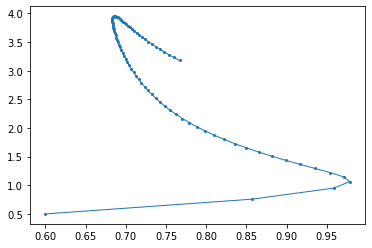

A_m is not valid
Simulation took:  0:00:26.254599
Simulation started at:  2020-04-28 08:05:27.397787
a:  0.075 delta_u 0.006 delta_nu 0.005


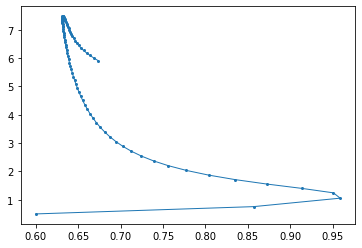

A_m is not valid
Simulation took:  0:00:25.852152
Simulation started at:  2020-04-28 08:05:53.287044
a:  0.1 delta_u 0.006 delta_nu 0.005


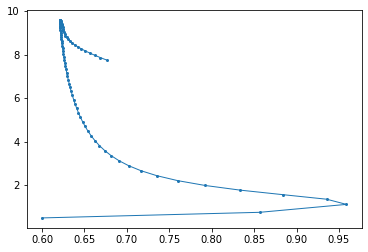

A_m is not valid
Simulation took:  0:00:25.962784
Simulation started at:  2020-04-28 08:06:19.271917
a:  0.005 delta_u 0.006 delta_nu 0.005


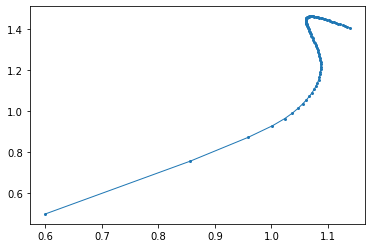

A_m is not valid
Simulation took:  0:00:26.127813
Simulation started at:  2020-04-28 08:06:45.416138
a:  0.035 delta_u 0.006 delta_nu 0.005


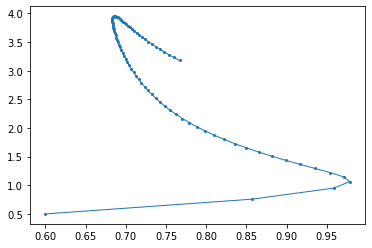

A_m is not valid
Simulation took:  0:00:26.050727
Simulation started at:  2020-04-28 08:07:11.481786
a:  0.075 delta_u 0.006 delta_nu 0.005


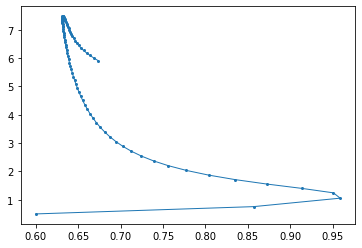

A_m is not valid
Simulation took:  0:00:25.977370
Simulation started at:  2020-04-28 08:07:37.474682
a:  0.1 delta_u 0.006 delta_nu 0.005


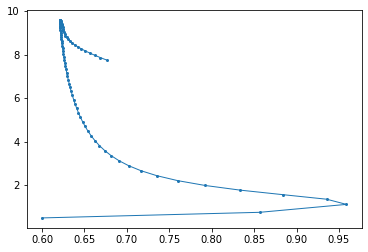

A_m is not valid
Simulation took:  0:00:25.965279
Simulation started at:  2020-04-28 08:08:03.455334
a:  0.005 delta_u 0.006 delta_nu 0.005


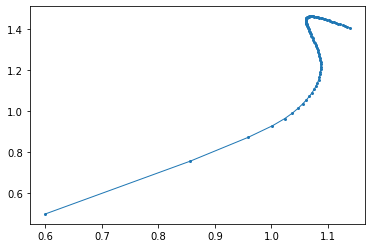

A_m is not valid
Simulation took:  0:00:26.586153
Simulation started at:  2020-04-28 08:08:30.056409
a:  0.035 delta_u 0.006 delta_nu 0.005


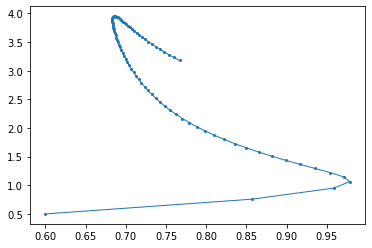

A_m is not valid
Simulation took:  0:00:26.531527
Simulation started at:  2020-04-28 08:08:56.601979
a:  0.075 delta_u 0.006 delta_nu 0.005


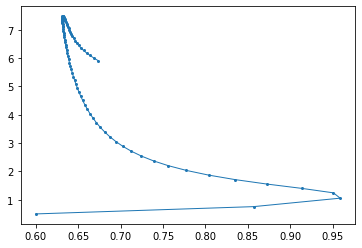

A_m is not valid
Simulation took:  0:00:26.547951
Simulation started at:  2020-04-28 08:09:23.168959
a:  0.1 delta_u 0.006 delta_nu 0.005


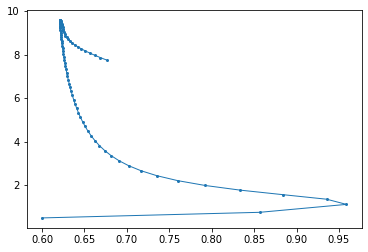

A_m is not valid
Simulation took:  0:00:26.214195
Simulation started at:  2020-04-28 08:09:49.399650
a:  0.005 delta_u 0.006 delta_nu 0.005


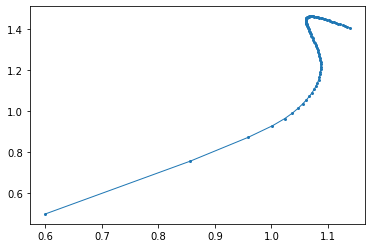

A_m is not valid
Simulation took:  0:00:26.107935
Simulation started at:  2020-04-28 08:10:15.540752
a:  0.035 delta_u 0.006 delta_nu 0.005


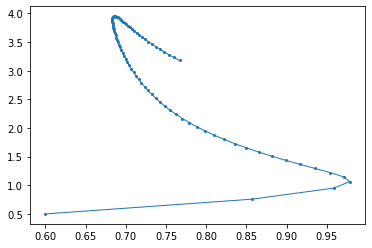

A_m is not valid
Simulation took:  0:00:26.214508
Simulation started at:  2020-04-28 08:10:41.778283
a:  0.075 delta_u 0.006 delta_nu 0.005


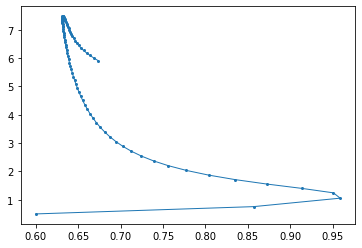

A_m is not valid
Simulation took:  0:00:26.169691
Simulation started at:  2020-04-28 08:11:07.971711
a:  0.1 delta_u 0.006 delta_nu 0.005


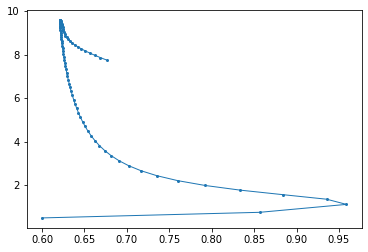

A_m is not valid
Simulation took:  0:00:26.116631
Simulation started at:  2020-04-28 08:11:34.111818
a:  0.005 delta_u 0.006 delta_nu 0.015


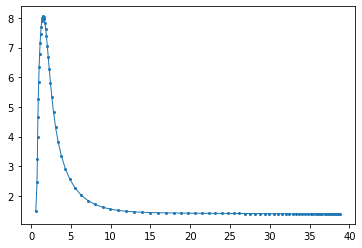

A_m is not valid
Simulation took:  0:00:26.230011
Simulation started at:  2020-04-28 08:12:00.377050
a:  0.035 delta_u 0.006 delta_nu 0.015


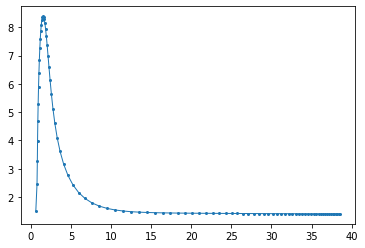

A_m is not valid
Simulation took:  0:00:26.085685
Simulation started at:  2020-04-28 08:12:26.478787
a:  0.075 delta_u 0.006 delta_nu 0.015


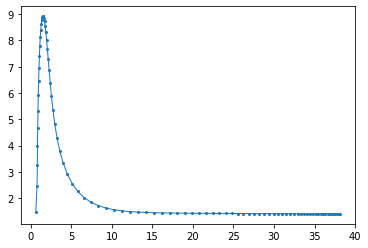

A_m is not valid
Simulation took:  0:00:26.203169
Simulation started at:  2020-04-28 08:12:52.697735
a:  0.1 delta_u 0.006 delta_nu 0.015


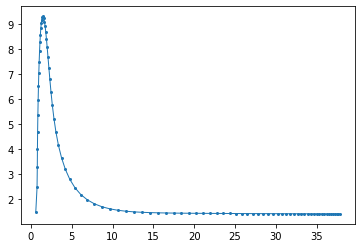

A_m is not valid
Simulation took:  0:00:26.410692
Simulation started at:  2020-04-28 08:13:19.123020
a:  0.005 delta_u 0.006 delta_nu 0.015


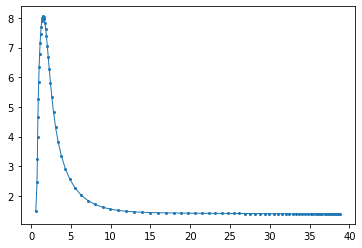

A_m is not valid
Simulation took:  0:00:26.221184
Simulation started at:  2020-04-28 08:13:45.378891
a:  0.035 delta_u 0.006 delta_nu 0.015


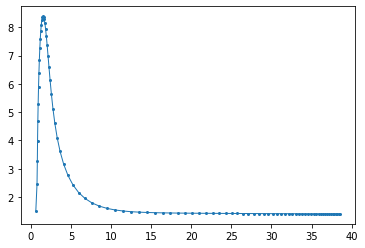

A_m is not valid
Simulation took:  0:00:26.256487
Simulation started at:  2020-04-28 08:14:11.649942
a:  0.075 delta_u 0.006 delta_nu 0.015


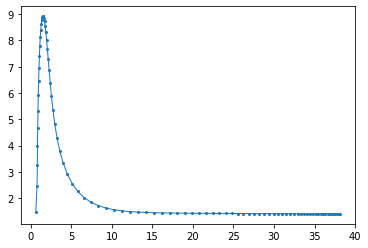

A_m is not valid
Simulation took:  0:00:26.618893
Simulation started at:  2020-04-28 08:14:38.284797
a:  0.1 delta_u 0.006 delta_nu 0.015


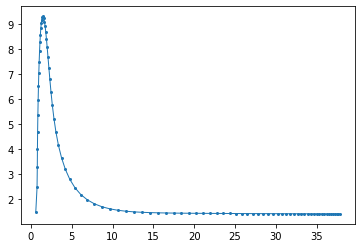

A_m is not valid
Simulation took:  0:00:26.163882
Simulation started at:  2020-04-28 08:15:04.464094
a:  0.005 delta_u 0.006 delta_nu 0.015


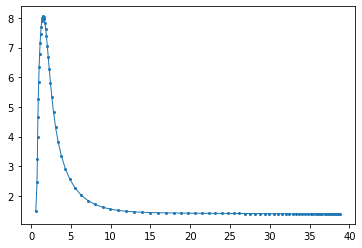

A_m is not valid
Simulation took:  0:00:26.299353
Simulation started at:  2020-04-28 08:15:30.778565
a:  0.035 delta_u 0.006 delta_nu 0.015


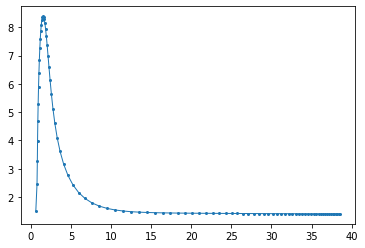

A_m is not valid
Simulation took:  0:00:26.446158
Simulation started at:  2020-04-28 08:15:57.239593
a:  0.075 delta_u 0.006 delta_nu 0.015


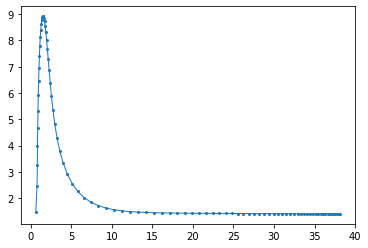

A_m is not valid
Simulation took:  0:00:26.705193
Simulation started at:  2020-04-28 08:16:23.960453
a:  0.1 delta_u 0.006 delta_nu 0.015


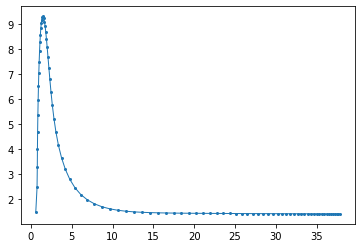

A_m is not valid
Simulation took:  0:00:26.457114
Simulation started at:  2020-04-28 08:16:50.433317
a:  0.005 delta_u 0.006 delta_nu 0.015


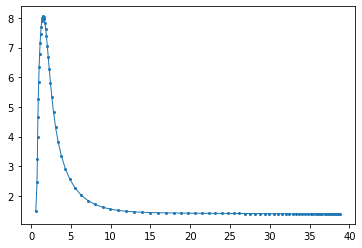

A_m is not valid
Simulation took:  0:00:27.676502
Simulation started at:  2020-04-28 08:17:18.125650
a:  0.035 delta_u 0.006 delta_nu 0.015


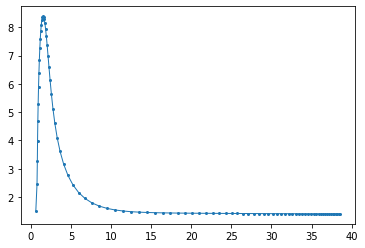

A_m is not valid
Simulation took:  0:00:24.543155
Simulation started at:  2020-04-28 08:17:42.683422
a:  0.075 delta_u 0.006 delta_nu 0.015


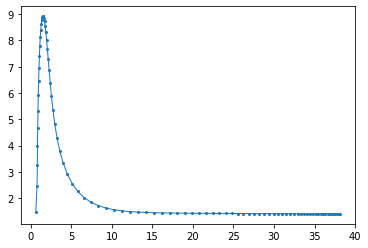

A_m is not valid
Simulation took:  0:00:23.185533
Simulation started at:  2020-04-28 08:18:05.882898
a:  0.1 delta_u 0.006 delta_nu 0.015


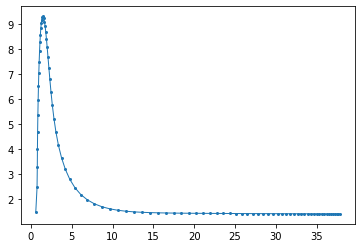

A_m is not valid
Simulation took:  0:00:23.501677
Simulation started at:  2020-04-28 08:18:29.404752
a:  0.005 delta_u 0.006 delta_nu 0.025


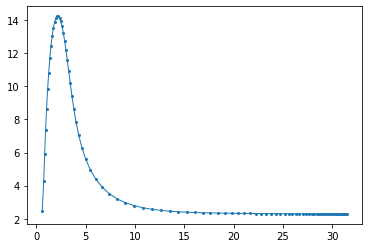

A_m is not valid
Simulation took:  0:00:26.334014
Simulation started at:  2020-04-28 08:18:55.757050
a:  0.035 delta_u 0.006 delta_nu 0.025


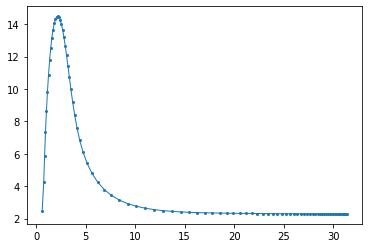

A_m is not valid
Simulation took:  0:00:28.787815
Simulation started at:  2020-04-28 08:19:24.675792
a:  0.075 delta_u 0.006 delta_nu 0.025


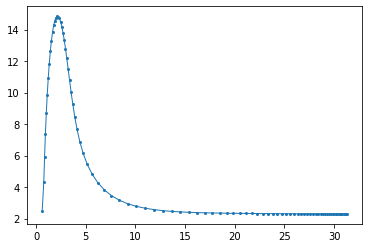

A_m is not valid
Simulation took:  0:00:33.638760
Simulation started at:  2020-04-28 08:19:58.342640
a:  0.1 delta_u 0.006 delta_nu 0.025


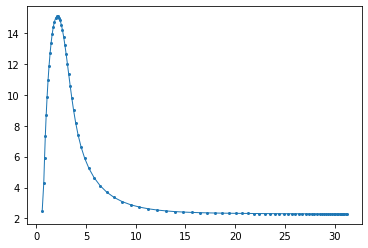

A_m is not valid
Simulation took:  0:00:28.276487
Simulation started at:  2020-04-28 08:20:26.643441
a:  0.005 delta_u 0.006 delta_nu 0.025


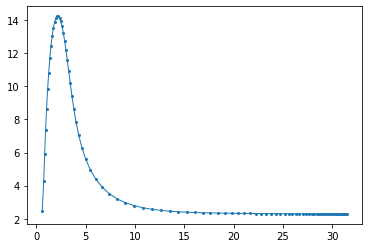

A_m is not valid
Simulation took:  0:00:27.881831
Simulation started at:  2020-04-28 08:20:54.542934
a:  0.035 delta_u 0.006 delta_nu 0.025


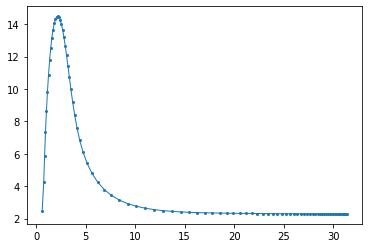

A_m is not valid
Simulation took:  0:00:26.237062
Simulation started at:  2020-04-28 08:21:20.796574
a:  0.075 delta_u 0.006 delta_nu 0.025


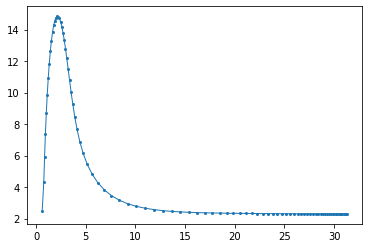

A_m is not valid
Simulation took:  0:00:26.236588
Simulation started at:  2020-04-28 08:21:47.047966
a:  0.1 delta_u 0.006 delta_nu 0.025


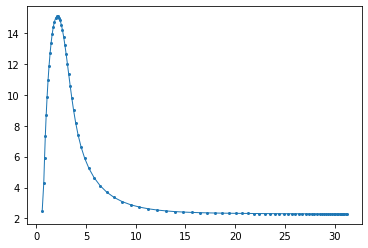

A_m is not valid
Simulation took:  0:00:24.641500
Simulation started at:  2020-04-28 08:22:11.703206
a:  0.005 delta_u 0.006 delta_nu 0.025


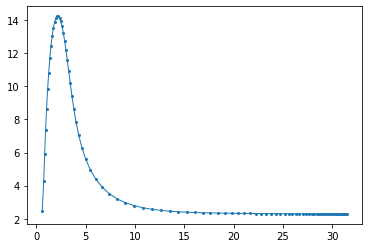

A_m is not valid
Simulation took:  0:00:25.748886
Simulation started at:  2020-04-28 08:22:37.485806
a:  0.035 delta_u 0.006 delta_nu 0.025


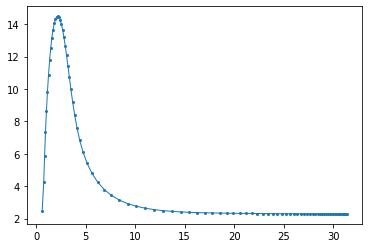

A_m is not valid
Simulation took:  0:00:32.022988
Simulation started at:  2020-04-28 08:23:09.533490
a:  0.075 delta_u 0.006 delta_nu 0.025


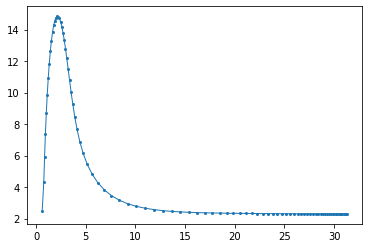

A_m is not valid
Simulation took:  0:00:27.997132
Simulation started at:  2020-04-28 08:23:37.561306
a:  0.1 delta_u 0.006 delta_nu 0.025


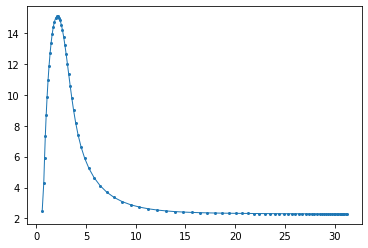

A_m is not valid
Simulation took:  0:00:27.596164
Simulation started at:  2020-04-28 08:24:05.171593
a:  0.005 delta_u 0.006 delta_nu 0.025


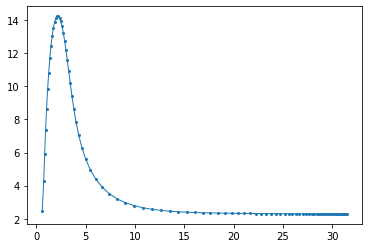

A_m is not valid
Simulation took:  0:00:28.009575
Simulation started at:  2020-04-28 08:24:33.200084
a:  0.035 delta_u 0.006 delta_nu 0.025


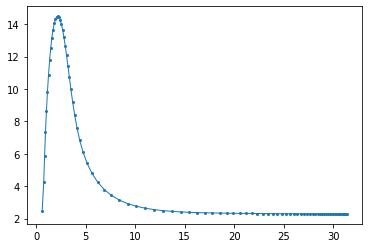

A_m is not valid
Simulation took:  0:00:27.143083
Simulation started at:  2020-04-28 08:25:00.406508
a:  0.075 delta_u 0.006 delta_nu 0.025


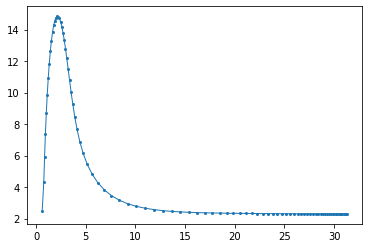

A_m is not valid
Simulation took:  0:00:28.313035
Simulation started at:  2020-04-28 08:25:28.759958
a:  0.1 delta_u 0.006 delta_nu 0.025


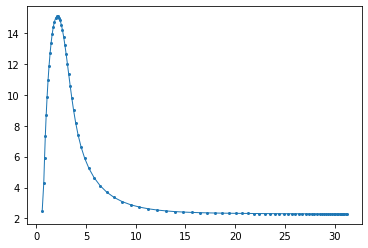

A_m is not valid
Simulation took:  0:00:27.122327
Simulation started at:  2020-04-28 08:25:55.896824
a:  0.005 delta_u 0.02 delta_nu 0.005


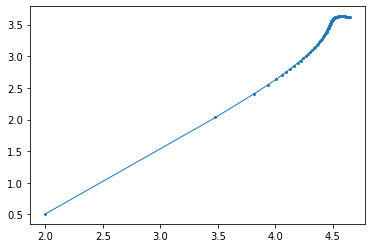

A_m is not valid
Simulation took:  0:00:27.796813
Simulation started at:  2020-04-28 08:26:23.718743
a:  0.035 delta_u 0.02 delta_nu 0.005


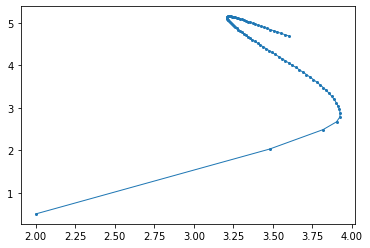

A_m is not valid
Simulation took:  0:00:27.394205
Simulation started at:  2020-04-28 08:26:51.129153
a:  0.075 delta_u 0.02 delta_nu 0.005


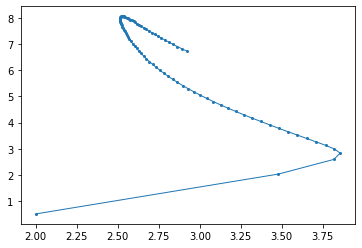

A_m is not valid
Simulation took:  0:00:28.783533
Simulation started at:  2020-04-28 08:27:19.996988
a:  0.1 delta_u 0.02 delta_nu 0.005


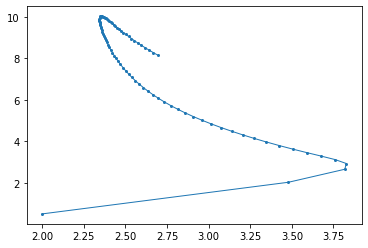

A_m is not valid
Simulation took:  0:00:27.313959
Simulation started at:  2020-04-28 08:27:47.371308
a:  0.005 delta_u 0.02 delta_nu 0.005


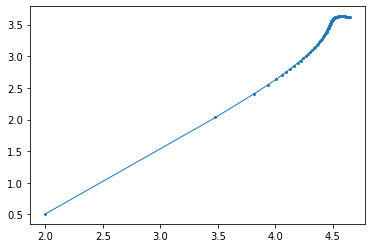

A_m is not valid
Simulation took:  0:00:27.642446
Simulation started at:  2020-04-28 08:28:15.064294
a:  0.035 delta_u 0.02 delta_nu 0.005


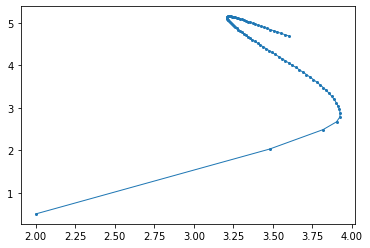

A_m is not valid
Simulation took:  0:00:27.593081
Simulation started at:  2020-04-28 08:28:42.693188
a:  0.075 delta_u 0.02 delta_nu 0.005


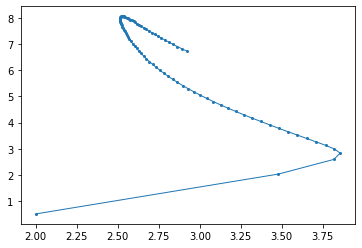

A_m is not valid
Simulation took:  0:00:27.793640
Simulation started at:  2020-04-28 08:29:10.502683
a:  0.1 delta_u 0.02 delta_nu 0.005


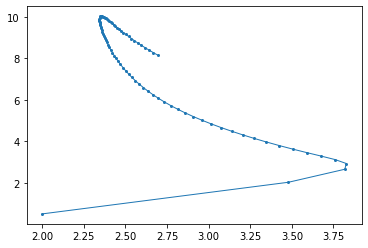

A_m is not valid
Simulation took:  0:00:27.711906
Simulation started at:  2020-04-28 08:29:38.231487
a:  0.005 delta_u 0.02 delta_nu 0.005


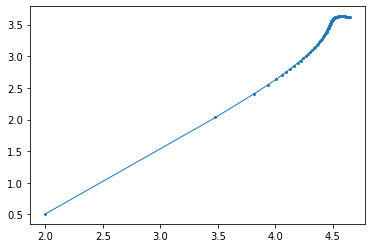

A_m is not valid
Simulation took:  0:00:28.080687
Simulation started at:  2020-04-28 08:30:06.327120
a:  0.035 delta_u 0.02 delta_nu 0.005


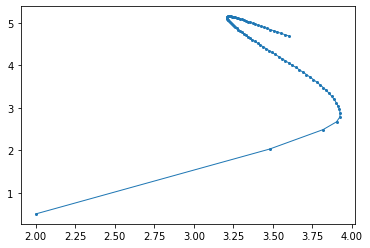

A_m is not valid
Simulation took:  0:00:27.951468
Simulation started at:  2020-04-28 08:30:34.314380
a:  0.075 delta_u 0.02 delta_nu 0.005


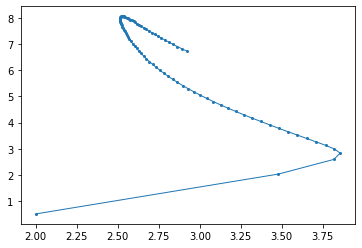

A_m is not valid
Simulation took:  0:00:29.896695
Simulation started at:  2020-04-28 08:31:04.239443
a:  0.1 delta_u 0.02 delta_nu 0.005


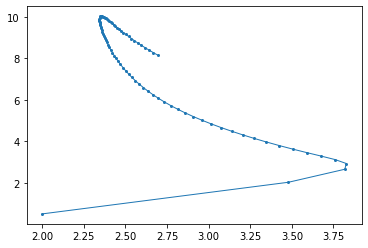

A_m is not valid
Simulation took:  0:00:29.197979
Simulation started at:  2020-04-28 08:31:33.466932
a:  0.005 delta_u 0.02 delta_nu 0.005


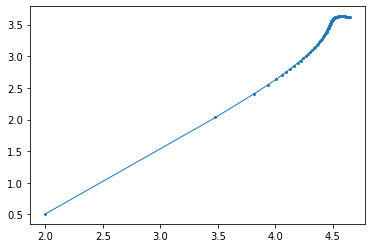

A_m is not valid
Simulation took:  0:00:30.658536
Simulation started at:  2020-04-28 08:32:04.142515
a:  0.035 delta_u 0.02 delta_nu 0.005


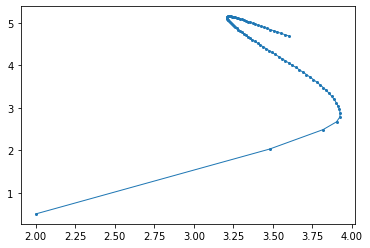

A_m is not valid
Simulation took:  0:00:31.847774
Simulation started at:  2020-04-28 08:32:36.008088
a:  0.075 delta_u 0.02 delta_nu 0.005


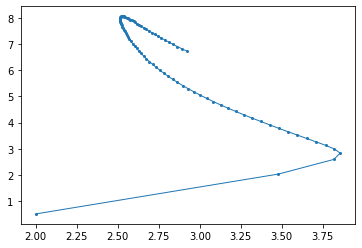

A_m is not valid
Simulation took:  0:00:29.544164
Simulation started at:  2020-04-28 08:33:05.570818
a:  0.1 delta_u 0.02 delta_nu 0.005


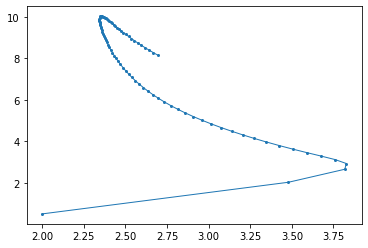

A_m is not valid
Simulation took:  0:00:26.967690
Simulation started at:  2020-04-28 08:33:32.553217
a:  0.005 delta_u 0.02 delta_nu 0.015


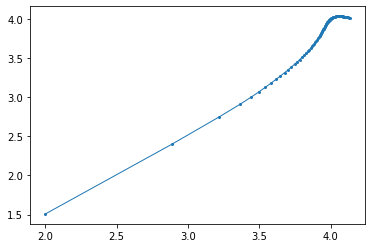

A_m is not valid
Simulation took:  0:00:30.668884
Simulation started at:  2020-04-28 08:34:03.249249
a:  0.035 delta_u 0.02 delta_nu 0.015


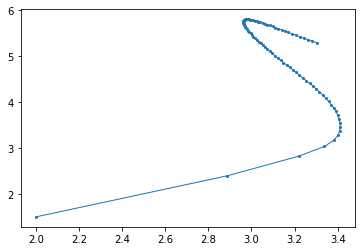

A_m is not valid
Simulation took:  0:00:28.541255
Simulation started at:  2020-04-28 08:34:31.827277
a:  0.075 delta_u 0.02 delta_nu 0.015


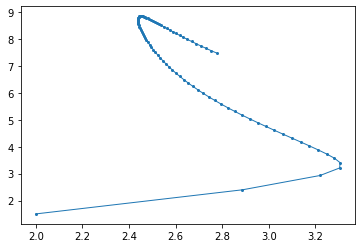

A_m is not valid
Simulation took:  0:00:28.555794
Simulation started at:  2020-04-28 08:35:00.409423
a:  0.1 delta_u 0.02 delta_nu 0.015


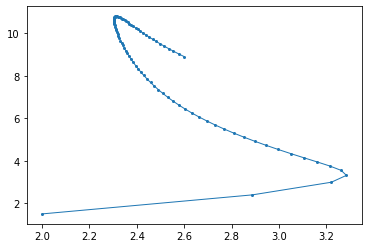

A_m is not valid
Simulation took:  0:00:26.184522
Simulation started at:  2020-04-28 08:35:26.651638
a:  0.005 delta_u 0.02 delta_nu 0.015


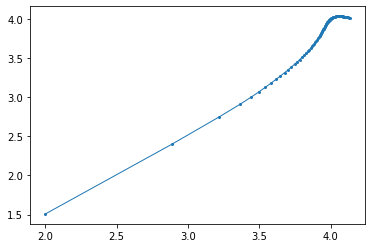

A_m is not valid
Simulation took:  0:00:25.698983
Simulation started at:  2020-04-28 08:35:52.382075
a:  0.035 delta_u 0.02 delta_nu 0.015


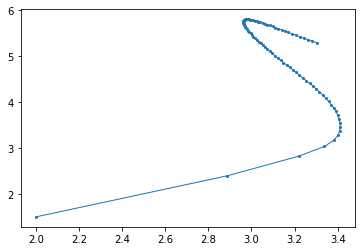

A_m is not valid
Simulation took:  0:00:30.260142
Simulation started at:  2020-04-28 08:36:22.661773
a:  0.075 delta_u 0.02 delta_nu 0.015


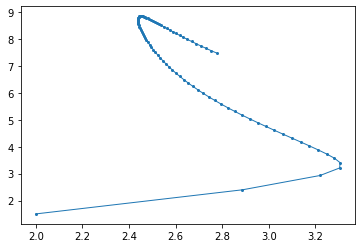

A_m is not valid
Simulation took:  0:00:28.269713
Simulation started at:  2020-04-28 08:36:50.980967
a:  0.1 delta_u 0.02 delta_nu 0.015


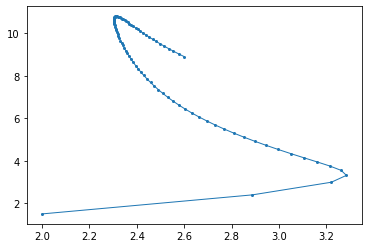

A_m is not valid
Simulation took:  0:00:28.156573
Simulation started at:  2020-04-28 08:37:19.157722
a:  0.005 delta_u 0.02 delta_nu 0.015


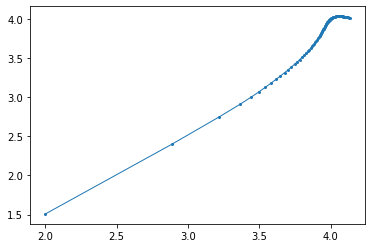

A_m is not valid
Simulation took:  0:00:27.141843
Simulation started at:  2020-04-28 08:37:46.425884
a:  0.035 delta_u 0.02 delta_nu 0.015


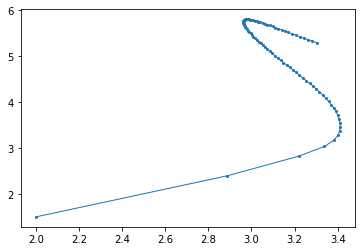

A_m is not valid
Simulation took:  0:00:28.185552
Simulation started at:  2020-04-28 08:38:14.636263
a:  0.075 delta_u 0.02 delta_nu 0.015


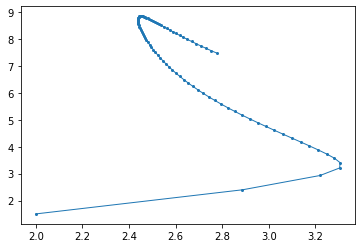

A_m is not valid
Simulation took:  0:00:30.828298
Simulation started at:  2020-04-28 08:38:45.488241
a:  0.1 delta_u 0.02 delta_nu 0.015


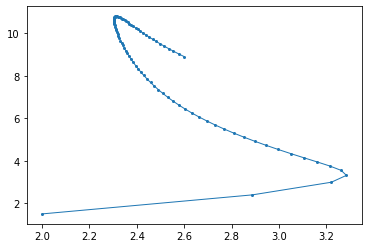

A_m is not valid
Simulation took:  0:00:30.428611
Simulation started at:  2020-04-28 08:39:15.933342
a:  0.005 delta_u 0.02 delta_nu 0.015


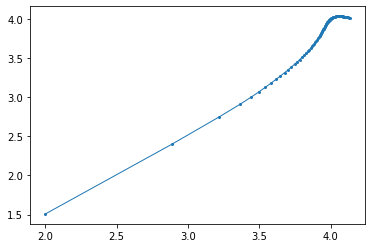

A_m is not valid
Simulation took:  0:00:29.377289
Simulation started at:  2020-04-28 08:39:45.328466
a:  0.035 delta_u 0.02 delta_nu 0.015


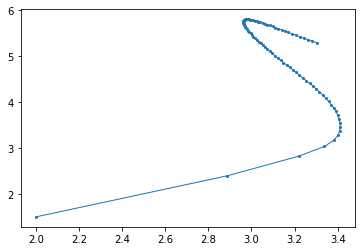

A_m is not valid
Simulation took:  0:00:28.751795
Simulation started at:  2020-04-28 08:40:14.098480
a:  0.075 delta_u 0.02 delta_nu 0.015


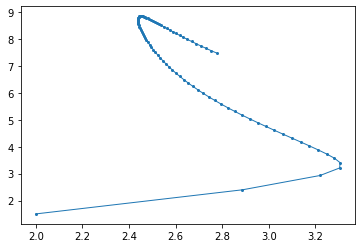

A_m is not valid
Simulation took:  0:00:31.411810
Simulation started at:  2020-04-28 08:40:45.559007
a:  0.1 delta_u 0.02 delta_nu 0.015


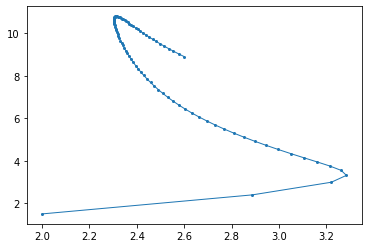

A_m is not valid
Simulation took:  0:00:29.932293
Simulation started at:  2020-04-28 08:41:15.516668
a:  0.005 delta_u 0.02 delta_nu 0.025


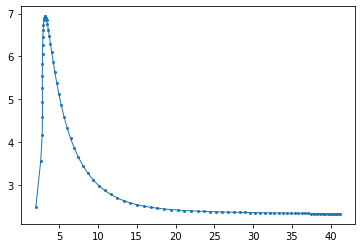

A_m is not valid
Simulation took:  0:00:29.616154
Simulation started at:  2020-04-28 08:41:45.180370
a:  0.035 delta_u 0.02 delta_nu 0.025


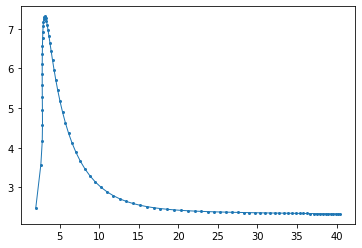

A_m is not valid
Simulation took:  0:00:28.266018
Simulation started at:  2020-04-28 08:42:13.463688
a:  0.075 delta_u 0.02 delta_nu 0.025


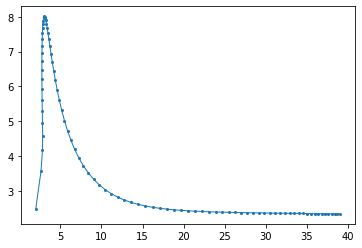

A_m is not valid
Simulation took:  0:00:26.966171
Simulation started at:  2020-04-28 08:42:40.445513
a:  0.1 delta_u 0.02 delta_nu 0.025


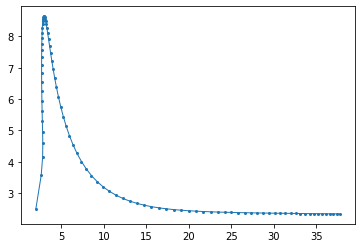

A_m is not valid
Simulation took:  0:00:25.297541
Simulation started at:  2020-04-28 08:43:05.790374
a:  0.005 delta_u 0.02 delta_nu 0.025


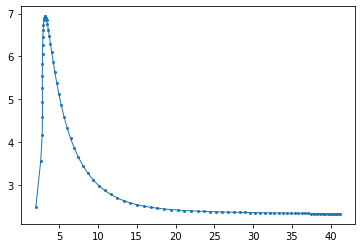

A_m is not valid
Simulation took:  0:00:34.616195
Simulation started at:  2020-04-28 08:43:40.551324
a:  0.035 delta_u 0.02 delta_nu 0.025


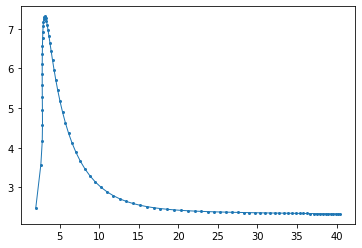

A_m is not valid
Simulation took:  0:00:30.871361
Simulation started at:  2020-04-28 08:44:11.436992
a:  0.075 delta_u 0.02 delta_nu 0.025


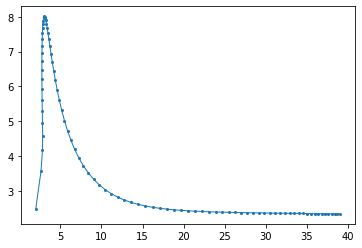

A_m is not valid
Simulation took:  0:00:29.112052
Simulation started at:  2020-04-28 08:44:40.572392
a:  0.1 delta_u 0.02 delta_nu 0.025


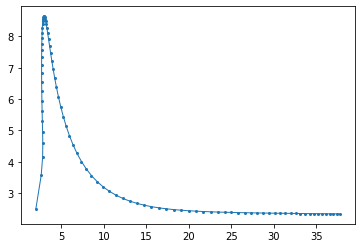

A_m is not valid
Simulation took:  0:00:30.649666
Simulation started at:  2020-04-28 08:45:11.253067
a:  0.005 delta_u 0.02 delta_nu 0.025


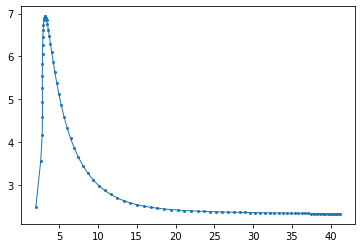

A_m is not valid
Simulation took:  0:00:29.027081
Simulation started at:  2020-04-28 08:45:40.296203
a:  0.035 delta_u 0.02 delta_nu 0.025


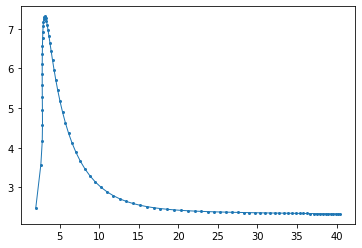

A_m is not valid
Simulation took:  0:00:28.583882
Simulation started at:  2020-04-28 08:46:08.925641
a:  0.075 delta_u 0.02 delta_nu 0.025


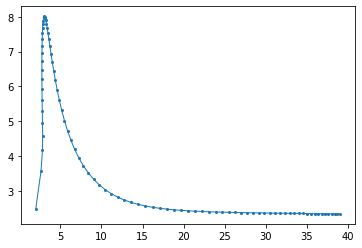

A_m is not valid
Simulation took:  0:00:27.255769
Simulation started at:  2020-04-28 08:46:36.211057
a:  0.1 delta_u 0.02 delta_nu 0.025


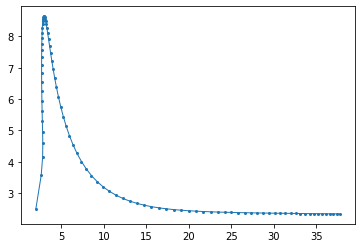

A_m is not valid
Simulation took:  0:00:26.562206
Simulation started at:  2020-04-28 08:47:02.796362
a:  0.005 delta_u 0.02 delta_nu 0.025


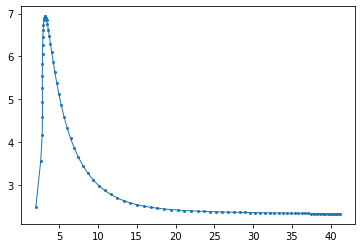

A_m is not valid
Simulation took:  0:00:28.811683
Simulation started at:  2020-04-28 08:47:31.630923
a:  0.035 delta_u 0.02 delta_nu 0.025


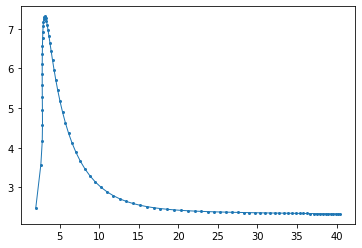

A_m is not valid
Simulation took:  0:00:29.769062
Simulation started at:  2020-04-28 08:48:01.459201
a:  0.075 delta_u 0.02 delta_nu 0.025


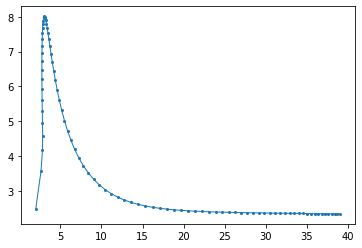

A_m is not valid
Simulation took:  0:00:31.827786
Simulation started at:  2020-04-28 08:48:33.345987
a:  0.1 delta_u 0.02 delta_nu 0.025


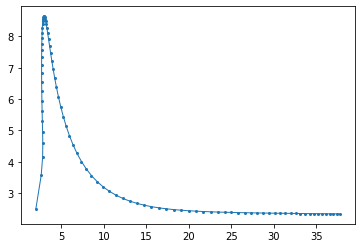

A_m is not valid
Simulation took:  0:00:26.364392
Simulation started at:  2020-04-28 08:48:59.723703
a:  0.005 delta_u 0.05 delta_nu 0.005


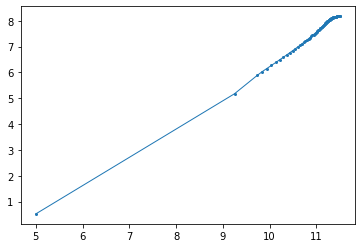

A_m is not valid
Simulation took:  0:00:24.026472
Simulation started at:  2020-04-28 08:49:23.766413
a:  0.035 delta_u 0.05 delta_nu 0.005


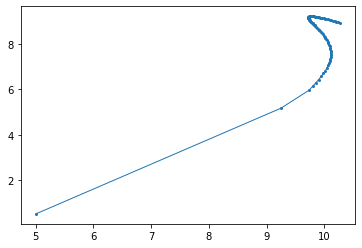

A_m is not valid
Simulation took:  0:00:22.970074
Simulation started at:  2020-04-28 08:49:46.753878
a:  0.075 delta_u 0.05 delta_nu 0.005


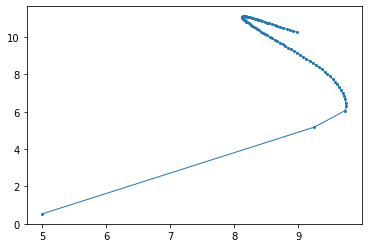

A_m is not valid
Simulation took:  0:00:23.037533
Simulation started at:  2020-04-28 08:50:09.809092
a:  0.1 delta_u 0.05 delta_nu 0.005


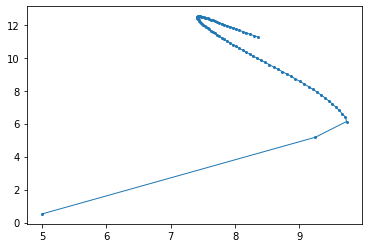

A_m is not valid
Simulation took:  0:00:22.880771
Simulation started at:  2020-04-28 08:50:32.714485
a:  0.005 delta_u 0.05 delta_nu 0.005


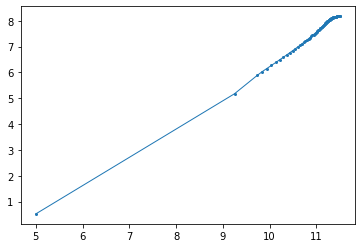

A_m is not valid
Simulation took:  0:00:22.325358
Simulation started at:  2020-04-28 08:50:55.052442
a:  0.035 delta_u 0.05 delta_nu 0.005


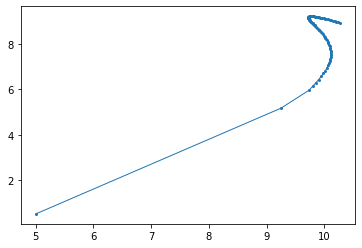

A_m is not valid
Simulation took:  0:00:26.327607
Simulation started at:  2020-04-28 08:51:21.404131
a:  0.075 delta_u 0.05 delta_nu 0.005


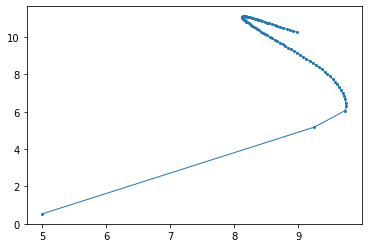

A_m is not valid
Simulation took:  0:00:30.079105
Simulation started at:  2020-04-28 08:51:51.528128
a:  0.1 delta_u 0.05 delta_nu 0.005


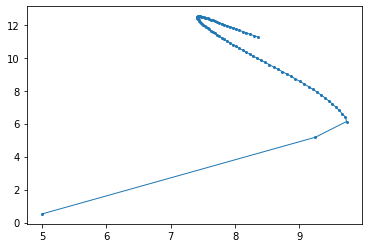

A_m is not valid
Simulation took:  0:00:29.380826
Simulation started at:  2020-04-28 08:52:20.928487
a:  0.005 delta_u 0.05 delta_nu 0.005


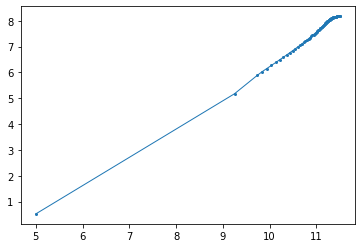

A_m is not valid
Simulation took:  0:00:26.755970
Simulation started at:  2020-04-28 08:52:47.704735
a:  0.035 delta_u 0.05 delta_nu 0.005


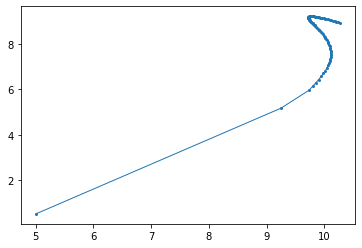

A_m is not valid
Simulation took:  0:00:29.198113
Simulation started at:  2020-04-28 08:53:16.922090
a:  0.075 delta_u 0.05 delta_nu 0.005


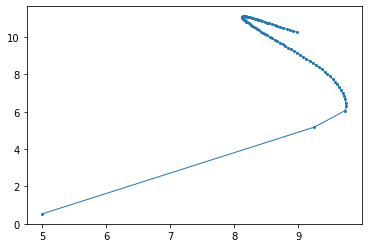

A_m is not valid
Simulation took:  0:00:28.724976
Simulation started at:  2020-04-28 08:53:45.681837
a:  0.1 delta_u 0.05 delta_nu 0.005


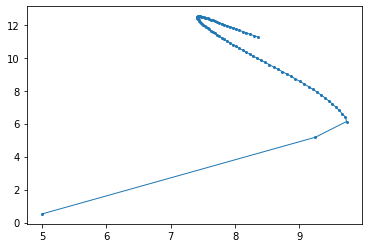

A_m is not valid
Simulation took:  0:00:32.799286
Simulation started at:  2020-04-28 08:54:18.499749
a:  0.005 delta_u 0.05 delta_nu 0.005


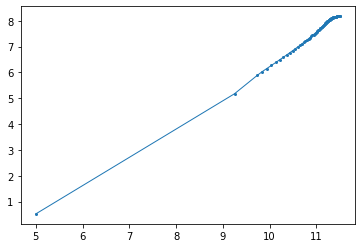

A_m is not valid
Simulation took:  0:00:30.245677
Simulation started at:  2020-04-28 08:54:48.788890
a:  0.035 delta_u 0.05 delta_nu 0.005


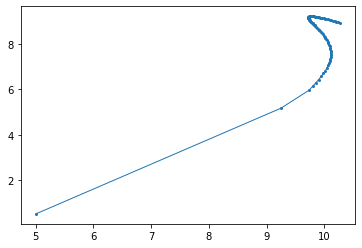

A_m is not valid
Simulation took:  0:00:26.963543
Simulation started at:  2020-04-28 08:55:15.767691
a:  0.075 delta_u 0.05 delta_nu 0.005


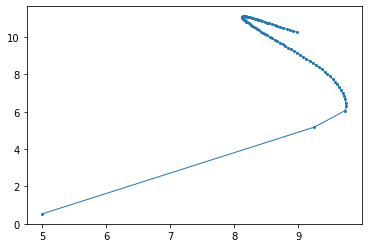

A_m is not valid
Simulation took:  0:00:26.441253
Simulation started at:  2020-04-28 08:55:42.226194
a:  0.1 delta_u 0.05 delta_nu 0.005


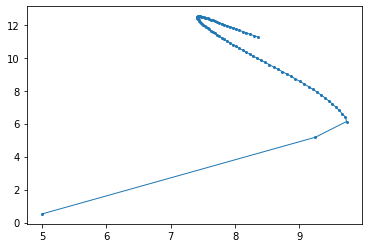

A_m is not valid
Simulation took:  0:00:24.562300
Simulation started at:  2020-04-28 08:56:06.802452
a:  0.005 delta_u 0.05 delta_nu 0.015


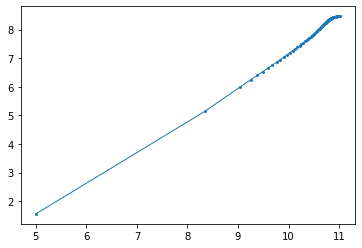

A_m is not valid
Simulation took:  0:00:22.481668
Simulation started at:  2020-04-28 08:56:29.297803
a:  0.035 delta_u 0.05 delta_nu 0.015


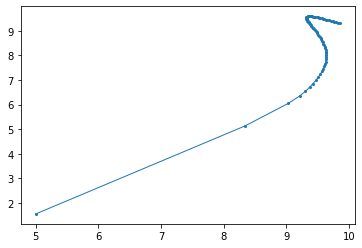

A_m is not valid
Simulation took:  0:00:21.997698
Simulation started at:  2020-04-28 08:56:51.310383
a:  0.075 delta_u 0.05 delta_nu 0.015


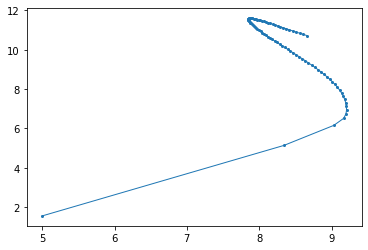

A_m is not valid
Simulation took:  0:00:22.206662
Simulation started at:  2020-04-28 08:57:13.530912
a:  0.1 delta_u 0.05 delta_nu 0.015


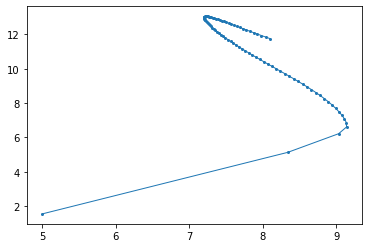

A_m is not valid
Simulation took:  0:00:21.893749
Simulation started at:  2020-04-28 08:57:35.437965
a:  0.005 delta_u 0.05 delta_nu 0.015


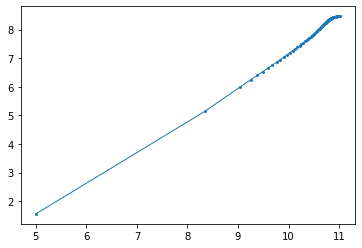

A_m is not valid
Simulation took:  0:00:21.986534
Simulation started at:  2020-04-28 08:57:57.437307
a:  0.035 delta_u 0.05 delta_nu 0.015


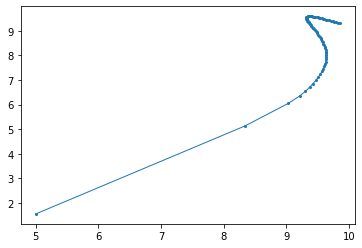

A_m is not valid
Simulation took:  0:00:22.994750
Simulation started at:  2020-04-28 08:58:20.445700
a:  0.075 delta_u 0.05 delta_nu 0.015


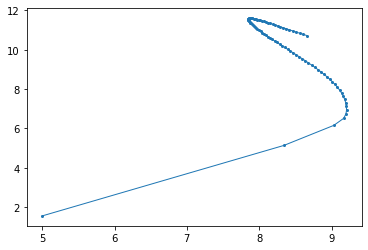

A_m is not valid
Simulation took:  0:00:22.182132
Simulation started at:  2020-04-28 08:58:42.641353
a:  0.1 delta_u 0.05 delta_nu 0.015


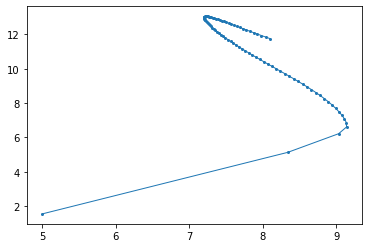

A_m is not valid
Simulation took:  0:00:21.818150
Simulation started at:  2020-04-28 08:59:04.473188
a:  0.005 delta_u 0.05 delta_nu 0.015


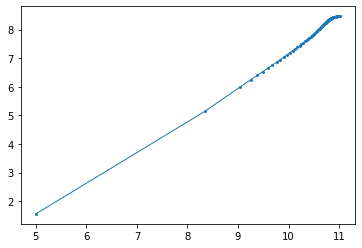

A_m is not valid
Simulation took:  0:00:22.009625
Simulation started at:  2020-04-28 08:59:26.496383
a:  0.035 delta_u 0.05 delta_nu 0.015


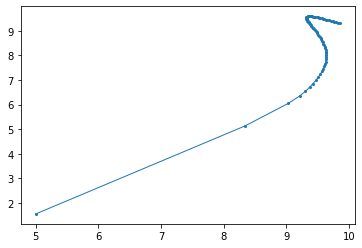

A_m is not valid
Simulation took:  0:00:22.261307
Simulation started at:  2020-04-28 08:59:48.773059
a:  0.075 delta_u 0.05 delta_nu 0.015


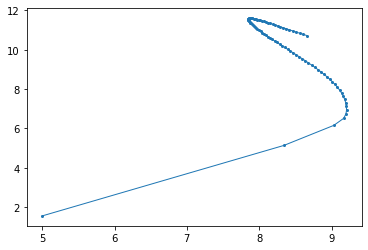

A_m is not valid
Simulation took:  0:00:22.149275
Simulation started at:  2020-04-28 09:00:10.935885
a:  0.1 delta_u 0.05 delta_nu 0.015


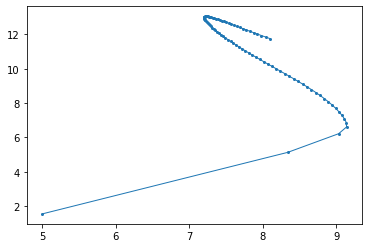

A_m is not valid
Simulation took:  0:00:28.054771
Simulation started at:  2020-04-28 09:00:39.030075
a:  0.005 delta_u 0.05 delta_nu 0.015


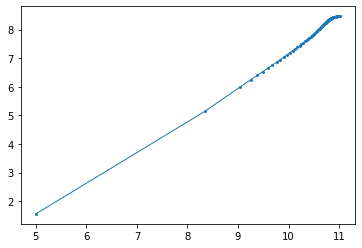

A_m is not valid
Simulation took:  0:00:31.804107
Simulation started at:  2020-04-28 09:01:10.850617
a:  0.035 delta_u 0.05 delta_nu 0.015


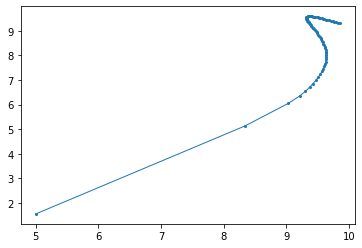

A_m is not valid
Simulation took:  0:00:26.878878
Simulation started at:  2020-04-28 09:01:37.802757
a:  0.075 delta_u 0.05 delta_nu 0.015


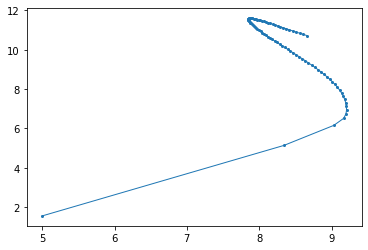

A_m is not valid
Simulation took:  0:00:28.584842
Simulation started at:  2020-04-28 09:02:06.405932
a:  0.1 delta_u 0.05 delta_nu 0.015


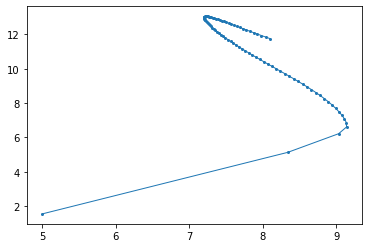

A_m is not valid
Simulation took:  0:00:28.711753
Simulation started at:  2020-04-28 09:02:35.134567
a:  0.005 delta_u 0.05 delta_nu 0.025


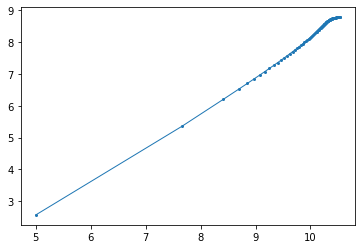

A_m is not valid
Simulation took:  0:00:28.091959
Simulation started at:  2020-04-28 09:03:03.246595
a:  0.035 delta_u 0.05 delta_nu 0.025


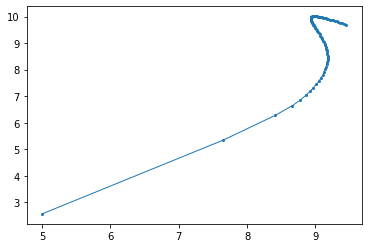

A_m is not valid
Simulation took:  0:00:31.588752
Simulation started at:  2020-04-28 09:03:34.862815
a:  0.075 delta_u 0.05 delta_nu 0.025


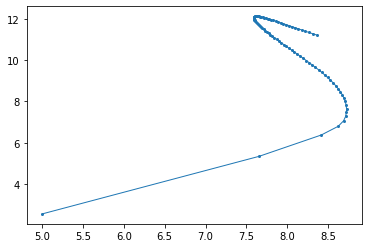

A_m is not valid
Simulation took:  0:00:27.867324
Simulation started at:  2020-04-28 09:04:02.744748
a:  0.1 delta_u 0.05 delta_nu 0.025


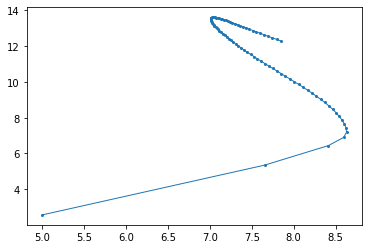

A_m is not valid
Simulation took:  0:00:27.108415
Simulation started at:  2020-04-28 09:04:29.867883
a:  0.005 delta_u 0.05 delta_nu 0.025


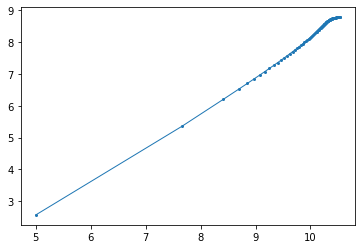

A_m is not valid
Simulation took:  0:00:27.957032
Simulation started at:  2020-04-28 09:04:57.842405
a:  0.035 delta_u 0.05 delta_nu 0.025


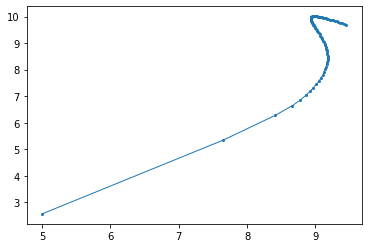

A_m is not valid
Simulation took:  0:00:29.625275
Simulation started at:  2020-04-28 09:05:27.497583
a:  0.075 delta_u 0.05 delta_nu 0.025


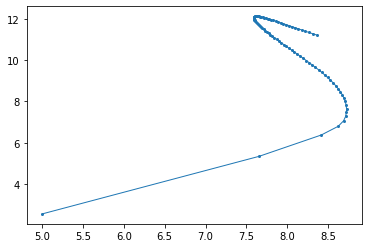

A_m is not valid
Simulation took:  0:00:28.235545
Simulation started at:  2020-04-28 09:05:55.749638
a:  0.1 delta_u 0.05 delta_nu 0.025


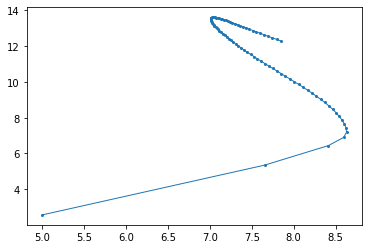

A_m is not valid
Simulation took:  0:00:31.580495
Simulation started at:  2020-04-28 09:06:27.360325
a:  0.005 delta_u 0.05 delta_nu 0.025


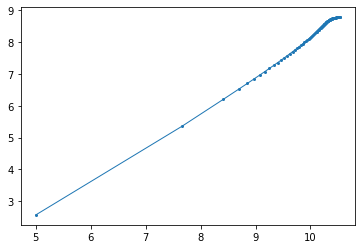

A_m is not valid
Simulation took:  0:00:29.874063
Simulation started at:  2020-04-28 09:06:57.262833
a:  0.035 delta_u 0.05 delta_nu 0.025


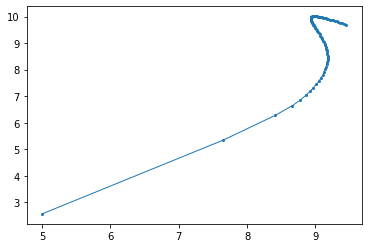

A_m is not valid
Simulation took:  0:00:31.119602
Simulation started at:  2020-04-28 09:07:28.403297
a:  0.075 delta_u 0.05 delta_nu 0.025


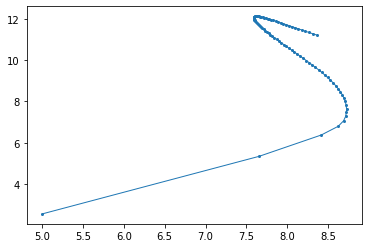

A_m is not valid
Simulation took:  0:00:31.407082
Simulation started at:  2020-04-28 09:07:59.826253
a:  0.1 delta_u 0.05 delta_nu 0.025


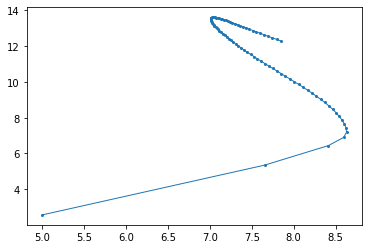

A_m is not valid
Simulation took:  0:00:27.705946
Simulation started at:  2020-04-28 09:08:27.551790
a:  0.005 delta_u 0.05 delta_nu 0.025


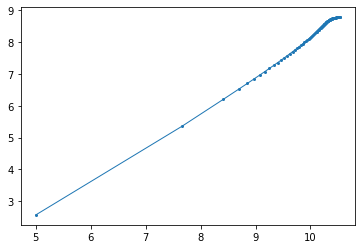

A_m is not valid
Simulation took:  0:00:30.261264
Simulation started at:  2020-04-28 09:08:57.830782
a:  0.035 delta_u 0.05 delta_nu 0.025


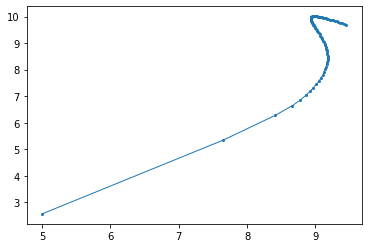

A_m is not valid
Simulation took:  0:00:26.119073
Simulation started at:  2020-04-28 09:09:23.998230
a:  0.075 delta_u 0.05 delta_nu 0.025


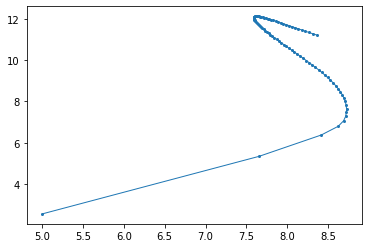

A_m is not valid
Simulation took:  0:00:33.203059
Simulation started at:  2020-04-28 09:09:57.217462
a:  0.1 delta_u 0.05 delta_nu 0.025


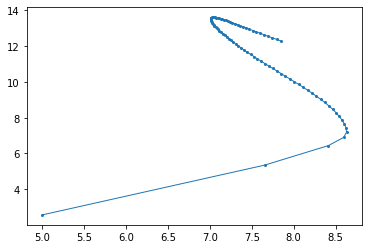

A_m is not valid
Simulation took:  0:00:26.917167
Simulation started at:  2020-04-28 09:10:24.152875
a:  0.005 delta_u 0.006 delta_nu 0.005


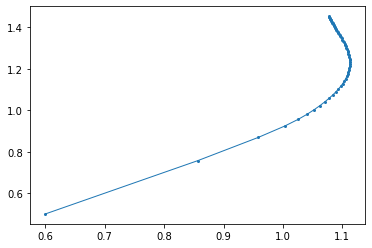

UnboundLocalError: local variable 'cost' referenced before assignment

In [57]:


# Calibration data structure
parameters = {}

# Visual inspection of Beveridge curve gives following period
parameters['years'] = 6
parameters['T'] = 6

# Parameters to be calibrated
parameters['a'] = [0.005, 0.035, 0.075, 0.1]
parameters['delta_u'] = [0.006, 0.02, 0.05]
parameters['delta_nu'] = [0.005, 0.015, 0.025]
parameters['gamma_u'] = [0.05, 0.1, 0.15, 0.2]
parameters['timestep'] = [2, 4, 6, 8]

# parameters['gamma_ny'] = gamma_u

# Calibration data
start = 18
end = 59
empirical_data = sa_calibration_data.iloc[start:end]

# Shock parameters (not there yet)
parameters['t_0'] = years
parameters['k'] = 1
parameters['L'] = 1
parameters['avg_hours_0'] = 1
parameters['shock_start'] = 1

# output variable
calibration_output = True

# Loop should give result = {dict with parameters:dict with outputs}
results = []

for timestep in parameters['timestep']:
    for delta_u in parameters['delta_u']:
        for delta_nu in parameters['delta_nu']:
            for gamma in parameters['gamma_u']:
                for a in parameters['a']: 
                    employment = employment_SSYK[['SSYK', '2014']]
                    employment = {str(employment['SSYK'].iloc[i]):employment['2014'].iloc[i] for i in range(len(employment))}
                    node_names = list(G.nodes())

                    # setup network
                    employed = {str(name):e for name,e in employment.items() if str(name) in node_names}
                    unemployed = {name:0 for name in node_names}
                    vacancies = {name:0 for name in node_names}
                    applications = {name:[] for name in node_names}
                    target_demand = {str(name):e for name,e in employment.items() if str(name) in node_names}
                    of_data = SSYK_shock.groupby(by = ['ssyk3'], axis = 0).mean()
                    of_data = of_data.to_dict()['Computerisation Probability']



                    attributes = {'employed':employed, 'unemployed':unemployed, 'vacancies':vacancies, 'applications':applications,
                    'target_demand':target_demand, 'comp_prob':of_data}
                    out_parameters = {'a':a, 'delta_u':delta_u, 'delta_nu':delta_nu, 'gamma_u':gamma_u, 'timestep':timestep}

                    output = deterministic_simulation(G, years, timestep, delta_u, gamma_u, delta_nu, gamma_ny, empirical_data, t_0, k, L,                                avg_hours_0, a, T, shock_start, attributes, calibration_output)
                    results.append({'parameters':out_parameters, 'output':output})



In [63]:
pd.DataFrame.from_dict([dict['parameters'] for dict in results])

,a,delta_u,delta_nu,gamma_u,timestep
0,0.005,0.006,0.005,0.05,2
1,0.035,0.006,0.005,0.05,2
2,0.075,0.006,0.005,0.05,2
3,0.100,0.006,0.005,0.05,2
4,0.005,0.006,0.005,0.05,2
...,...,...,...,...,...
427,0.100,0.050,0.025,0.05,6
428,0.005,0.050,0.025,0.05,6
429,0.035,0.050,0.025,0.05,6
430,0.075,0.050,0.025,0.05,6


# Model Visualisation section
When the model is calibrated and results are ready these need to be visualised in the following cells

In [ ]:
# Result visualisation here